# Loading Data from Kaggle

In [ ]:

# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES
# TO THE CORRECT LOCATION (/kaggle/input) IN YOUR NOTEBOOK,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.

import os
import sys
from tempfile import NamedTemporaryFile
from urllib.request import urlopen
from urllib.parse import unquote, urlparse
from urllib.error import HTTPError
from zipfile import ZipFile
import tarfile
import shutil

CHUNK_SIZE = 40960
DATA_SOURCE_MAPPING = 'geolifeclef-2024:https%3A%2F%2Fstorage.googleapis.com%2Fkaggle-competitions-data%2Fkaggle-v2%2F64733%2F8171035%2Fbundle%2Farchive.zip%3FX-Goog-Algorithm%3DGOOG4-RSA-SHA256%26X-Goog-Credential%3Dgcp-kaggle-com%2540kaggle-161607.iam.gserviceaccount.com%252F20240622%252Fauto%252Fstorage%252Fgoog4_request%26X-Goog-Date%3D20240622T180341Z%26X-Goog-Expires%3D259200%26X-Goog-SignedHeaders%3Dhost%26X-Goog-Signature%3D218938f43eed9abcfc67d319863c382c8e14f565de111ea13ebb57465b2252e8af204f83a47e320204e37198f5a2c9a73019260db377942a08f77ca364edf2f84d68b71752527fb1dd2744233fbd267b61c372b909320a6e71f92f785b6f40f8329cb154163a1ff4d623a0de6071ec073ce1e8861ffdc9078e206142923e746df0b7c5f8ce81145a518efd563bef7fe8f1165ed305cbbe796f4c5ec245d43507d8769afcacd2c19628fe4bf3ac9e33cecc3da9b78027899da99c32f144e12cc838512772eeb9b4ba016d22daecb1dca66904f7995f90a66c43cab53914e7f12723bb66b62b74f4543df81ad11c906f5234667d56dd3de6994de0c3a18a76abd0'

KAGGLE_INPUT_PATH='/kaggle/input'
KAGGLE_WORKING_PATH='/kaggle/working'
KAGGLE_SYMLINK='kaggle'

!umount /kaggle/input/ 2> /dev/null
shutil.rmtree('/kaggle/input', ignore_errors=True)
os.makedirs(KAGGLE_INPUT_PATH, 0o777, exist_ok=True)
os.makedirs(KAGGLE_WORKING_PATH, 0o777, exist_ok=True)

try:
  os.symlink(KAGGLE_INPUT_PATH, os.path.join("..", 'input'), target_is_directory=True)
except FileExistsError:
  pass
try:
  os.symlink(KAGGLE_WORKING_PATH, os.path.join("..", 'working'), target_is_directory=True)
except FileExistsError:
  pass

for data_source_mapping in DATA_SOURCE_MAPPING.split(','):
    directory, download_url_encoded = data_source_mapping.split(':')
    download_url = unquote(download_url_encoded)
    filename = urlparse(download_url).path
    destination_path = os.path.join(KAGGLE_INPUT_PATH, directory)
    try:
        with urlopen(download_url) as fileres, NamedTemporaryFile() as tfile:
            total_length = fileres.headers['content-length']
            print(f'Downloading {directory}, {total_length} bytes compressed')
            dl = 0
            data = fileres.read(CHUNK_SIZE)
            while len(data) > 0:
                dl += len(data)
                tfile.write(data)
                done = int(50 * dl / int(total_length))
                sys.stdout.write(f"\r[{'=' * done}{' ' * (50-done)}] {dl} bytes downloaded")
                sys.stdout.flush()
                data = fileres.read(CHUNK_SIZE)
            if filename.endswith('.zip'):
              with ZipFile(tfile) as zfile:
                zfile.extractall(destination_path)
            else:
              with tarfile.open(tfile.name) as tarfile:
                tarfile.extractall(destination_path)
            print(f'\nDownloaded and uncompressed: {directory}')
    except HTTPError as e:
        print(f'Failed to load (likely expired) {download_url} to path {destination_path}')
        continue
    except OSError as e:
        print(f'Failed to load {download_url} to path {destination_path}')
        continue

print('Data source import complete.')


[==================================================] 1506816723 bytes downloaded
Downloaded and uncompressed: geolifeclef-2024
Data source import complete.


In [ ]:
import os
import torch
from tqdm import tqdm
from copy import deepcopy
import numpy as np
import pandas as pd
import torchvision.models as models
import torchvision.transforms as transforms
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, random_split
from torch.optim.lr_scheduler import CosineAnnealingLR
from sklearn.metrics import precision_recall_fscore_support
from torch.distributions.beta import Beta
from PIL import Image
import torch
from geopy.distance import geodesic
from sklearn.neighbors import NearestNeighbors
import math
from sklearn.neighbors import BallTree
import numpy as np
import networkx as nx
from multiprocessing import Pool, cpu_count
# import tslib
# help(tslib)
DEBUG = False
num_classes = 11255 # Number of all unique classes within the PO and PA data.
seed = 151
batch_size = 128

In [ ]:
!pip install timm
import timm

# Rebuild dataset for PA and P0(No need to run when you already have a graph file)

In [ ]:
### 第一件事生成整理后的Train data并进行独热编码
train_data = pd.read_csv("/kaggle/input/geolifeclef-2024/GLC24_PA_metadata_train.csv")
print(train_data['speciesId'].nunique())
list_a=train_data['speciesId'].unique()
train_data = train_data.dropna(subset="speciesId").reset_index(drop=True)
train_data['speciesId'] = train_data['speciesId'].astype(int)
label_dict = train_data.groupby('surveyId')['speciesId'].apply(list).to_dict()
train_data = train_data.drop_duplicates(subset="surveyId").reset_index(drop=True)

# 将label_dict转换为DataFrame以便合并
label_df = pd.DataFrame(list(label_dict.items()), columns=['surveyId', 'speciesIds'])

# 合并label_df到train_data中
train_data_A = train_data.merge(label_df, on='surveyId', how='left')
train_data_A.to_csv('train_data.csv')
# 假设max_species_id是已知的最大speciesId
max_species_id = 11255  # 或者可以使用 train_data_A['speciesId'].max()

# 初始化独热编码数组
one_hot_encoded = np.zeros((len(train_data_A), max_species_id), dtype=int)

# 为每个speciesId创建独热编码
for index, row in train_data_A.iterrows():
    # 这里假设speciesId从1开始
    species_id = int(row['speciesId']) - 1  # 减1是因为数组索引从0开始
    one_hot_encoded[index, species_id] = 1
print(one_hot_encoded.shape)

5016
(88987, 11255)


In [ ]:
train_data = pd.read_csv("/kaggle/input/geolifeclef-2024/GLC24_P0_metadata_train.csv")
print(train_data['speciesId'].nunique())
list_b=train_data['speciesId'].unique()
train_data = train_data.dropna(subset="speciesId").reset_index(drop=True)
train_data['speciesId'] = train_data['speciesId'].astype(int)
label_dict = train_data.groupby('surveyId')['speciesId'].apply(list).to_dict()
train_data = train_data.drop_duplicates(subset="surveyId").reset_index(drop=True)

# 将label_dict转换为DataFrame以便合并
label_df = pd.DataFrame(list(label_dict.items()), columns=['surveyId', 'speciesIds'])

# 合并label_df到train_data中
train_data_O = train_data.merge(label_df, on='surveyId', how='left')
train_data_O.to_csv('train_data_P0.csv')


9709


In [ ]:
test_data = pd.read_csv("/kaggle/input/geolifeclef-2024/GLC24_PA_metadata_test.csv")
set_a = set(list_a)

# 找出list_b中没有出现在list_a中的元素
difference = [item for item in list_b if item not in set_a]

print(difference)  # 输出: [6, 7, 8]
print(len(difference))

[10748.0, 1567.0, 685.0, 7096.0, 2664.0, 5318.0, 6180.0, 3418.0, 2266.0, 3468.0, 4658.0, 3003.0, 9721.0, 5866.0, 8620.0, 7511.0, 622.0, 4371.0, 8837.0, 5278.0, 4193.0, 7747.0, 6525.0, 1356.0, 3520.0, 6346.0, 10353.0, 7010.0, 2271.0, 678.0, 5423.0, 1942.0, 8788.0, 8334.0, 10821.0, 11199.0, 4717.0, 7128.0, 8480.0, 3638.0, 3194.0, 5691.0, 2791.0, 8648.0, 152.0, 1296.0, 11205.0, 10226.0, 4568.0, 2841.0, 10130.0, 9448.0, 8288.0, 1415.0, 8356.0, 9585.0, 5666.0, 111.0, 10096.0, 2240.0, 5211.0, 4001.0, 3185.0, 4257.0, 4792.0, 4071.0, 3435.0, 2853.0, 3461.0, 4514.0, 8100.0, 6785.0, 5344.0, 5080.0, 2045.0, 8456.0, 2155.0, 10272.0, 1796.0, 9976.0, 6605.0, 8080.0, 8874.0, 27.0, 3543.0, 3854.0, 6013.0, 501.0, 3943.0, 8876.0, 407.0, 7301.0, 7200.0, 3796.0, 4400.0, 4787.0, 2204.0, 8928.0, 3072.0, 2320.0, 4780.0, 9756.0, 2612.0, 1577.0, 5273.0, 2782.0, 10808.0, 5579.0, 8131.0, 9441.0, 2681.0, 6081.0, 438.0, 6447.0, 572.0, 1021.0, 7582.0, 1994.0, 168.0, 46.0, 7159.0, 3061.0, 8676.0, 9919.0, 5988.0, 229

# Load metadata and clean other csv

In [ ]:
train_metadata_path = "/kaggle/input/geolifeclef-2024/GLC24_PA_metadata_train.csv"
train_metadata = pd.read_csv(train_metadata_path)
train_feature=train_metadata.drop_duplicates(subset="surveyId").reset_index(drop=True)
train_feature=train_feature.fillna(0).replace(np.inf, 0).replace(-np.inf, 0)
test_metadata_path = "/kaggle/input/geolifeclef-2024/GLC24_PA_metadata_test.csv"
test_metadata = pd.read_csv(test_metadata_path)
test_feature=test_metadata.fillna(-1).replace(np.inf, -1).replace(-np.inf, -1)
train_feature=train_feature.drop(columns=["speciesId"])
# print(train_feature)
# print(test_feature)

# 选择需要进行独热编码的两列
columns_to_encode = ['region', 'country']
from sklearn.preprocessing import OneHotEncoder
# 创建 OneHotEncoder 对象
encoder = OneHotEncoder(sparse=False)
encoder.fit(train_feature[columns_to_encode])

# 对 train_feature 进行独热编码
encoded_train_columns = encoder.transform(train_feature[columns_to_encode])
encoded_train_col_names = encoder.get_feature_names_out(columns_to_encode)
encoded_train_df = pd.DataFrame(encoded_train_columns, columns=encoded_train_col_names)
train_feature_encoded = pd.concat([train_feature.drop(columns_to_encode, axis=1), encoded_train_df], axis=1)


train_feature_encoded.to_csv(r'train_feature_encoded.csv', index = False)
# 对 test_feature 进行相同的独热编码
encoded_test_columns = encoder.transform(test_feature[columns_to_encode])
encoded_test_col_names = encoder.get_feature_names_out(columns_to_encode)
encoded_test_df = pd.DataFrame(encoded_test_columns, columns=encoded_test_col_names)
test_feature_encoded = pd.concat([test_feature.drop(columns_to_encode, axis=1), encoded_test_df], axis=1)

print("Encoded test_feature:")
print(test_feature_encoded)
print("Encoded train_feature:")
print(train_feature_encoded)

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:868: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


Encoded test_feature:
            lon       lat  year  geoUncertaintyInM  areaInM2  surveyId  \
0     10.033550  57.12081  2019               10.0     707.0       642   
1      7.333000  46.22997  2019               -1.0      10.0      1792   
2      1.843658  42.58006  2018                0.0      -1.0      3256   
3     11.720090  46.26149  2021               10.0      35.0      3855   
4      9.361870  55.90245  2017               10.0      79.0      4889   
...         ...       ...   ...                ...       ...       ...   
4711   5.874027  51.41978  2018                3.0       9.0   3915838   
4712   4.147443  52.01209  2017                3.0      -1.0   3916502   
4713  16.029480  48.05149  2017                0.0     400.0   3917793   
4714  12.400560  56.09469  2018               10.0      79.0   3918865   
4715  16.034830  47.90403  2017                0.0     400.0   3919234   

      region_ALPINE  region_ATLANTIC  region_BLACK SEA  region_BOREAL  ...  \
0          

In [ ]:
def replace_greater_than_255(x):
    return min(x, 255)
def replace_less_than_0(x):
    return max(x, 0)
exclude_column = 'surveyId'
train_landcover = pd.read_csv("/kaggle/input/geolifeclef-2024/EnvironmentalRasters/EnvironmentalRasters/LandCover/GLC24-PA-train-landcover.csv")
train_solidgrids = pd.read_csv("/kaggle/input/geolifeclef-2024/EnvironmentalRasters/EnvironmentalRasters/SoilGrids/GLC24-PA-train-soilgrids.csv")
df= pd.read_csv("/kaggle/input/geolifeclef-2024/EnvironmentalRasters/EnvironmentalRasters/Human Footprint/GLC24-PA-train-human_footprint.csv")
df.loc[:, df.columns != exclude_column] = df.loc[:, df.columns != exclude_column].applymap(replace_greater_than_255)
df.loc[:, df.columns != exclude_column] = df.loc[:, df.columns != exclude_column].applymap(replace_less_than_0)
train_humanfootprint = df
train_elevation = pd.read_csv("/kaggle/input/geolifeclef-2024/EnvironmentalRasters/EnvironmentalRasters/Elevation/GLC24-PA-train-elevation.csv")
train_climate = pd.read_csv("/kaggle/input/geolifeclef-2024/EnvironmentalRasters/EnvironmentalRasters/Climate/Average 1981-2010/GLC24-PA-train-bioclimatic.csv")

train_tab = train_climate.merge(train_elevation,on="surveyId").merge(train_humanfootprint,on="surveyId").merge(train_solidgrids,on="surveyId").merge(train_landcover,on="surveyId").merge(train_feature_encoded,on="surveyId")
#train_tab = train_climate.merge(train_elevation,on="surveyId").merge(train_humanfootprint,on="surveyId").merge(train_solidgrids,on="surveyId").merge(train_landcover,on="surveyId")
features = list(train_tab.columns)[1:]
train_tab = train_tab.replace(np.inf, np.nan).replace(-np.inf, np.nan)
train_tab = train_tab.apply(lambda col: col.fillna(col.mean()), axis=0)
print(train_tab)

test_landcover = pd.read_csv("/kaggle/input/geolifeclef-2024/EnvironmentalRasters/EnvironmentalRasters/LandCover/GLC24-PA-test-landcover.csv")
test_solidgrids = pd.read_csv("/kaggle/input/geolifeclef-2024/EnvironmentalRasters/EnvironmentalRasters/SoilGrids/GLC24-PA-test-soilgrids.csv")
df = pd.read_csv("/kaggle/input/geolifeclef-2024/EnvironmentalRasters/EnvironmentalRasters/Human Footprint/GLC24-PA-test-human_footprint.csv")
df.loc[:, df.columns != exclude_column] = df.loc[:, df.columns != exclude_column].applymap(replace_greater_than_255)
df.loc[:, df.columns != exclude_column] = df.loc[:, df.columns != exclude_column].applymap(replace_less_than_0)
test_humanfootprint = df
test_elevation = pd.read_csv("/kaggle/input/geolifeclef-2024/EnvironmentalRasters/EnvironmentalRasters/Elevation/GLC24-PA-test-elevation.csv")
test_climate = pd.read_csv("/kaggle/input/geolifeclef-2024/EnvironmentalRasters/EnvironmentalRasters/Climate/Average 1981-2010/GLC24-PA-test-bioclimatic.csv")

test_tab = test_climate.merge(test_elevation,on="surveyId").merge(test_humanfootprint,on="surveyId").merge(test_solidgrids,on="surveyId").merge(test_landcover,on="surveyId").merge(test_feature_encoded,on="surveyId")
#test_tab = test_climate.merge(test_elevation,on="surveyId").merge(test_humanfootprint,on="surveyId").merge(test_solidgrids,on="surveyId").merge(test_landcover,on="surveyId")
test_tab = test_tab.replace(np.inf, np.nan).replace(-np.inf, np.nan)
test_tab = test_tab.apply(lambda col: col.fillna(col.mean()), axis=0)
print(test_tab)

train_tab.to_csv(r'train_tab.csv', index = False)
test_tab.to_csv(r'test_tab.csv', index = False)

       surveyId  Bio1  Bio2  Bio3  Bio4  Bio5  Bio6  Bio7  Bio8  Bio9  ...  \
0           212  2883    68     3  5545  3007  2780   227  2854  2958  ...   
1           222  2815    59     2  5690  2935  2720   215  2860  2768  ...   
2           243  2821    26     1  5150  2910  2741   169  2838  2832  ...   
3           324  2870    90     3  5315  2992  2756   236  2810  2938  ...   
4           333  2858    81     3  5285  2982  2758   224  2827  2927  ...   
...         ...   ...   ...   ...   ...   ...   ...   ...   ...   ...  ...   
88982   3919553  2817    30     1  5398  2913  2734   179  2864  2767  ...   
88983   3919592  2812    19     1  5540  2909  2734   175  2833  2781  ...   
88984   3919620  2815    59     2  5564  2931  2722   209  2860  2803  ...   
88985   3919640  2808    66     2  6775  2945  2693   252  2895  2759  ...   
88986   3919655  2812    57     2  5649  2931  2719   212  2857  2765  ...   

       country_Norway  country_Poland  country_Portugal  countr

In [ ]:
train_df = train_tab
val_df = test_tab
from sklearn.preprocessing import StandardScaler
# 分离需要标准化的列和不需要标准化的列
train_to_standardize = train_df.drop(columns=[exclude_column])
train_not_standardize = train_df[[exclude_column]]

val_to_standardize = val_df.drop(columns=[exclude_column])
val_not_standardize = val_df[[exclude_column]]

# 创建一个 StandardScaler 对象
scaler = StandardScaler()

# 用训练集数据计算均值和标准差，并标准化训练集的数值列
train_standardized = pd.DataFrame(scaler.fit_transform(train_to_standardize), columns=train_to_standardize.columns)

# 使用训练集的均值和标准差来标准化验证集的数值列
val_standardized = pd.DataFrame(scaler.transform(val_to_standardize), columns=val_to_standardize.columns)

# 合并数值列和非数值列
train_tab = pd.concat([train_not_standardize, train_standardized], axis=1)
test_tab = pd.concat([val_not_standardize, val_standardized], axis=1)

# Graph Build and Feature Extract

## Build and save

In [ ]:
# import numpy as np
# import pandas as pd
# import networkx as nx
# from sklearn.neighbors import BallTree
# from sklearn.preprocessing import OneHotEncoder
# species_encoded=one_hot_encoded
# # 将经纬度从度转换为弧度，用于距离计算
# coords = np.radians(train_data_A[['lat', 'lon']].values)
# # 创建空间索引（BallTree）
# tree = BallTree(coords, metric='haversine')
# # 查询索引以找到10公里内的邻居
# radius = 10 / 6371  # 地球半径约为6371公里
# # 查找每个点半径内的索引和距离
# indices, distances = tree.query_radius(coords, r=radius, return_distance=True)
# # 创建一个图
# G = nx.Graph()
# # 添加节点和节点的特征
# for index, row in train_data_A.iterrows():
#     G.add_node(row['surveyId'],
#           features=np.zeros(species_encoded.shape[1]),
#           year=row['year'],IsTrain=True,
#           region=row['region'],
#           second_feature=train_tab[train_tab['surveyId'] == row['surveyId']].drop('surveyId', axis=1).to_numpy())

# # 基于距离权重添加边
# for i, (neighbors, dists) in enumerate(zip(indices, distances)):
#     # print(i)
#     current_id = train_data_A.iloc[i]['surveyId']
#     current_year = train_data_A.iloc[i]['year']
#     current_region = train_data_A.iloc[i]['region']
#     current_features = species_encoded[i]
#     G.nodes[current_id]['labels'] = current_features
#     # G.nodes[current_id]['features'] = np.zeros_like(current_features)
#     for neighbor_idx, dist in zip(neighbors, dists):
#         neighbor_id = train_data_A.iloc[neighbor_idx]['surveyId']
#         neighbor_year = train_data_A.iloc[neighbor_idx]['year']
#         neighbor_region = train_data_A.iloc[neighbor_idx]['region']
#         # 检查年份和生态圈
#         if neighbor_idx != i and current_year == neighbor_year and current_region == neighbor_region:
#             G.add_edge(current_id, neighbor_id)
#             # 更新节点的特征
#             weight=10-(dist*6371)
#             G.nodes[current_id]['features'] += species_encoded[neighbor_idx]*weight
#     G.nodes[current_id]['features']/math.sqrt(len(neighbors)+1)
# # 检查图中的节点和边的数量
# num_nodes = G.number_of_nodes()
# num_edges = G.number_of_edges()
# print(f"图中的节点数量为：{num_nodes}")
# print(f"图中的边数量为：{num_edges}")



图中的节点数量为：88987
图中的边数量为：6332182


In [ ]:
###加速版本
import numpy as np
import pandas as pd
import networkx as nx
from sklearn.neighbors import BallTree
from sklearn.preprocessing import OneHotEncoder
import math
from multiprocessing import Pool, cpu_count
G = nx.Graph()
species_encoded=one_hot_encoded
# 将经纬度从度转换为弧度，用于距离计算
coords = np.radians(train_data_A[['lat', 'lon']].values)

# 创建空间索引（BallTree）
tree = BallTree(coords, metric='haversine')

# 查询索引以找到10公里内的邻居
radius = 10 / 6371  # 地球半径约为6371公里
indices, distances = tree.query_radius(coords, r=radius, return_distance=True)

# 将 DataFrame 转换为字典，便于快速查找
train_data_dict = train_data_A.set_index('surveyId').to_dict('index')
train_tab_dict = train_tab.set_index('surveyId').to_dict('index')

def process_node(i):
    """处理每个节点的函数"""
    print(i)
    node_info = {}
    current_id = train_data_A.iloc[i]['surveyId']
    current_year = train_data_A.iloc[i]['year']
    current_region = train_data_A.iloc[i]['region']
    current_features = species_encoded[i]

    # 初始化节点信息
    node_info['id'] = current_id
    node_info['features'] = np.zeros(species_encoded.shape[1])
    node_info['year'] = current_year
    node_info['IsTrain'] = True
    node_info['region'] = current_region
    node_info['second_feature'] = np.array(list(train_tab_dict[current_id].values()))
    node_info['labels'] = current_features

    # 处理邻居节点
    neighbors_info = []
    for neighbor_idx, dist in zip(indices[i], distances[i]):
        neighbor_id = train_data_A.iloc[neighbor_idx]['surveyId']
        neighbor_year = train_data_A.iloc[neighbor_idx]['year']
        neighbor_region = train_data_A.iloc[neighbor_idx]['region']

        if neighbor_idx != i and current_year == neighbor_year and current_region == neighbor_region:
            weight = 10 - (dist * 6371)
            node_info['features'] += species_encoded[neighbor_idx] * weight
            neighbors_info.append(neighbor_id)

    node_info['features'] /= math.sqrt(len(indices[i]) + 1)
    return node_info, neighbors_info

if __name__ == "__main__":
    node_results = []
    neighbors_results = []
    with Pool(cpu_count()) as pool:
        for result in pool.imap_unordered(process_node, range(len(train_data_A))):
            node_info, neighbors_info = result
            node_results.append(node_info)
            neighbors_results.append(neighbors_info)

    # 创建图并添加节点和边
    G = nx.Graph()
    for node_info in node_results:
        G.add_node(
            node_info['id'],
            features=node_info['features'],
            year=node_info['year'],
            IsTrain=node_info['IsTrain'],
            region=node_info['region'],
            second_feature=node_info['second_feature'],
            labels=node_info['labels']
        )

    for node_info, neighbors_info in zip(node_results, neighbors_results):
        for neighbor_id in neighbors_info:
            G.add_edge(node_info['id'], neighbor_id)

    # 检查图中的节点和边的数量
    num_nodes = G.number_of_nodes()
    num_edges = G.number_of_edges()
    print(f"图中的节点数量为：{num_nodes}")
    print(f"图中的边数量为：{num_edges}")



流式输出内容被截断，只能显示最后 5000 行内容。
83990


83992
8399383994

83995
839968399883997
8399984000
84001



840048400384005

84002

84006
84007
84008
8400984010
84011

8401484012
84013
84015

84016
84017
84018
8401984020
84021

84022
8402384024
84026

84025
8402784029
84028
84030

84032
84031
84033
84035
8403484036

84037
84038
84039
8404084041

8404284043

84044
8404784045
84046

8404884049

84050840528405184053



84054
84055
84056
84057
84058
8405984062
8406084061

84063

8406584064

8406684067

84068
84069
8407084071
84072

84073
84074
84075
8407684077
84078

8407984080
84081

8408284083

8408584084
84086
84087

84088
84089
84090
8409184093

84094
84092
840968409584097


8409984101
8409884102
84100


8410484103
84105

8410784106

84108
8410984110

84111
8411284113

84114
84115
8411684117
84118
84119

8412184120

84122
8412384124

84125
84126
84127
841298412884130


8413184133
84132
84134
84135


841368413784138
84139

8414084141

84142
841438414484145


841478414684148


84149
84150
8415184152


In [ ]:
print(G)

Graph with 88987 nodes and 6332182 edges


In [ ]:
# 将经纬度从度转换为弧度，用于距离计算
coords_test = np.radians(test_data[['lat', 'lon']].values)
# 查找每个点半径内的索引和距离
indices, distances = tree.query_radius(coords_test, r=radius, return_distance=True)

# 添加节点和节点的特征
for index, row in test_data.iterrows():
    G.add_node(row['surveyId'],
    features=np.zeros(species_encoded.shape[1]),
    year=row['year'], region=row['region'],
    IsTrain=False,
    second_feature=test_tab[test_tab['surveyId'] == row['surveyId']].drop('surveyId', axis=1).to_numpy())

# 基于距离权重添加边
for i, (neighbors, dists) in enumerate(zip(indices, distances)):
    # print(i)
    current_id = test_data.iloc[i]['surveyId']
    current_year = test_data.iloc[i]['year']
    current_region = test_data.iloc[i]['region']
    current_features = species_encoded[0]
    G.nodes[current_id]['labels'] =np.zeros_like(current_features)
    for neighbor_idx, dist in zip(neighbors, dists):
        neighbor_id = train_data_A.iloc[neighbor_idx]['surveyId']
        neighbor_year = train_data_A.iloc[neighbor_idx]['year']
        neighbor_region = train_data_A.iloc[neighbor_idx]['region']
        # 检查年份和生态圈
        if current_year == neighbor_year and current_region == neighbor_region:
            G.add_edge(current_id, neighbor_id)
            # 更新节点的特征
            weight=10-(dist*6371)
            G.nodes[current_id]['features'] += species_encoded[neighbor_idx]*weight
    G.nodes[current_id]['features']/math.sqrt(len(neighbors)+1)
# 检查图中的节点和边的数量
num_nodes = G.number_of_nodes()
num_edges = G.number_of_edges()
print(f"图中的节点数量为：{num_nodes}")
print(f"图中的边数量为：{num_edges}")

图中的节点数量为：93703
图中的边数量为：6580439


In [ ]:
import pickle
with open("my_graph.pkl", "wb") as f:
    pickle.dump(G, f)
import os
file_size = os.path.getsize("my_graph.pkl")
print("File size in bytes:", file_size)

File size in bytes: 17168605058


## Load Graph

In [ ]:
import pickle
import networkx as nx

# 从pickle文件加载图
with open("my_graph.pkl", "rb") as f:
    G = pickle.load(f)

# 打印图的信息
print("节点数:", G.number_of_nodes())
print("边数:", G.number_of_edges())
print("节点列表:", list(G.nodes))
features = np.array([G.nodes[node]['features'] for node in G.nodes])

# 计算每个特征的均值和标准差
means = np.mean(features, axis=0)
stds = np.std(features, axis=0)

# 防止除以零的情况
stds[stds == 0] = 1

# 标准化特征矩阵
features_normalized = (features - means) / stds

# 将标准化后的特征赋值回图中的节点
for i, node in enumerate(G.nodes):
    G.nodes[node]['features'] = features_normalized[i]

节点数: 93703
边数: 6580439
节点列表: [324, 333, 410, 489, 212, 744, 590, 779, 878, 664, 772, 970, 863, 729, 607, 391, 1218, 1186, 662, 980, 1004, 1191, 243, 1573, 1129, 769, 1386, 1741, 1650, 1873, 1981, 2015, 1264, 841, 1972, 1910, 222, 1149, 1682, 2018, 1393, 2041, 2384, 2272, 2106, 2092, 2472, 2599, 2334, 1886, 2627, 2482, 2734, 1789, 2439, 2582, 2844, 2641, 3014, 3078, 2163, 3097, 2808, 2231, 3163, 2037, 3367, 2830, 3145, 2673, 2436, 3476, 3129, 2705, 2966, 3445, 3260, 3782, 3394, 3740, 3803, 2900, 3547, 3251, 3919, 3930, 4414, 4437, 4061, 4211, 4006, 4210, 4486, 4544, 3441, 4803, 4242, 3962, 4469, 4663, 4858, 4399, 4016, 5041, 4231, 5128, 4846, 4983, 4962, 5228, 5188, 4308, 5165, 4517, 4896, 5238, 5310, 5316, 5459, 5666, 5338, 5462, 5705, 4480, 5719, 5244, 5862, 5986, 4898, 5200, 4970, 5402, 6621, 5606, 5987, 6632, 5268, 6051, 5844, 6811, 6680, 6166, 6934, 7135, 7219, 6602, 7394, 6296, 6876, 6841, 7421, 6660, 6974, 6351, 7770, 6412, 7917, 7137, 7950, 7270, 6833, 7553, 7407, 7930, 7508, 72

# DataLoader

In [ ]:
def construct_patch_path(data_path, survey_id):
    """Construct the patch file path based on plot_id as './CD/AB/XXXXABCD.jpeg'"""
    path = data_path
    for d in (str(survey_id)[-2:], str(survey_id)[-4:-2]):
        path = os.path.join(path, d)

    path = os.path.join(path, f"{survey_id}.jpeg")

    return path

class TrainDataset(Dataset):
    def __init__(self, tab, bioclim_data_dir, landsat_data_dir, sentinel_data_dir, metadata, transform=None,G=G):
        self.tab = tab
        self.transform = transform
        self.sentinel_transform = transform = transforms.Compose([
            transforms.ToTensor(),
            transforms.Resize((224, 224)),
            transforms.Normalize(mean=(0.5, 0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5, 0.5)),
        ])

        self.bioclim_data_dir = bioclim_data_dir
        self.landsat_data_dir = landsat_data_dir
        self.sentinel_data_dir = sentinel_data_dir
        self.metadata = metadata
        self.metadata = self.metadata.dropna(subset="speciesId").reset_index(drop=True)
        self.metadata['speciesId'] = self.metadata['speciesId'].astype(int)
        self.label_dict = self.metadata.groupby('surveyId')['speciesId'].apply(list).to_dict()

        self.metadata = self.metadata.drop_duplicates(subset="surveyId").reset_index(drop=True)
        self.G=G

    def __len__(self):
        return len(self.metadata)

    def __getitem__(self, idx):

        survey_id = self.metadata.surveyId[idx]
        tab = torch.Tensor(self.tab[self.tab["surveyId"]==survey_id][features].values[0])
        # landsat_sample = torch.nan_to_num(torch.load(os.path.join(self.landsat_data_dir, f"GLC24-PA-train-landsat-time-series_{survey_id}_cube.pt")))
        # bioclim_sample = torch.nan_to_num(torch.load(os.path.join(self.bioclim_data_dir, f"GLC24-PA-train-bioclimatic_monthly_{survey_id}_cube.pt")))

        landsat_sample = torch.load(os.path.join(self.landsat_data_dir, f"GLC24-PA-train-landsat-time-series_{survey_id}_cube.pt"))
        bioclim_sample = torch.load(os.path.join(self.bioclim_data_dir, f"GLC24-PA-train-bioclimatic_monthly_{survey_id}_cube.pt"))

        # Replace NaNs with the mean of the non-NaN values
        landsat_mean = torch.nanmean(landsat_sample)
        landsat_sample = torch.nan_to_num(landsat_sample, nan=landsat_mean.item())

        bioclim_mean = torch.nanmean(bioclim_sample)
        # print(bioclim_mean)
        # print(landsat_mean)
        bioclim_sample = torch.nan_to_num(bioclim_sample, nan=bioclim_mean.item())


        rgb_sample = np.array(Image.open(construct_patch_path(self.sentinel_data_dir, survey_id)))
        nir_sample = np.array(Image.open(construct_patch_path(self.sentinel_data_dir.replace("rgb", "nir").replace("RGB", "NIR"), survey_id)))
        sentinel_sample = np.concatenate((rgb_sample, nir_sample[...,None]), axis=2)

        species_ids = self.label_dict.get(survey_id, [])  # Get list of species IDs for the survey ID
        label = torch.zeros(num_classes)  # Initialize label tensor
        for species_id in species_ids:
            label_id = species_id
            label[label_id] = 1  # Set the corresponding class index to 1 for each species

        if isinstance(landsat_sample, torch.Tensor):
            landsat_sample = landsat_sample.permute(1, 2, 0)  # Change tensor shape from (C, H, W) to (H, W, C)
            landsat_sample = landsat_sample.numpy()  # Convert tensor to numpy array

        if isinstance(bioclim_sample, torch.Tensor):
            bioclim_sample = bioclim_sample.permute(1, 2, 0)  # Change tensor shape from (C, H, W) to (H, W, C)
            bioclim_sample = bioclim_sample.numpy()  # Convert tensor to numpy array

        if self.transform:
            landsat_sample = self.transform(landsat_sample)
            bioclim_sample = self.transform(bioclim_sample)
            sentinel_sample = self.sentinel_transform(sentinel_sample)

        G_features=torch.Tensor(self.G.nodes[survey_id]['features'])

        return tab, landsat_sample, bioclim_sample, sentinel_sample, label, survey_id,G_features

class TestDataset(TrainDataset):
    def __init__(self, tab, bioclim_data_dir, landsat_data_dir, sentinel_data_dir, metadata, transform=None,G=G):
        self.tab = tab
        self.transform = transform
        self.sentinel_transform = transform = transforms.Compose([
            transforms.ToTensor(),
            transforms.Resize((224, 224)),
            transforms.Normalize(mean=(0.5, 0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5, 0.5)),
        ])

        self.bioclim_data_dir = bioclim_data_dir
        self.landsat_data_dir = landsat_data_dir
        self.sentinel_data_dir = sentinel_data_dir
        self.metadata = metadata
        self.G=G

    def __getitem__(self, idx):

        survey_id = self.metadata.surveyId[idx]
        tab = torch.Tensor(self.tab[self.tab["surveyId"]==survey_id][features].values[0])
        # landsat_sample = torch.nan_to_num(torch.load(os.path.join(self.landsat_data_dir, f"GLC24-PA-test-landsat_time_series_{survey_id}_cube.pt")))
        # bioclim_sample = torch.nan_to_num(torch.load(os.path.join(self.bioclim_data_dir, f"GLC24-PA-test-bioclimatic_monthly_{survey_id}_cube.pt")))


        landsat_sample = torch.load(os.path.join(self.landsat_data_dir, f"GLC24-PA-test-landsat_time_series_{survey_id}_cube.pt"))
        bioclim_sample = torch.load(os.path.join(self.bioclim_data_dir, f"GLC24-PA-test-bioclimatic_monthly_{survey_id}_cube.pt"))

        # Replace NaNs with the mean of the non-NaN values
        landsat_mean = torch.nanmean(landsat_sample)
        landsat_sample = torch.nan_to_num(landsat_sample, nan=landsat_mean.item())

        bioclim_mean = torch.nanmean(bioclim_sample)
        bioclim_sample = torch.nan_to_num(bioclim_sample, nan=bioclim_mean.item())

        rgb_sample = np.array(Image.open(construct_patch_path(self.sentinel_data_dir, survey_id)))
        nir_sample = np.array(Image.open(construct_patch_path(self.sentinel_data_dir.replace("rgb", "nir").replace("RGB", "NIR"), survey_id)))
        sentinel_sample = np.concatenate((rgb_sample, nir_sample[...,None]), axis=2)

        if isinstance(landsat_sample, torch.Tensor):
            landsat_sample = landsat_sample.permute(1, 2, 0)  # Change tensor shape from (C, H, W) to (H, W, C)
            landsat_sample = landsat_sample.numpy()  # Convert tensor to numpy array

        if isinstance(bioclim_sample, torch.Tensor):
            bioclim_sample = bioclim_sample.permute(1, 2, 0)  # Change tensor shape from (C, H, W) to (H, W, C)
            bioclim_sample = bioclim_sample.numpy()  # Convert tensor to numpy array

        if self.transform:
            landsat_sample = self.transform(landsat_sample)
            bioclim_sample = self.transform(bioclim_sample)
            sentinel_sample = self.sentinel_transform(sentinel_sample)
        G_features=torch.Tensor(self.G.nodes[survey_id]['features'])

        return tab, landsat_sample, bioclim_sample, sentinel_sample, survey_id,G_features
def set_seed(seed):
    # Set seed for Python's built-in random number generator
    torch.manual_seed(seed)
    # Set seed for numpy
    np.random.seed(seed)
    # Set seed for CUDA if available
    if torch.cuda.is_available():
        torch.cuda.manual_seed_all(seed)
        # Set cuDNN's random number generator seed for deterministic behavior
        torch.backends.cudnn.deterministic = True
        torch.backends.cudnn.benchmark = False

set_seed(seed)

# Split Data

In [ ]:
# Dataset and DataLoader
transform = transforms.Compose([
    transforms.ToTensor()
])

# Load Training metadata
train_landsat_data_path = "/kaggle/input/geolifeclef-2024/TimeSeries-Cubes/TimeSeries-Cubes/GLC24-PA-train-landsat_time_series/"
train_bioclim_data_path = "/kaggle/input/geolifeclef-2024/TimeSeries-Cubes/TimeSeries-Cubes/GLC24-PA-train-bioclimatic_monthly/"
train_sentinel_data_path="/kaggle/input/geolifeclef-2024/PA_Train_SatellitePatches_RGB/pa_train_patches_rgb/"
train_metadata_path = "/kaggle/input/geolifeclef-2024/GLC24_PA_metadata_train.csv"

train_metadata = pd.read_csv(train_metadata_path)
dataset = TrainDataset(train_tab, train_bioclim_data_path, train_landsat_data_path, train_sentinel_data_path, train_metadata, transform=transform)
training, validation = random_split(dataset,
                                    [int(len(dataset)*0.9), len(dataset)-int(len(dataset)*0.9)],
                                    generator=torch.Generator().manual_seed(seed),
    )
train_loader = DataLoader(training, batch_size=batch_size, shuffle=True, num_workers=4)
val_loader = DataLoader(validation, batch_size=batch_size, shuffle=False, num_workers=4)

# Load Test metadata
test_landsat_data_path = "/kaggle/input/geolifeclef-2024/TimeSeries-Cubes/TimeSeries-Cubes/GLC24-PA-test-landsat_time_series/"
test_bioclim_data_path = "/kaggle/input/geolifeclef-2024/TimeSeries-Cubes/TimeSeries-Cubes/GLC24-PA-test-bioclimatic_monthly/"
test_sentinel_data_path = "/kaggle/input/geolifeclef-2024/PA_Test_SatellitePatches_RGB/pa_test_patches_rgb/"
test_metadata_path = "/kaggle/input/geolifeclef-2024/GLC24_PA_metadata_test.csv"

test_metadata = pd.read_csv(test_metadata_path)
test_dataset = TestDataset(test_tab, test_bioclim_data_path, test_landsat_data_path, test_sentinel_data_path, test_metadata, transform=transform)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=4)

len(training),len(validation)

(80088, 8899)

# 10 Fold Split Data

In [ ]:
from torch.utils.data import DataLoader, Subset
from sklearn.model_selection import KFold

# 定义K折交叉验证的折数
kf = KFold(n_splits=10, shuffle=True, random_state=seed)

# 创建用于保存训练和验证集加载器的列表
train_loaders = []
val_loaders = []

for fold, (train_index, val_index) in enumerate(kf.split(np.arange(len(dataset))), 1):
    train_subset = Subset(dataset, train_index)
    val_subset = Subset(dataset, val_index)

    train_loader = DataLoader(train_subset, batch_size=batch_size, shuffle=True, num_workers=4)
    val_loader = DataLoader(val_subset, batch_size=batch_size, shuffle=False, num_workers=4)

    # 保存加载器
    train_loaders.append(train_loader)
    val_loaders.append(val_loader)

# 将加载器分配给带有编号的变量
train_loader_1, train_loader_2, train_loader_3, train_loader_4, train_loader_5,train_loader_6, train_loader_7, train_loader_8, train_loader_9, train_loader_10 = train_loaders
val_loader_1, val_loader_2, val_loader_3, val_loader_4, val_loader_5, val_loader_6, val_loader_7, val_loader_8, val_loader_9, val_loader_10 = val_loaders

# Model

## Final model

In [ ]:
class MutliModalCrossAttention(nn.Module):
    def __init__(self, time_dim=1024,tabular_dim=64,image_dim=768,hidden_dim=768):
        super(MutliModalCrossAttention, self).__init__()
        self.query_proj_1 = nn.Linear(time_dim, hidden_dim)
        self.key_proj_1 = nn.Linear(image_dim, hidden_dim)
        self.value_proj_1 = nn.Linear(image_dim, hidden_dim)
        self.softmax = nn.Softmax(dim=-1)
        self.linear_1 = nn.Linear(hidden_dim, hidden_dim)

        self.query_proj_2 = nn.Linear(tabular_dim, hidden_dim)
        self.key_proj_2 = nn.Linear(image_dim, hidden_dim)
        self.value_proj_2 = nn.Linear(image_dim, hidden_dim)
        self.softmax = nn.Softmax(dim=-1)
        self.linear_2 = nn.Linear(hidden_dim, hidden_dim)

        self.cutoff = nn.Linear(time_dim+image_dim+tabular_dim, hidden_dim*2)

    def forward(self, time,tabular,image):
        feature=torch.cat((time,tabular,image),dim=-1)
        x=self.cutoff(feature)

        queries_1 = self.query_proj_1(time)
        keys_1 = self.key_proj_1(image)
        values_1 = self.value_proj_1(image)

        attn_scores_1 = torch.matmul(queries_1, keys_1.transpose(-2, -1))
        attn_probs_1 = self.softmax(attn_scores_1)

        weighted_values_1 = torch.matmul(attn_probs_1, values_1)
        output_1 = self.linear_1(weighted_values_1)

        queries_2 = self.query_proj_2(tabular)
        keys_2 = self.key_proj_2(image)
        values_2 = self.value_proj_2(image)
        attn_scores_2 = torch.matmul(queries_2, keys_2.transpose(-2, -1))
        attn_probs_2 = self.softmax(attn_scores_2)
        weighted_values_2 = torch.matmul(attn_probs_2, values_2)
        output_2 = self.linear_2(weighted_values_2)

        output = torch.cat([output_1, output_2], dim=-1)



        return output+x
###dim1是特征模态，dim2是图片模态
class CrossAttention(nn.Module):
    def __init__(self, dim1=11255, dim2=1824, dim_out=1536):
        super(CrossAttention, self).__init__()
        self.query = nn.Linear(dim1, dim_out)
        self.key = nn.Linear(dim2, dim_out)
        self.value = nn.Linear(dim2, dim_out)
        self.softmax = nn.Softmax(dim=-1)
        self.fc = nn.Linear(dim_out, dim_out)
        # self.fc_residual = nn.Linear(dim2+dim1, dim_out)

    def forward(self, x1, x2):
        q = self.query(x1)
        k = self.key(x2)
        v = self.value(x2)
        attn_weights = self.softmax(torch.matmul(q, k.transpose(-2, -1)) / (q.size(-1) ** 0.5))
        attn_output = torch.matmul(attn_weights, v)
        attn_output = self.fc(attn_output)
        # x = torch.cat((x1, x2), dim=1)
        # residual = self.fc_residual(x)
        return attn_output  # 残差连接

class MultimodalEnsemble(nn.Module):
    def __init__(self, num_classes):
        super(MultimodalEnsemble, self).__init__()
        self.tab_norm = nn.LayerNorm([len(features)])
        self.tab_model = nn.Sequential(nn.Linear(len(features),128),
                                       nn.ReLU(),
                                       nn.Linear(128,128),
                                       nn.ReLU(),
                                       nn.Linear(128,64),
                                      )

        self.landsat_norm = nn.LayerNorm([6, 4, 20])
        self.landsat_model = timm.models.swin_transformer.SwinTransformer(
                        img_size=(4,20),
                        patch_size=(2,5),
                        in_chans=6,
                        num_classes=1000,
                        embed_dim=96,
                        depths=(2,6,),
                        num_heads=(12, 24),
                        window_size=(2,3)
                    )
        # print(self.landsat_model)
        self.landsat_model.global_pool = nn.Identity()
        self.landsat_model.head.fc = nn.Identity()

        self.bioclim_norm = nn.LayerNorm([4, 18, 12])
        self.bioclim_model = timm.models.swin_transformer.SwinTransformer(
                        img_size=(18,12),
                        patch_size=(3,3),
                        in_chans=4,
                        num_classes=1000,
                        embed_dim=96,
                        depths=(2,6),
                        num_heads=( 12, 24),
                        window_size=(3,2)
                    )
        self.bioclim_model.global_pool = nn.Identity()
        self.bioclim_model.head.fc = nn.Identity()
        self.sentinel_model = models.swin_t(weights="IMAGENET1K_V1")

        self.sentinel_model = timm.create_model('swin_tiny_patch4_window7_224', pretrained=True, in_chans=4)
        self.sentinel_model.head.fc = nn.Identity()

        self.ln0 = nn.LayerNorm(64)
        self.ln1 = nn.LayerNorm(192)
        self.ln2 = nn.LayerNorm(192)
        self.ln3 = nn.LayerNorm(768)

        # self.g_feature=nn.Linear(11255,1536)
        self.ln4 = nn.LayerNorm(11255)

        self.dropout = nn.Dropout(p=0.2)


        self.cross_attention = MutliModalCrossAttention(time_dim=192+192,tabular_dim=64,image_dim=768,hidden_dim=768)
        self.fc1 = nn.Linear(1536, 1536)
        self.gelu=nn.GELU()
        self.hierar_cross_attention = CrossAttention(dim1=11255, dim2=192+192+64+768, dim_out=1216)
        self.fc2 = nn.Linear(1536+1216, num_classes)
        # self.cross_attention = MutliModalCrossAttention(time_dim=192+192,tabular_dim=64,image_dim=768,hidden_dim=768)
        # self.fc1 = nn.Linear(1536, 1536)
        # self.gelu=nn.GELU()
        # self.hierar_cross_attention = CrossAttention(dim1=11255, dim2=192+192+64+768, dim_out=768)
        # self.fc2 = nn.Linear(1536+768, num_classes)

    def forward(self, t, x, y, z,f):

        t = self.tab_norm(t)
        t = self.tab_model(t)
        t = self.ln0(t)
        t = self.dropout(t)

        x = x[..., :20]
        x = self.landsat_norm(x)
        x = self.landsat_model(x)
        x = self.ln1(x)
        x = self.dropout(x)

        y = y[:, :, :18, :]
        y = self.bioclim_norm(y)
        y = self.bioclim_model(y)
        y = self.ln2(y)
        y = self.dropout(y)

        z = self.sentinel_model(z)
        z = self.ln3(z)
        z = self.dropout(z)


        f = self.ln4(f)

        time=torch.cat((x, y), dim=1)

        attention=self.cross_attention(time,t,z)
        ###输出是768*2

        attention = self.fc1(attention)
        attention = self.gelu(attention)
        ###输出维度1024
        #f = self.g_feature(f)
        txyzcat = torch.cat((t, x, y, z), dim=1)
        hier_attention= self.hierar_cross_attention(f,txyzcat)
        ### 输出维度1536
        outputfeature=torch.cat((attention, hier_attention), dim=1)
        outputfeature = self.dropout(outputfeature)

        out = self.fc2(outputfeature)

        return out

## Training and predict

In [ ]:
import torch
from tqdm import tqdm
from copy import deepcopy
import numpy as np
device = torch.device("cuda")
def train_model(model, train_loader, val_loader, num_classes=11255, num_epochs=30, learning_rate=2.5e-4, debug=False,model_input=3,modelname="best.pth"):
    device = torch.device("cpu")
    if torch.cuda.is_available():
        device = torch.device("cuda")
        print("DEVICE = CUDA")

    model = model.to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
    criterion = torch.nn.BCEWithLogitsLoss()

    best_val = None
    best_model = deepcopy(model)
    print(f"Training for {num_epochs} epochs started.")

    for epoch in range(num_epochs):
        total = 0
        total_loss = 0
        model.train()

        for batch_idx, (data0, data1, data2, data3, targets, _, data4) in enumerate(tqdm(train_loader)):
            data0, data1, data2, data3, data4, targets = (
                data0.to(device),
                data1.to(device),
                data2.to(device),
                data3.to(device),
                data4.to(device),
                targets.to(device)
            )

            # Mixup
            if np.random.rand() < 0.4:
                lam = torch.tensor(np.random.beta(0.4, 0.4)).to(device)
                rand_index = torch.randperm(data0.size()[0]).to(device)
                mixed_data0 = lam * data0 + (1 - lam) * data0[rand_index]
                mixed_data1 = lam * data1 + (1 - lam) * data1[rand_index]
                mixed_data2 = lam * data2 + (1 - lam) * data2[rand_index]
                mixed_data3 = lam * data3 + (1 - lam) * data3[rand_index]
                mixed_data4 = lam * data4 + (1 - lam) * data4[rand_index]
                targets_a, targets_b = targets, targets[rand_index]
                mixed_targets = lam * targets_a + (1 - lam) * targets_b
                if model_input==3:
                  outputs = model(mixed_data0, mixed_data1, mixed_data2, mixed_data3)
                else:
                  outputs = model(mixed_data0, mixed_data1, mixed_data2, mixed_data3, mixed_data4)
                loss = criterion(outputs, mixed_targets)
            else:
                if model_input==3:
                  outputs = model(data0, data1, data2, data3)
                else:
                  outputs = model(data0, data1, data2, data3, data4)
                loss = criterion(outputs, targets)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            total += data1.shape[0]
            total_loss += loss.item() * data1.shape[0]

            if debug and batch_idx > 50:
                break

        total_loss /= total

        if epoch % 1 == 0:
            vtotal = 0
            vtotal_loss = 0
            model.eval()
            with torch.no_grad():
                for batch_idx, (data0, data1, data2, data3, targets, _, data4) in enumerate(val_loader):
                    data0, data1, data2, data3, data4, targets = (
                        data0.to(device),
                        data1.to(device),
                        data2.to(device),
                        data3.to(device),
                        data4.to(device),
                        targets.to(device)
                    )

                    if model_input==3:
                      outputs = model(data0, data1, data2, data3)
                    else:
                      outputs = model(data0, data1, data2, data3, data4)
                    loss = criterion(outputs, targets)

                    vtotal += data1.shape[0]
                    vtotal_loss += loss.item() * data1.shape[0]

                    if debug and batch_idx > 50:
                        break

            vtotal_loss /= vtotal

            print(f'Epoch {epoch} : train_loss {total_loss:.5f} | val_loss {vtotal_loss:.5f}')

            if best_val is None or vtotal_loss < best_val + 0.00002:
                best_val = vtotal_loss
                best_model = deepcopy(model)
                best_model.eval()
                torch.save(best_model.state_dict(), modelname)
            torch.save(model.state_dict(), "last.pth")

    model.to("cpu")
    best_model.to("cpu")
    return best_model

def evaluate_and_predict(model, train_loader=train_loader, val_loader=val_loader, test_loader=test_loader, train_metadata_path=train_metadata_path, device=device,model_input=3,filename="submission.csv"):
    model.to(device)
    model.eval()
    with torch.no_grad():
        all_predictions = []
        all_surveyID = []

        for batch_idx, (data0, data1, data2, data3, targets, surveyID, data4) in enumerate(tqdm(val_loader)):
            data0 = data0.to(device)
            data1 = data1.to(device)
            data2 = data2.to(device)
            data3 = data3.to(device)
            data4 = data4.to(device)
            targets = targets.to(device)

            if model_input==3:
              outputs = model(data0, data1, data2, data3)
            else:
              outputs = model(data0, data1, data2, data3, data4)

            predictions = torch.sigmoid(outputs).cpu().numpy()

            all_predictions.extend(predictions)
            all_surveyID.extend(surveyID.numpy())

        all_predictions = np.array(all_predictions)
        all_surveyID = np.array(all_surveyID)


        train_pa = pd.read_csv(train_metadata_path)
        gt = []
        for surveyId in tqdm(all_surveyID):
            gt.append(train_pa[train_pa["surveyId"] == surveyId].speciesId.values.astype(int).tolist())

    def eval_pred(pred, gt):
        list_f1 = []
        for p, g in zip(pred, gt):
            sp = set(p)
            sg = set(g)
            TP = len(list(sp.intersection(sg)))
            FP = len(list(sp - sg))
            FN = len(list(sg - sp))
            f1 = TP / (TP + (FP + FN) / 2)
            list_f1.append(f1)
        return np.mean(list_f1)

    pred_sorted = np.argsort(-all_predictions, axis=1)
    best_top_k = 1
    best_score = 0

    for k in tqdm(range(1, 100)):
        top_k = pred_sorted[:, :k].tolist()
        score = eval_pred(top_k, gt)
        if score > best_score:
            best_score = score
            best_top_k = k

    print(f'Best score {best_score:.5f} @ top {best_top_k}')

    with torch.no_grad():
        all_predictions = []
        surveys = []
        top_k_indices = None
        for batch_idx, batch in enumerate(tqdm(test_loader)):
            if len(batch) != 7:

              data0, data1, data2, data3, surveyID, data4 = batch
            else:
              data0, data1, data2, data3, targets, surveyID, data4 = batch
            data0 = data0.to(device)
            data1 = data1.to(device)
            data2 = data2.to(device)
            data3 = data3.to(device)
            data4 = data4.to(device)
            if model_input==3:
              outputs = model(data0, data1, data2, data3)
            else:
              outputs = model(data0, data1, data2, data3, data4)

            predictions = torch.sigmoid(outputs).cpu().numpy()

            # Select top-k values as predictions
            top_k = np.argsort(-predictions, axis=1)[:, :best_top_k]
            if top_k_indices is None:
                top_k_indices = top_k
            else:
                top_k_indices = np.concatenate((top_k_indices, top_k), axis=0)

            surveys.extend(surveyID.cpu().numpy())
            all_predictions.extend(predictions)

        all_predictions = np.array(all_predictions)

    data_concatenated = [' '.join(map(str, row)) for row in top_k_indices]

    pd.DataFrame(
        {'surveyId': surveys,
         'predictions': data_concatenated,
        }).to_csv(filename, index=False)
    model.to("cpu")
    return all_predictions


## 10 Fold Cross Fusion

### initial and Training

In [ ]:
num_epochs=25
num_classes=11255
learning_rate=2.5e-4
debug=False
model_input=4

In [ ]:
model1 = MultimodalEnsemble(num_classes)
best_model1 = train_model(model1, train_loader_1, val_loader_1, num_classes, num_epochs=num_epochs, learning_rate=learning_rate, debug=False,model_input=4,modelname="best1.pth")
predictions1=evaluate_and_predict(best_model1, train_loader_1, val_loader_1, test_loader, train_metadata_path, device,model_input=4,filename="submission1.csv")
val_prediction1=evaluate_and_predict(model=best_model1, train_loader=train_loader_1, val_loader=val_loader_1, test_loader=val_loader, train_metadata_path=train_metadata_path, device=device,model_input=4,filename="val_prediction1.csv")


DEVICE = CUDA
Training for 25 epochs started.


100%|██████████| 626/626 [04:56<00:00,  2.11it/s]


Epoch 0 : train_loss 0.01073 | val_loss 0.00624


100%|██████████| 626/626 [04:56<00:00,  2.11it/s]


Epoch 1 : train_loss 0.00572 | val_loss 0.00559


100%|██████████| 626/626 [04:56<00:00,  2.11it/s]


Epoch 2 : train_loss 0.00529 | val_loss 0.00506


100%|██████████| 626/626 [04:56<00:00,  2.11it/s]


Epoch 3 : train_loss 0.00509 | val_loss 0.00479


100%|██████████| 626/626 [04:56<00:00,  2.11it/s]


Epoch 4 : train_loss 0.00480 | val_loss 0.00459


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 5 : train_loss 0.00467 | val_loss 0.00442


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 6 : train_loss 0.00460 | val_loss 0.00438


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 7 : train_loss 0.00453 | val_loss 0.00429


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 8 : train_loss 0.00444 | val_loss 0.00421


100%|██████████| 626/626 [04:56<00:00,  2.11it/s]


Epoch 9 : train_loss 0.00439 | val_loss 0.00419


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 10 : train_loss 0.00436 | val_loss 0.00413


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 11 : train_loss 0.00429 | val_loss 0.00410


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 12 : train_loss 0.00425 | val_loss 0.00408


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 13 : train_loss 0.00423 | val_loss 0.00403


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 14 : train_loss 0.00416 | val_loss 0.00401


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 15 : train_loss 0.00414 | val_loss 0.00402


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 16 : train_loss 0.00412 | val_loss 0.00402


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 17 : train_loss 0.00409 | val_loss 0.00397


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 18 : train_loss 0.00406 | val_loss 0.00396


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 19 : train_loss 0.00400 | val_loss 0.00394


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 20 : train_loss 0.00398 | val_loss 0.00392


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 21 : train_loss 0.00397 | val_loss 0.00394


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 22 : train_loss 0.00392 | val_loss 0.00392


100%|██████████| 626/626 [04:57<00:00,  2.10it/s]


Epoch 23 : train_loss 0.00387 | val_loss 0.00390


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 24 : train_loss 0.00389 | val_loss 0.00394


100%|██████████| 99/99 [00:13<00:00,  7.36it/s]


Best score 0.41475 @ top 18


100%|██████████| 99/99 [00:15<00:00,  6.31it/s]


Best score 0.41475 @ top 18


100%|██████████| 70/70 [00:20<00:00,  3.39it/s]


In [ ]:
model2 = MultimodalEnsemble(num_classes)
best_model2 = train_model(model2, train_loader_2, val_loader_2, num_classes, num_epochs=num_epochs, learning_rate=learning_rate, debug=False,model_input=4,modelname="best2.pth")
predictions2=evaluate_and_predict(best_model2, train_loader_2, val_loader_2, test_loader, train_metadata_path, device,model_input=4,filename="submission2.csv")
val_prediction2=evaluate_and_predict(best_model2, train_loader_2, val_loader_2, val_loader, train_metadata_path, device,model_input=4,filename="val_prediction2.csv")


DEVICE = CUDA
Training for 25 epochs started.


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 0 : train_loss 0.01028 | val_loss 0.00576


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 1 : train_loss 0.00536 | val_loss 0.00502


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 2 : train_loss 0.00493 | val_loss 0.00465


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 3 : train_loss 0.00472 | val_loss 0.00443


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 4 : train_loss 0.00458 | val_loss 0.00431


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 5 : train_loss 0.00449 | val_loss 0.00424


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 6 : train_loss 0.00437 | val_loss 0.00419


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 7 : train_loss 0.00431 | val_loss 0.00411


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 8 : train_loss 0.00429 | val_loss 0.00408


100%|██████████| 626/626 [04:53<00:00,  2.13it/s]


Epoch 9 : train_loss 0.00422 | val_loss 0.00403


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 10 : train_loss 0.00418 | val_loss 0.00399


100%|██████████| 626/626 [04:53<00:00,  2.13it/s]


Epoch 11 : train_loss 0.00412 | val_loss 0.00397


100%|██████████| 626/626 [04:53<00:00,  2.13it/s]


Epoch 12 : train_loss 0.00408 | val_loss 0.00398


100%|██████████| 626/626 [04:53<00:00,  2.13it/s]


Epoch 13 : train_loss 0.00404 | val_loss 0.00393


100%|██████████| 626/626 [04:53<00:00,  2.13it/s]


Epoch 14 : train_loss 0.00398 | val_loss 0.00391


100%|██████████| 626/626 [04:53<00:00,  2.13it/s]


Epoch 15 : train_loss 0.00394 | val_loss 0.00389


100%|██████████| 626/626 [04:53<00:00,  2.13it/s]


Epoch 16 : train_loss 0.00394 | val_loss 0.00389


100%|██████████| 626/626 [04:53<00:00,  2.13it/s]


Epoch 17 : train_loss 0.00392 | val_loss 0.00388


100%|██████████| 626/626 [04:53<00:00,  2.13it/s]


Epoch 18 : train_loss 0.00386 | val_loss 0.00390


100%|██████████| 626/626 [04:53<00:00,  2.13it/s]


Epoch 19 : train_loss 0.00381 | val_loss 0.00386


100%|██████████| 626/626 [04:53<00:00,  2.13it/s]


Epoch 20 : train_loss 0.00382 | val_loss 0.00386


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 21 : train_loss 0.00377 | val_loss 0.00385


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 22 : train_loss 0.00376 | val_loss 0.00386


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 23 : train_loss 0.00373 | val_loss 0.00386


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 24 : train_loss 0.00371 | val_loss 0.00388


100%|██████████| 99/99 [00:15<00:00,  6.51it/s]


Best score 0.42489 @ top 18


100%|██████████| 99/99 [00:14<00:00,  6.66it/s]


Best score 0.42489 @ top 18


100%|██████████| 70/70 [00:20<00:00,  3.45it/s]


In [ ]:
model3 = MultimodalEnsemble(num_classes)
best_model3 = train_model(model3, train_loader_3, val_loader_3, num_classes, num_epochs=num_epochs, learning_rate=learning_rate, debug=False,model_input=4,modelname="best3.pth")
predictions3=evaluate_and_predict(best_model3, train_loader_3, val_loader_3, test_loader, train_metadata_path, device,model_input=4,filename="submission3.csv")
val_prediction3=evaluate_and_predict(best_model3, train_loader_3, val_loader_3, val_loader, train_metadata_path, device,model_input=4,filename="val_prediction3.csv")

DEVICE = CUDA
Training for 25 epochs started.


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 0 : train_loss 0.01032 | val_loss 0.00604


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 1 : train_loss 0.00544 | val_loss 0.00511


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 2 : train_loss 0.00505 | val_loss 0.00475


100%|██████████| 626/626 [04:56<00:00,  2.11it/s]


Epoch 3 : train_loss 0.00478 | val_loss 0.00451


100%|██████████| 626/626 [04:59<00:00,  2.09it/s]


Epoch 4 : train_loss 0.00467 | val_loss 0.00443


100%|██████████| 626/626 [04:58<00:00,  2.10it/s]


Epoch 5 : train_loss 0.00455 | val_loss 0.00431


100%|██████████| 626/626 [04:58<00:00,  2.09it/s]


Epoch 6 : train_loss 0.00445 | val_loss 0.00421


100%|██████████| 626/626 [04:58<00:00,  2.10it/s]


Epoch 7 : train_loss 0.00438 | val_loss 0.00423


100%|██████████| 626/626 [04:58<00:00,  2.10it/s]


Epoch 8 : train_loss 0.00436 | val_loss 0.00413


100%|██████████| 626/626 [04:58<00:00,  2.10it/s]


Epoch 9 : train_loss 0.00428 | val_loss 0.00411


100%|██████████| 626/626 [04:58<00:00,  2.10it/s]


Epoch 10 : train_loss 0.00425 | val_loss 0.00408


100%|██████████| 626/626 [04:59<00:00,  2.09it/s]


Epoch 11 : train_loss 0.00417 | val_loss 0.00403


100%|██████████| 626/626 [04:58<00:00,  2.10it/s]


Epoch 12 : train_loss 0.00412 | val_loss 0.00398


100%|██████████| 626/626 [04:58<00:00,  2.10it/s]


Epoch 13 : train_loss 0.00409 | val_loss 0.00400


100%|██████████| 626/626 [04:57<00:00,  2.10it/s]


Epoch 14 : train_loss 0.00402 | val_loss 0.00395


100%|██████████| 626/626 [04:57<00:00,  2.10it/s]


Epoch 15 : train_loss 0.00400 | val_loss 0.00395


100%|██████████| 626/626 [05:03<00:00,  2.07it/s]


Epoch 16 : train_loss 0.00392 | val_loss 0.00395


100%|██████████| 626/626 [04:57<00:00,  2.10it/s]


Epoch 17 : train_loss 0.00393 | val_loss 0.00392


100%|██████████| 626/626 [04:57<00:00,  2.11it/s]


Epoch 18 : train_loss 0.00392 | val_loss 0.00391


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 19 : train_loss 0.00387 | val_loss 0.00391


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 20 : train_loss 0.00379 | val_loss 0.00390


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 21 : train_loss 0.00384 | val_loss 0.00391


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 22 : train_loss 0.00377 | val_loss 0.00390


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 23 : train_loss 0.00379 | val_loss 0.00389


100%|██████████| 626/626 [04:56<00:00,  2.11it/s]


Epoch 24 : train_loss 0.00377 | val_loss 0.00393


100%|██████████| 99/99 [00:14<00:00,  6.69it/s]


Best score 0.41920 @ top 18


100%|██████████| 99/99 [00:12<00:00,  7.69it/s]


Best score 0.41920 @ top 18


100%|██████████| 70/70 [00:20<00:00,  3.39it/s]


In [ ]:
model4 = MultimodalEnsemble(num_classes)
best_model4 = train_model(model4, train_loader_4, val_loader_4, num_classes, num_epochs=num_epochs, learning_rate=learning_rate, debug=False,model_input=4,modelname="best4.pth")
predictions4=evaluate_and_predict(best_model4, train_loader_4, val_loader_4, test_loader, train_metadata_path, device,model_input=4,filename="submission4.csv")
val_prediction4=evaluate_and_predict(best_model4, train_loader_4, val_loader_4, val_loader, train_metadata_path, device,model_input=4,filename="val_prediction4.csv")

DEVICE = CUDA
Training for 25 epochs started.


100%|██████████| 626/626 [04:53<00:00,  2.13it/s]


Epoch 0 : train_loss 0.01035 | val_loss 0.00621


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 1 : train_loss 0.00576 | val_loss 0.00622


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 2 : train_loss 0.00541 | val_loss 0.00508


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 3 : train_loss 0.00511 | val_loss 0.00493


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 4 : train_loss 0.00500 | val_loss 0.00483


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 5 : train_loss 0.00490 | val_loss 0.00468


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 6 : train_loss 0.00481 | val_loss 0.00461


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 7 : train_loss 0.00464 | val_loss 0.00432


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 8 : train_loss 0.00450 | val_loss 0.00424


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 9 : train_loss 0.00439 | val_loss 0.00415


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 10 : train_loss 0.00435 | val_loss 0.00408


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 11 : train_loss 0.00429 | val_loss 0.00407


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 12 : train_loss 0.00426 | val_loss 0.00402


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 13 : train_loss 0.00419 | val_loss 0.00398


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 14 : train_loss 0.00415 | val_loss 0.00394


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 15 : train_loss 0.00409 | val_loss 0.00393


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 16 : train_loss 0.00408 | val_loss 0.00391


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 17 : train_loss 0.00400 | val_loss 0.00388


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 18 : train_loss 0.00401 | val_loss 0.00388


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 19 : train_loss 0.00395 | val_loss 0.00388


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 20 : train_loss 0.00396 | val_loss 0.00387


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 21 : train_loss 0.00392 | val_loss 0.00387


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 22 : train_loss 0.00389 | val_loss 0.00387


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 23 : train_loss 0.00385 | val_loss 0.00384


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 24 : train_loss 0.00386 | val_loss 0.00383


100%|██████████| 99/99 [00:13<00:00,  7.60it/s]


Best score 0.42050 @ top 18


100%|██████████| 99/99 [00:14<00:00,  6.61it/s]


Best score 0.42050 @ top 18


100%|██████████| 70/70 [00:20<00:00,  3.47it/s]


In [ ]:
model5 = MultimodalEnsemble(num_classes)
best_model5 = train_model(model5, train_loader_5, val_loader_5, num_classes, num_epochs=num_epochs, learning_rate=learning_rate, debug=False,model_input=4,modelname="best5.pth")
predictions5=evaluate_and_predict(best_model5, train_loader_5, val_loader_5, test_loader, train_metadata_path, device,model_input=4,filename="submission5.csv")
val_prediction5=evaluate_and_predict(best_model5, train_loader_5, val_loader_5, val_loader, train_metadata_path, device,model_input=4,filename="val_prediction5.csv")

DEVICE = CUDA
Training for 25 epochs started.


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 0 : train_loss 0.01025 | val_loss 0.00592


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 1 : train_loss 0.00555 | val_loss 0.00511


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 2 : train_loss 0.00505 | val_loss 0.00466


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 3 : train_loss 0.00478 | val_loss 0.00445


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 4 : train_loss 0.00468 | val_loss 0.00439


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 5 : train_loss 0.00455 | val_loss 0.00426


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 6 : train_loss 0.00446 | val_loss 0.00417


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 7 : train_loss 0.00439 | val_loss 0.00412


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 8 : train_loss 0.00436 | val_loss 0.00405


100%|██████████| 626/626 [05:00<00:00,  2.09it/s]


Epoch 9 : train_loss 0.00425 | val_loss 0.00400


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 10 : train_loss 0.00422 | val_loss 0.00397


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 11 : train_loss 0.00419 | val_loss 0.00395


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 12 : train_loss 0.00409 | val_loss 0.00392


100%|██████████| 626/626 [04:53<00:00,  2.13it/s]


Epoch 13 : train_loss 0.00408 | val_loss 0.00392


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 14 : train_loss 0.00402 | val_loss 0.00387


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 15 : train_loss 0.00397 | val_loss 0.00386


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 16 : train_loss 0.00394 | val_loss 0.00384


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 17 : train_loss 0.00393 | val_loss 0.00383


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 18 : train_loss 0.00388 | val_loss 0.00381


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 19 : train_loss 0.00387 | val_loss 0.00382


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 20 : train_loss 0.00386 | val_loss 0.00383


100%|██████████| 626/626 [04:56<00:00,  2.11it/s]


Epoch 21 : train_loss 0.00377 | val_loss 0.00382


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 22 : train_loss 0.00378 | val_loss 0.00381


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 23 : train_loss 0.00376 | val_loss 0.00381


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 24 : train_loss 0.00370 | val_loss 0.00381


100%|██████████| 99/99 [00:14<00:00,  6.69it/s]


Best score 0.42426 @ top 18


100%|██████████| 99/99 [00:14<00:00,  6.60it/s]


Best score 0.42426 @ top 18


100%|██████████| 70/70 [00:20<00:00,  3.34it/s]


In [ ]:

model6 = MultimodalEnsemble(num_classes)
best_model6 = train_model(model6, train_loader_6, val_loader_6, num_classes, num_epochs=num_epochs, learning_rate=learning_rate, debug=False,model_input=4,modelname="best6.pth")
predictions6=evaluate_and_predict(best_model6, train_loader_6, val_loader_6, test_loader, train_metadata_path, device,model_input=4,filename="submission6.csv")
val_prediction6=evaluate_and_predict(best_model6, train_loader_6, val_loader_6, val_loader, train_metadata_path, device,model_input=4,filename="val_prediction6.csv")

DEVICE = CUDA
Training for 25 epochs started.


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 0 : train_loss 0.01035 | val_loss 0.00605


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 1 : train_loss 0.00547 | val_loss 0.00539


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 2 : train_loss 0.00505 | val_loss 0.00476


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 3 : train_loss 0.00477 | val_loss 0.00450


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 4 : train_loss 0.00464 | val_loss 0.00441


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 5 : train_loss 0.00451 | val_loss 0.00429


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 6 : train_loss 0.00444 | val_loss 0.00420


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 7 : train_loss 0.00440 | val_loss 0.00415


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 8 : train_loss 0.00430 | val_loss 0.00409


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 9 : train_loss 0.00426 | val_loss 0.00403


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 10 : train_loss 0.00421 | val_loss 0.00399


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 11 : train_loss 0.00416 | val_loss 0.00396


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 12 : train_loss 0.00412 | val_loss 0.00393


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 13 : train_loss 0.00408 | val_loss 0.00393


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 14 : train_loss 0.00402 | val_loss 0.00390


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 15 : train_loss 0.00402 | val_loss 0.00389


100%|██████████| 626/626 [04:59<00:00,  2.09it/s]


Epoch 16 : train_loss 0.00396 | val_loss 0.00386


100%|██████████| 626/626 [04:56<00:00,  2.11it/s]


Epoch 17 : train_loss 0.00393 | val_loss 0.00385


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 18 : train_loss 0.00388 | val_loss 0.00384


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 19 : train_loss 0.00387 | val_loss 0.00385


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 20 : train_loss 0.00386 | val_loss 0.00384


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 21 : train_loss 0.00383 | val_loss 0.00386


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 22 : train_loss 0.00383 | val_loss 0.00385


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 23 : train_loss 0.00374 | val_loss 0.00383


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 24 : train_loss 0.00374 | val_loss 0.00387


100%|██████████| 99/99 [00:14<00:00,  6.64it/s]


Best score 0.42327 @ top 18


100%|██████████| 99/99 [00:12<00:00,  7.69it/s]


Best score 0.42327 @ top 18


100%|██████████| 70/70 [00:20<00:00,  3.39it/s]


In [ ]:
model7 = MultimodalEnsemble(num_classes)
best_model7 = train_model(model7, train_loader_7, val_loader_7, num_classes, num_epochs=num_epochs, learning_rate=learning_rate, debug=False,model_input=4,modelname="best7.pth")
predictions7=evaluate_and_predict(best_model7, train_loader_7, val_loader_7, test_loader, train_metadata_path, device,model_input=4,filename="submission7.csv")
val_prediction7=evaluate_and_predict(best_model7, train_loader_7, val_loader_7, val_loader, train_metadata_path, device,model_input=4,filename="val_prediction7.csv")

DEVICE = CUDA
Training for 25 epochs started.


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 0 : train_loss 0.01025 | val_loss 0.00653


100%|██████████| 626/626 [04:56<00:00,  2.11it/s]


Epoch 1 : train_loss 0.00544 | val_loss 0.00520


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 2 : train_loss 0.00506 | val_loss 0.00488


100%|██████████| 626/626 [05:00<00:00,  2.08it/s]


Epoch 3 : train_loss 0.00482 | val_loss 0.00459


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 4 : train_loss 0.00464 | val_loss 0.00446


100%|██████████| 626/626 [04:56<00:00,  2.11it/s]


Epoch 5 : train_loss 0.00450 | val_loss 0.00431


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 6 : train_loss 0.00443 | val_loss 0.00423


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 7 : train_loss 0.00435 | val_loss 0.00417


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 8 : train_loss 0.00432 | val_loss 0.00415


100%|██████████| 626/626 [04:56<00:00,  2.11it/s]


Epoch 9 : train_loss 0.00423 | val_loss 0.00408


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 10 : train_loss 0.00421 | val_loss 0.00405


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 11 : train_loss 0.00411 | val_loss 0.00403


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 12 : train_loss 0.00410 | val_loss 0.00400


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 13 : train_loss 0.00403 | val_loss 0.00398


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 14 : train_loss 0.00401 | val_loss 0.00396


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 15 : train_loss 0.00398 | val_loss 0.00394


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 16 : train_loss 0.00396 | val_loss 0.00395


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 17 : train_loss 0.00394 | val_loss 0.00393


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 18 : train_loss 0.00389 | val_loss 0.00392


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 19 : train_loss 0.00384 | val_loss 0.00393


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 20 : train_loss 0.00383 | val_loss 0.00392


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 21 : train_loss 0.00380 | val_loss 0.00392


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 22 : train_loss 0.00377 | val_loss 0.00392


100%|██████████| 626/626 [04:59<00:00,  2.09it/s]


Epoch 23 : train_loss 0.00369 | val_loss 0.00391


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 24 : train_loss 0.00372 | val_loss 0.00391


100%|██████████| 99/99 [00:12<00:00,  7.70it/s]


Best score 0.42042 @ top 18


100%|██████████| 99/99 [00:15<00:00,  6.59it/s]


Best score 0.42042 @ top 18


100%|██████████| 70/70 [00:20<00:00,  3.40it/s]


In [ ]:
model8 = MultimodalEnsemble(num_classes)
best_model8 = train_model(model8, train_loader_8, val_loader_8, num_classes, num_epochs=num_epochs, learning_rate=learning_rate, debug=False,model_input=4,modelname="best8.pth")
predictions8=evaluate_and_predict(best_model8, train_loader_8, val_loader_8, test_loader, train_metadata_path, device,model_input=4,filename="submission8.csv")
val_prediction8=evaluate_and_predict(best_model8, train_loader_8, val_loader_8, val_loader, train_metadata_path, device,model_input=4,filename="val_prediction8.csv")

DEVICE = CUDA
Training for 25 epochs started.


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 0 : train_loss 0.01024 | val_loss 0.00579


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 1 : train_loss 0.00547 | val_loss 0.00508


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 2 : train_loss 0.00507 | val_loss 0.00477


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 3 : train_loss 0.00481 | val_loss 0.00451


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 4 : train_loss 0.00468 | val_loss 0.00441


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 5 : train_loss 0.00455 | val_loss 0.00430


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 6 : train_loss 0.00448 | val_loss 0.00416


100%|██████████| 626/626 [04:56<00:00,  2.11it/s]


Epoch 7 : train_loss 0.00438 | val_loss 0.00412


100%|██████████| 626/626 [04:56<00:00,  2.11it/s]


Epoch 8 : train_loss 0.00430 | val_loss 0.00406


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 9 : train_loss 0.00429 | val_loss 0.00403


100%|██████████| 626/626 [04:59<00:00,  2.09it/s]


Epoch 10 : train_loss 0.00426 | val_loss 0.00399


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 11 : train_loss 0.00418 | val_loss 0.00397


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 12 : train_loss 0.00412 | val_loss 0.00394


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 13 : train_loss 0.00409 | val_loss 0.00392


100%|██████████| 626/626 [04:53<00:00,  2.13it/s]


Epoch 14 : train_loss 0.00403 | val_loss 0.00390


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 15 : train_loss 0.00401 | val_loss 0.00389


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 16 : train_loss 0.00395 | val_loss 0.00388


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 17 : train_loss 0.00392 | val_loss 0.00388


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 18 : train_loss 0.00397 | val_loss 0.00387


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 19 : train_loss 0.00388 | val_loss 0.00387


100%|██████████| 626/626 [04:56<00:00,  2.11it/s]


Epoch 20 : train_loss 0.00386 | val_loss 0.00386


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 21 : train_loss 0.00383 | val_loss 0.00387


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 22 : train_loss 0.00383 | val_loss 0.00384


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 23 : train_loss 0.00381 | val_loss 0.00386


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 24 : train_loss 0.00370 | val_loss 0.00388


100%|██████████| 99/99 [00:15<00:00,  6.52it/s]


Best score 0.42110 @ top 19


100%|██████████| 99/99 [00:15<00:00,  6.58it/s]


Best score 0.42110 @ top 19


100%|██████████| 70/70 [00:20<00:00,  3.39it/s]


In [ ]:
model9 = MultimodalEnsemble(num_classes)
best_model9 = train_model(model9, train_loader_9, val_loader_9, num_classes, num_epochs=num_epochs, learning_rate=learning_rate, debug=False,model_input=4,modelname="best9.pth")
predictions9=evaluate_and_predict(best_model9, train_loader_9, val_loader_9, test_loader, train_metadata_path, device,model_input=4,filename="submission9.csv")
val_prediction9=evaluate_and_predict(best_model9, train_loader_9, val_loader_9, val_loader, train_metadata_path, device,model_input=4,filename="val_prediction9.csv")

DEVICE = CUDA
Training for 25 epochs started.


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 0 : train_loss 0.01031 | val_loss 0.00681


100%|██████████| 626/626 [04:56<00:00,  2.11it/s]


Epoch 1 : train_loss 0.00551 | val_loss 0.00572


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 2 : train_loss 0.00513 | val_loss 0.00477


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 3 : train_loss 0.00482 | val_loss 0.00461


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 4 : train_loss 0.00469 | val_loss 0.00440


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 5 : train_loss 0.00456 | val_loss 0.00428


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 6 : train_loss 0.00444 | val_loss 0.00422


100%|██████████| 626/626 [04:55<00:00,  2.12it/s]


Epoch 7 : train_loss 0.00440 | val_loss 0.00416


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 8 : train_loss 0.00434 | val_loss 0.00412


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 9 : train_loss 0.00427 | val_loss 0.00409


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 10 : train_loss 0.00424 | val_loss 0.00402


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 11 : train_loss 0.00420 | val_loss 0.00399


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 12 : train_loss 0.00414 | val_loss 0.00395


100%|██████████| 626/626 [04:54<00:00,  2.12it/s]


Epoch 13 : train_loss 0.00406 | val_loss 0.00394


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 14 : train_loss 0.00402 | val_loss 0.00391


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 15 : train_loss 0.00404 | val_loss 0.00390


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 16 : train_loss 0.00392 | val_loss 0.00389


100%|██████████| 626/626 [04:54<00:00,  2.13it/s]


Epoch 17 : train_loss 0.00397 | val_loss 0.00391


100%|██████████| 626/626 [04:59<00:00,  2.09it/s]


Epoch 18 : train_loss 0.00394 | val_loss 0.00387


100%|██████████| 626/626 [04:56<00:00,  2.11it/s]


Epoch 19 : train_loss 0.00386 | val_loss 0.00388


100%|██████████| 626/626 [04:56<00:00,  2.11it/s]


Epoch 20 : train_loss 0.00382 | val_loss 0.00387


100%|██████████| 626/626 [04:56<00:00,  2.11it/s]


Epoch 21 : train_loss 0.00382 | val_loss 0.00387


100%|██████████| 626/626 [04:56<00:00,  2.11it/s]


Epoch 22 : train_loss 0.00379 | val_loss 0.00387


100%|██████████| 626/626 [04:56<00:00,  2.11it/s]


Epoch 23 : train_loss 0.00374 | val_loss 0.00386


100%|██████████| 626/626 [04:56<00:00,  2.11it/s]


Epoch 24 : train_loss 0.00373 | val_loss 0.00385


100%|██████████| 99/99 [00:14<00:00,  6.63it/s]


Best score 0.41855 @ top 18


100%|██████████| 99/99 [00:13<00:00,  7.58it/s]


Best score 0.41855 @ top 18


100%|██████████| 70/70 [00:20<00:00,  3.38it/s]


In [ ]:
model10 = MultimodalEnsemble(num_classes)
best_model10 = train_model(model10, train_loader_10, val_loader_10, num_classes, num_epochs=num_epochs, learning_rate=learning_rate, debug=False,model_input=4,modelname="best10.pth")
predictions10=evaluate_and_predict(best_model10, train_loader_10, val_loader_10, test_loader, train_metadata_path, device,model_input=4,filename="submission10.csv")
val_prediction10=evaluate_and_predict(best_model10, train_loader_10, val_loader_10, val_loader, train_metadata_path, device,model_input=4,filename="val_prediction10.csv")

DEVICE = CUDA
Training for 25 epochs started.


  0%|          | 0/626 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
100%|██████████| 626/626 [05:28<00:00,  1.90it/s]


Epoch 0 : train_loss 0.01027 | val_loss 0.00606


100%|██████████| 626/626 [04:51<00:00,  2.14it/s]


Epoch 1 : train_loss 0.00547 | val_loss 0.00510


100%|██████████| 626/626 [04:53<00:00,  2.13it/s]


Epoch 2 : train_loss 0.00503 | val_loss 0.00469


100%|██████████| 626/626 [04:51<00:00,  2.15it/s]


Epoch 3 : train_loss 0.00474 | val_loss 0.00442


100%|██████████| 626/626 [04:50<00:00,  2.15it/s]


Epoch 4 : train_loss 0.00459 | val_loss 0.00429


100%|██████████| 626/626 [04:52<00:00,  2.14it/s]


Epoch 5 : train_loss 0.00448 | val_loss 0.00421


100%|██████████| 626/626 [04:51<00:00,  2.15it/s]


Epoch 6 : train_loss 0.00440 | val_loss 0.00412


100%|██████████| 626/626 [04:51<00:00,  2.15it/s]


Epoch 7 : train_loss 0.00435 | val_loss 0.00408


100%|██████████| 626/626 [04:52<00:00,  2.14it/s]


Epoch 8 : train_loss 0.00432 | val_loss 0.00404


100%|██████████| 626/626 [04:50<00:00,  2.15it/s]


Epoch 9 : train_loss 0.00424 | val_loss 0.00401


100%|██████████| 626/626 [04:50<00:00,  2.16it/s]


Epoch 10 : train_loss 0.00417 | val_loss 0.00397


100%|██████████| 626/626 [04:52<00:00,  2.14it/s]


Epoch 11 : train_loss 0.00413 | val_loss 0.00394


100%|██████████| 626/626 [04:50<00:00,  2.15it/s]


Epoch 12 : train_loss 0.00411 | val_loss 0.00394


100%|██████████| 626/626 [04:51<00:00,  2.15it/s]


Epoch 13 : train_loss 0.00404 | val_loss 0.00390


100%|██████████| 626/626 [04:52<00:00,  2.14it/s]


Epoch 14 : train_loss 0.00400 | val_loss 0.00389


100%|██████████| 626/626 [04:50<00:00,  2.15it/s]


Epoch 15 : train_loss 0.00398 | val_loss 0.00388


100%|██████████| 626/626 [04:51<00:00,  2.15it/s]


Epoch 16 : train_loss 0.00391 | val_loss 0.00385


100%|██████████| 626/626 [04:53<00:00,  2.14it/s]


Epoch 17 : train_loss 0.00390 | val_loss 0.00387


100%|██████████| 626/626 [04:50<00:00,  2.15it/s]


Epoch 18 : train_loss 0.00389 | val_loss 0.00385


100%|██████████| 626/626 [04:51<00:00,  2.15it/s]


Epoch 19 : train_loss 0.00385 | val_loss 0.00385


100%|██████████| 626/626 [04:53<00:00,  2.13it/s]


Epoch 20 : train_loss 0.00383 | val_loss 0.00384


100%|██████████| 626/626 [04:51<00:00,  2.15it/s]


Epoch 21 : train_loss 0.00376 | val_loss 0.00383


100%|██████████| 626/626 [04:50<00:00,  2.15it/s]


Epoch 22 : train_loss 0.00376 | val_loss 0.00385


100%|██████████| 626/626 [04:52<00:00,  2.14it/s]


Epoch 23 : train_loss 0.00374 | val_loss 0.00384


100%|██████████| 626/626 [04:51<00:00,  2.15it/s]


Epoch 24 : train_loss 0.00370 | val_loss 0.00385


100%|██████████| 99/99 [00:17<00:00,  5.54it/s]


Best score 0.42045 @ top 17


100%|██████████| 99/99 [00:19<00:00,  5.19it/s]


Best score 0.42045 @ top 17


100%|██████████| 70/70 [00:19<00:00,  3.54it/s]


In [ ]:
model1 = MultimodalEnsemble(num_classes)
model1.load_state_dict(torch.load("best1.pth",map_location=device))
model1.eval();
model2 = MultimodalEnsemble(num_classes)
model2.load_state_dict(torch.load("best2.pth",map_location=device))
model2.eval();
model3 = MultimodalEnsemble(num_classes)
model3.load_state_dict(torch.load("best3.pth",map_location=device))
model3.eval();
model4 = MultimodalEnsemble(num_classes)
model4.load_state_dict(torch.load("best4.pth",map_location=device))
model4.eval();
model5 = MultimodalEnsemble(num_classes)
model5.load_state_dict(torch.load("best5.pth",map_location=device))
model5.eval();
model6 = MultimodalEnsemble(num_classes)
model6.load_state_dict(torch.load("best6.pth",map_location=device))
model6.eval();
model7 = MultimodalEnsemble(num_classes)
model7.load_state_dict(torch.load("best7.pth",map_location=device))
model7.eval();
model8 = MultimodalEnsemble(num_classes)
model8.load_state_dict(torch.load("best8.pth",map_location=device))
model8.eval();
model9 = MultimodalEnsemble(num_classes)
model9.load_state_dict(torch.load("best9.pth",map_location=device))
model9.eval();
model10 = MultimodalEnsemble(num_classes)
model10.load_state_dict(torch.load("best10.pth",map_location=device))
model10.eval();
predictions1=evaluate_and_predict(model1, train_loader_1, val_loader_1, test_loader, train_metadata_path, device,model_input=4,filename="submission1.csv")
val_prediction1=evaluate_and_predict(model=model1, train_loader=train_loader_1, val_loader=val_loader_1, test_loader=val_loader, train_metadata_path=train_metadata_path, device=device,model_input=4,filename="val_prediction1.csv")
predictions2=evaluate_and_predict(model2, train_loader_2, val_loader_2, test_loader, train_metadata_path, device,model_input=4,filename="submission2.csv")
val_prediction2=evaluate_and_predict(model2, train_loader_2, val_loader_2, val_loader, train_metadata_path, device,model_input=4,filename="val_prediction2.csv")
predictions3=evaluate_and_predict(model3, train_loader_3, val_loader_3, test_loader, train_metadata_path, device,model_input=4,filename="submission3.csv")
val_prediction3=evaluate_and_predict(model3, train_loader_3, val_loader_3, val_loader, train_metadata_path, device,model_input=4,filename="val_prediction3.csv")
predictions4=evaluate_and_predict(model4, train_loader_4, val_loader_4, test_loader, train_metadata_path, device,model_input=4,filename="submission4.csv")
val_prediction4=evaluate_and_predict(model4, train_loader_4, val_loader_4, val_loader, train_metadata_path, device,model_input=4,filename="val_prediction4.csv")
predictions5=evaluate_and_predict(model5, train_loader_5, val_loader_5, test_loader, train_metadata_path, device,model_input=4,filename="submission5.csv")
val_prediction5=evaluate_and_predict(model5, train_loader_5, val_loader_5, val_loader, train_metadata_path, device,model_input=4,filename="val_prediction5.csv")
predictions6=evaluate_and_predict(model6, train_loader_6, val_loader_6, test_loader, train_metadata_path, device,model_input=4,filename="submission6.csv")
val_prediction6=evaluate_and_predict(model6, train_loader_6, val_loader_6, val_loader, train_metadata_path, device,model_input=4,filename="val_prediction6.csv")
predictions7=evaluate_and_predict(model7, train_loader_7, val_loader_7, test_loader, train_metadata_path, device,model_input=4,filename="submission7.csv")
val_prediction7=evaluate_and_predict(model7, train_loader_7, val_loader_7, val_loader, train_metadata_path, device,model_input=4,filename="val_prediction7.csv")
predictions8=evaluate_and_predict(model8, train_loader_8, val_loader_8, test_loader, train_metadata_path, device,model_input=4,filename="submission8.csv")
val_prediction8=evaluate_and_predict(model8, train_loader_8, val_loader_8, val_loader, train_metadata_path, device,model_input=4,filename="val_prediction8.csv")
predictions9=evaluate_and_predict(model9, train_loader_9, val_loader_9, test_loader, train_metadata_path, device,model_input=4,filename="submission9.csv")
val_prediction9=evaluate_and_predict(model9, train_loader_9, val_loader_9, val_loader, train_metadata_path, device,model_input=4,filename="val_prediction9.csv")
predictions10=evaluate_and_predict(model10, train_loader_10, val_loader_10, test_loader, train_metadata_path, device,model_input=4,filename="submission10.csv")
val_prediction10=evaluate_and_predict(model10, train_loader_10, val_loader_10, val_loader, train_metadata_path, device,model_input=4,filename="val_prediction10.csv")



100%|██████████| 99/99 [00:18<00:00,  5.46it/s]


Best score 0.41460 @ top 18


100%|██████████| 99/99 [00:16<00:00,  5.96it/s]


Best score 0.41460 @ top 18


100%|██████████| 99/99 [00:16<00:00,  6.02it/s]


Best score 0.42473 @ top 17


100%|██████████| 99/99 [00:18<00:00,  5.49it/s]


Best score 0.42473 @ top 17


100%|██████████| 99/99 [00:17<00:00,  5.56it/s]


Best score 0.41934 @ top 18


100%|██████████| 99/99 [00:17<00:00,  5.52it/s]


Best score 0.41934 @ top 18


100%|██████████| 99/99 [00:17<00:00,  5.63it/s]


Best score 0.42020 @ top 18


100%|██████████| 99/99 [00:16<00:00,  5.83it/s]


Best score 0.42020 @ top 18


100%|██████████| 99/99 [00:17<00:00,  5.53it/s]


Best score 0.42426 @ top 18


100%|██████████| 99/99 [00:17<00:00,  5.53it/s]


Best score 0.42426 @ top 18


100%|██████████| 99/99 [00:17<00:00,  5.57it/s]


Best score 0.42306 @ top 18


100%|██████████| 99/99 [00:17<00:00,  5.55it/s]


Best score 0.42306 @ top 18


100%|██████████| 99/99 [00:17<00:00,  5.54it/s]


Best score 0.41991 @ top 18


100%|██████████| 99/99 [00:18<00:00,  5.40it/s]


Best score 0.41991 @ top 18


100%|██████████| 99/99 [00:17<00:00,  5.50it/s]


Best score 0.42122 @ top 18


100%|██████████| 99/99 [00:18<00:00,  5.48it/s]


Best score 0.42122 @ top 18


100%|██████████| 99/99 [00:18<00:00,  5.42it/s]


Best score 0.41849 @ top 18


100%|██████████| 99/99 [00:18<00:00,  5.48it/s]


Best score 0.41849 @ top 18


100%|██████████| 99/99 [00:18<00:00,  5.44it/s]


Best score 0.42045 @ top 17


100%|██████████| 99/99 [00:17<00:00,  5.52it/s]


Best score 0.42045 @ top 17


100%|██████████| 70/70 [00:20<00:00,  3.49it/s]


In [ ]:
all_surveyID = []
for batch_idx, (data0, data1, data2, data3, targets, surveyID, data4) in enumerate(tqdm(val_loader)):
  all_surveyID.extend(surveyID.numpy())
all_surveyID = np.array(all_surveyID)
predictions=np.mean([predictions1,predictions2,predictions3,predictions4,predictions5,predictions6,predictions7,predictions8,predictions9,predictions10],axis=0)
val_predictions=np.mean([val_prediction1,val_prediction2,val_prediction3,val_prediction4,val_prediction5,val_prediction6,val_prediction7,val_prediction8,val_prediction9,val_prediction10],axis=0)
np.save("predictions.npy",predictions)
np.save("val_predictions.npy",val_predictions)
np.save("val_surveyID.npy",all_surveyID)


100%|██████████| 70/70 [00:16<00:00,  4.16it/s]


### Plot result

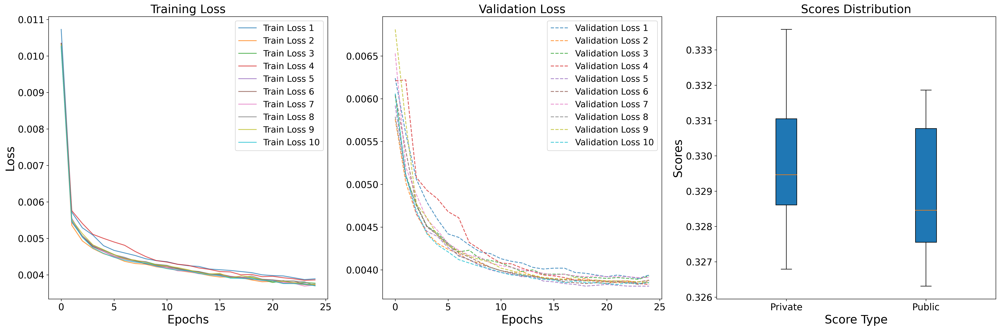

In [ ]:
train_loss_1 = [0.01073, 0.00572, 0.00529, 0.00509, 0.00480, 0.00467, 0.00460, 0.00453, 0.00444, 0.00439, 0.00436, 0.00429, 0.00425, 0.00423, 0.00416, 0.00414, 0.00412, 0.00409, 0.00406, 0.00400, 0.00398, 0.00397, 0.00392, 0.00387, 0.00389]
train_loss_2 = [0.01028, 0.00536, 0.00493, 0.00472, 0.00458, 0.00449, 0.00437, 0.00431, 0.00429, 0.00422, 0.00418, 0.00412, 0.00408, 0.00404, 0.00398, 0.00394, 0.00394, 0.00392, 0.00386, 0.00381, 0.00382, 0.00377, 0.00376, 0.00373, 0.00371]
train_loss_3 = [0.01032, 0.00544, 0.00505, 0.00478, 0.00467, 0.00455, 0.00445, 0.00438, 0.00436, 0.00428, 0.00425, 0.00417, 0.00412, 0.00409, 0.00402, 0.00400, 0.00392, 0.00393, 0.00392, 0.00387, 0.00379, 0.00384, 0.00377, 0.00379, 0.00377]
train_loss_4 = [0.01035, 0.00576, 0.00541, 0.00511, 0.00500, 0.00490, 0.00481, 0.00464, 0.00450, 0.00439, 0.00435, 0.00429, 0.00426, 0.00419, 0.00415, 0.00409, 0.00408, 0.00400, 0.00401, 0.00395, 0.00396, 0.00392, 0.00389, 0.00385, 0.00386]
train_loss_5 = [0.01025, 0.00555, 0.00505, 0.00478, 0.00468, 0.00455, 0.00446, 0.00439, 0.00436, 0.00425, 0.00422, 0.00419, 0.00409, 0.00408, 0.00402, 0.00397, 0.00394, 0.00393, 0.00388, 0.00387, 0.00386, 0.00377, 0.00378, 0.00376, 0.00370]
train_loss_6 = [0.01035, 0.00547, 0.00505, 0.00477, 0.00464, 0.00451, 0.00444, 0.00440, 0.00430, 0.00426, 0.00421, 0.00416, 0.00412, 0.00408, 0.00402, 0.00402, 0.00396, 0.00393, 0.00388, 0.00387, 0.00386, 0.00383, 0.00383, 0.00374, 0.00374]
train_loss_7 = [0.01025, 0.00544, 0.00506, 0.00482, 0.00464, 0.00450, 0.00443, 0.00435, 0.00432, 0.00423, 0.00421, 0.00411, 0.00410, 0.00403, 0.00401, 0.00398, 0.00396, 0.00394, 0.00389, 0.00384, 0.00383, 0.00380, 0.00377, 0.00369, 0.00372]
train_loss_8 = [0.01024, 0.00547, 0.00507, 0.00481, 0.00468, 0.00455, 0.00448, 0.00438, 0.00430, 0.00429, 0.00426, 0.00418, 0.00412, 0.00409, 0.00403, 0.00401, 0.00395, 0.00392, 0.00397, 0.00388, 0.00386, 0.00383, 0.00383, 0.00381, 0.00370]
train_loss_9 = [0.01031, 0.00551, 0.00513, 0.00482, 0.00469, 0.00456, 0.00444, 0.00440, 0.00434, 0.00427, 0.00424, 0.00420, 0.00414, 0.00406, 0.00402, 0.00404, 0.00392, 0.00397, 0.00394, 0.00386, 0.00382, 0.00382, 0.00379, 0.00374, 0.00373]
train_loss_10 = [0.01027, 0.00547, 0.00503, 0.00474, 0.00459, 0.00448, 0.00440, 0.00435, 0.00432, 0.00424, 0.00417, 0.00413, 0.00411, 0.00404, 0.00400, 0.00398, 0.00391, 0.00390, 0.00389, 0.00385, 0.00383, 0.00376, 0.00376, 0.00374, 0.00370]

val_loss_1 = [0.00624, 0.00559, 0.00506, 0.00479, 0.00459, 0.00442, 0.00438, 0.00429, 0.00421, 0.00419, 0.00413, 0.00410, 0.00408, 0.00403, 0.00401, 0.00402, 0.00402, 0.00397, 0.00396, 0.00394, 0.00392, 0.00394, 0.00392, 0.00390, 0.00394]
val_loss_2 = [0.00576, 0.00502, 0.00465, 0.00443, 0.00431, 0.00424, 0.00419, 0.00411, 0.00408, 0.00403, 0.00399, 0.00397, 0.00398, 0.00393, 0.00391, 0.00389, 0.00389, 0.00388, 0.00390, 0.00386, 0.00386, 0.00385, 0.00386, 0.00386, 0.00388]
val_loss_3 = [0.00604, 0.00511, 0.00475, 0.00451, 0.00443, 0.00431, 0.00421, 0.00423, 0.00413, 0.00411, 0.00408, 0.00403, 0.00398, 0.00400, 0.00395, 0.00395, 0.00395, 0.00392, 0.00391, 0.00391, 0.00390, 0.00391, 0.00390, 0.00389, 0.00393]
val_loss_4 = [0.00621, 0.00622, 0.00508, 0.00493, 0.00483, 0.00468, 0.00461, 0.00432, 0.00424, 0.00415, 0.00408, 0.00407, 0.00402, 0.00398, 0.00394, 0.00393, 0.00391, 0.00388, 0.00388, 0.00388, 0.00387, 0.00387, 0.00387, 0.00384, 0.00383]
val_loss_5 = [0.00592, 0.00511, 0.00466, 0.00445, 0.00439, 0.00426, 0.00417, 0.00412, 0.00405, 0.00400, 0.00397, 0.00395, 0.00392, 0.00392, 0.00387, 0.00386, 0.00384, 0.00383, 0.00381, 0.00382, 0.00383, 0.00382, 0.00381, 0.00381, 0.00381]
val_loss_6 = [0.00605, 0.00539, 0.00476, 0.00450, 0.00441, 0.00429, 0.00420, 0.00415, 0.00409, 0.00403, 0.00399, 0.00396, 0.00393, 0.00393, 0.00390, 0.00389, 0.00386, 0.00385, 0.00384, 0.00385, 0.00384, 0.00386, 0.00385, 0.00383, 0.00387]
val_loss_7 = [0.00653, 0.00520, 0.00488, 0.00459, 0.00446, 0.00431, 0.00423, 0.00417, 0.00415, 0.00408, 0.00405, 0.00403, 0.00400, 0.00398, 0.00396, 0.00394, 0.00395, 0.00393, 0.00392, 0.00393, 0.00392, 0.00392, 0.00392, 0.00391, 0.00391]
val_loss_8 = [0.00579, 0.00508, 0.00477, 0.00451, 0.00441, 0.00430, 0.00416, 0.00412, 0.00406, 0.00403, 0.00399, 0.00397, 0.00394, 0.00392, 0.00390, 0.00389, 0.00388, 0.00388, 0.00387, 0.00387, 0.00386, 0.00387, 0.00384, 0.00386, 0.00388]
val_loss_9 = [0.00681, 0.00572, 0.00477, 0.00461, 0.00440, 0.00428, 0.00422, 0.00416, 0.00412, 0.00409, 0.00402, 0.00399, 0.00395, 0.00394, 0.00391, 0.00390, 0.00389, 0.00391, 0.00387, 0.00388, 0.00387, 0.00387, 0.00387, 0.00386, 0.00385]
val_loss_10 = [0.00606, 0.00510, 0.00469, 0.00442, 0.00429, 0.00421, 0.00412, 0.00408, 0.00404, 0.00401, 0.00397, 0.00394, 0.00394, 0.00390, 0.00389, 0.00388, 0.00385, 0.00387, 0.00385, 0.00385, 0.00384, 0.00383, 0.00385, 0.00384, 0.00385]

best_score_1 = {"score": 0.41475, "top": 18}
best_score_2 = {"score": 0.42489, "top": 18}
best_score_3 = {"score": 0.41920, "top": 18}
best_score_4 = {"score": 0.42050, "top": 18}
best_score_5 = {"score": 0.42426, "top": 18}
best_score_6 = {"score": 0.42327, "top": 18}
best_score_7 = {"score": 0.42042, "top": 18}
best_score_8 = {"score": 0.42110, "top": 19}
best_score_9 = {"score": 0.41855, "top": 18}
best_score_10 = {"score": 0.42045, "top": 17}

# Private Scores
private_scores = [0.32679, 0.33205, 0.32704, 0.33099, 0.33358, 0.32853, 0.32949, 0.33107, 0.32885, 0.32944]

# Public Scores
public_scores = [0.32771, 0.32773, 0.32631, 0.32750, 0.33186, 0.33003, 0.33145, 0.32748, 0.33102, 0.32919]
scores = [0.41475, 0.42489, 0.41920, 0.42050, 0.42426, 0.42327, 0.42042, 0.42110, 0.41855, 0.42045]
# tops = [18, 18, 18, 18, 18, 18, 18, 19, 18, 17]

import matplotlib.pyplot as plt

# 用于存放所有训练损失列表的变量
train_loss_data = [
    train_loss_1,
    train_loss_2,
    train_loss_3,
    train_loss_4,
    train_loss_5,
    train_loss_6,
    train_loss_7,
    train_loss_8,
    train_loss_9,
    train_loss_10
]

# 用于存放所有验证损失列表的变量
val_loss_data = [
    val_loss_1,
    val_loss_2,
    val_loss_3,
    val_loss_4,
    val_loss_5,
    val_loss_6,
    val_loss_7,
    val_loss_8,
    val_loss_9,
    val_loss_10
]
import matplotlib.pyplot as plt

# 用于存放所有训练损失和验证损失的数据
train_loss_data = [
    train_loss_1,
    train_loss_2,
    train_loss_3,
    train_loss_4,
    train_loss_5,
    train_loss_6,
    train_loss_7,
    train_loss_8,
    train_loss_9,
    train_loss_10
]
val_loss_data = [
    val_loss_1,
    val_loss_2,
    val_loss_3,
    val_loss_4,
    val_loss_5,
    val_loss_6,
    val_loss_7,
    val_loss_8,
    val_loss_9,
    val_loss_10
]



# 创建1行3列的子图布局
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 8), dpi=300)

# 第一个子图：训练损失折线图
for i, losses in enumerate(train_loss_data, 1):
    ax1.plot(losses, label=f'Train Loss {i}', linestyle='-', alpha=0.75)
ax1.set_title('Training Loss', fontsize=20)
ax1.set_xlabel('Epochs', fontsize=20)
ax1.set_ylabel('Loss', fontsize=20)
ax1.legend(fontsize=15)
ax1.tick_params(axis='both', labelsize=16)  # 设置刻度标签的字体大小

# 第二个子图：验证损失折线图
for i, losses in enumerate(val_loss_data, 1):
    ax2.plot(losses, label=f'Validation Loss {i}', linestyle='--', alpha=0.75)
ax2.set_title('Validation Loss', fontsize=20)
ax2.set_xlabel('Epochs', fontsize=20)
ax2.legend(fontsize=15)
ax2.tick_params(axis='both', labelsize=16)

# 第三个子图：箱形图
ax3.boxplot([private_scores, public_scores], labels=['Private', 'Public'], patch_artist=True)
ax3.set_title('Scores Distribution', fontsize=20)
ax3.set_xlabel('Score Type', fontsize=20)
ax3.set_ylabel('Scores', fontsize=20)
# ax3.legend(fontsize=15)
ax3.tick_params(axis='both', labelsize=16)

# 显示整个图形
plt.tight_layout()
plt.show()



## Threshold Top-K

### Top-K

In [ ]:
all_surveyID = []
for batch_idx, (data0, data1, data2, data3, targets, surveyID, data4) in enumerate(tqdm(val_loader)):
  all_surveyID.extend(surveyID.numpy())
all_surveyID = np.array(all_surveyID)
all_predictions = np.load("val_predictions.npy")

train_pa = pd.read_csv(train_metadata_path)
gt = []
for surveyId in tqdm(all_surveyID):
    gt.append(train_pa[train_pa["surveyId"]==surveyId].speciesId.values.astype(int).tolist())
def eval_pred(pred,gt):
    list_f1 = []
    for p,g in zip(pred,gt):
        sp = set(p)
        sg = set(g)
        TP = len(list(sp.intersection(sg)))
        FP = len(list(sp-sg))
        FN = len(list(sg-sp))
        f1 = TP/(TP + (FP+FN)/2)
        list_f1.append(f1)
    return np.mean(list_f1)

pred_sorted = np.argsort(-all_predictions, axis=1)
best_top_k = 1
best_score = 0

for k in tqdm(range(1,100)):
    top_k = pred_sorted[:, :k].tolist()
    score = eval_pred(top_k,gt)
    if score > best_score :
        best_score = score
        best_top_k = k

print(f'best score {best_score:.5f} @ top {best_top_k}')


100%|██████████| 99/99 [00:18<00:00,  5.49it/s]


best score 0.49210 @ top 17


In [ ]:
test_data = pd.read_csv('/kaggle/input/geolifeclef-2024/GLC24_PA_metadata_test.csv')
surveys = test_data['surveyId'].values
all_predictions = np.load("predictions.npy")
best_top_k=18
top_k = np.argsort(-all_predictions, axis=1)[:, :best_top_k]
all_predictions = np.array(all_predictions)
data_concatenated = [' '.join(map(str, row)) for row in top_k]
pd.DataFrame(
        {'surveyId': surveys,
         'predictions': data_concatenated,
        }).to_csv("submission_all.csv", index=False)



### Calculate k and threshold

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
best_top_k = 1
best_score = 0
best_threshold = 0
all_predictions = val_predictions
# 可能的阈值范围
thresholds = np.arange(0.1, 0.51, 0.01)
k_values = range(20, 80)

# 初始化用于存储得分的数组
scores = np.zeros((len(k_values), len(thresholds)))

for i, k in tqdm(enumerate(k_values)):
    for j, threshold in enumerate(thresholds):
        # 过滤预测概率小于阈值的物种
        filtered_predictions = np.where(all_predictions >= threshold, all_predictions, -np.inf)
        pred_sorted = np.argsort(-filtered_predictions, axis=1)

        # 构建top_k，只包括大于阈值的物种
        top_k = []
        for m in range(pred_sorted.shape[0]):
            valid_indices = [idx for idx in pred_sorted[m, :k] if all_predictions[m, idx] >= threshold]
            top_k.append(valid_indices)

        score = eval_pred(top_k, gt)
        scores[i, j] = score  # 保存得分

        if score > best_score:
            best_score = score
            best_top_k = k
            best_threshold = threshold

print(f'Best score {best_score:.5f} @ top {best_top_k} with threshold {best_threshold:.2f}')

np.save("scores.npy",scores)

60it [41:57, 41.96s/it]

Best score 0.52655 @ top 44 with threshold 0.23


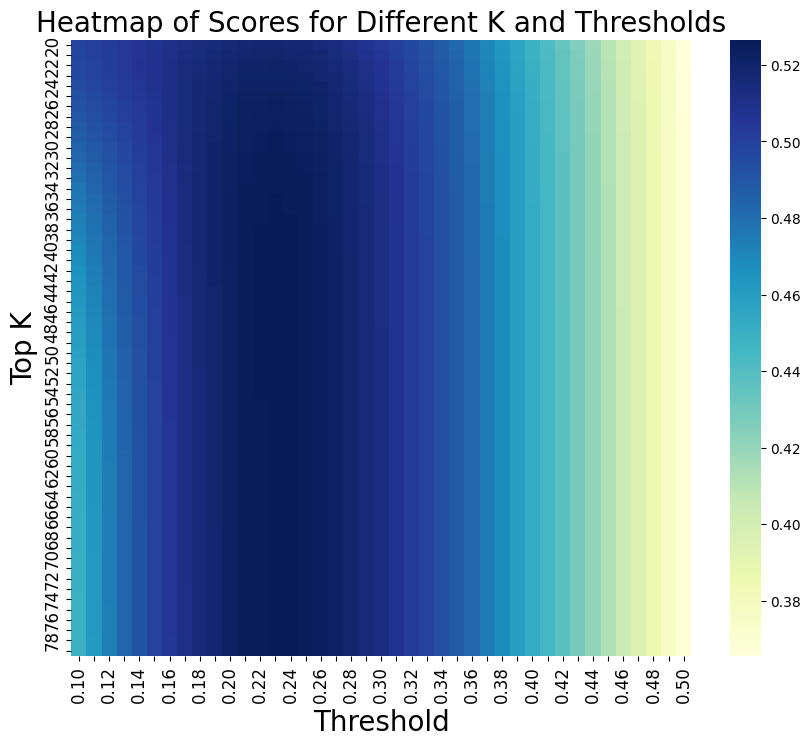

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# 假设您已经有了scores.npy文件和相应的数据加载
thresholds = np.arange(0.1, 0.51, 0.01)
k_values = list(range(20, 80))
scores = np.load("scores.npy")  # 加载分数数据

plt.figure(figsize=(10, 8))
# 使用列表推导来选择隔一个标签显示一个
ax = sns.heatmap(scores,
          xticklabels=[f"{x:.2f}" if i % 2 == 0 else "" for i, x in enumerate(np.round(thresholds, 2))],
          yticklabels=[k if i % 2 == 0 else "" for i, k in enumerate(k_values)],
          cmap="YlGnBu")
plt.xlabel('Threshold', fontsize=20)  # 增加X轴标签字体大小
plt.ylabel('Top K', fontsize=20)  # 增加Y轴标签字体大小
plt.title('Heatmap of Scores for Different K and Thresholds', fontsize=20)  # 增加标题字体大小
ax.tick_params(labelsize=12)  # 设置刻度标签字体大小
plt.show()



<ipython-input-42-032f5a101644>:41: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar = plt.colorbar(mappable, shrink=0.5, aspect=5)


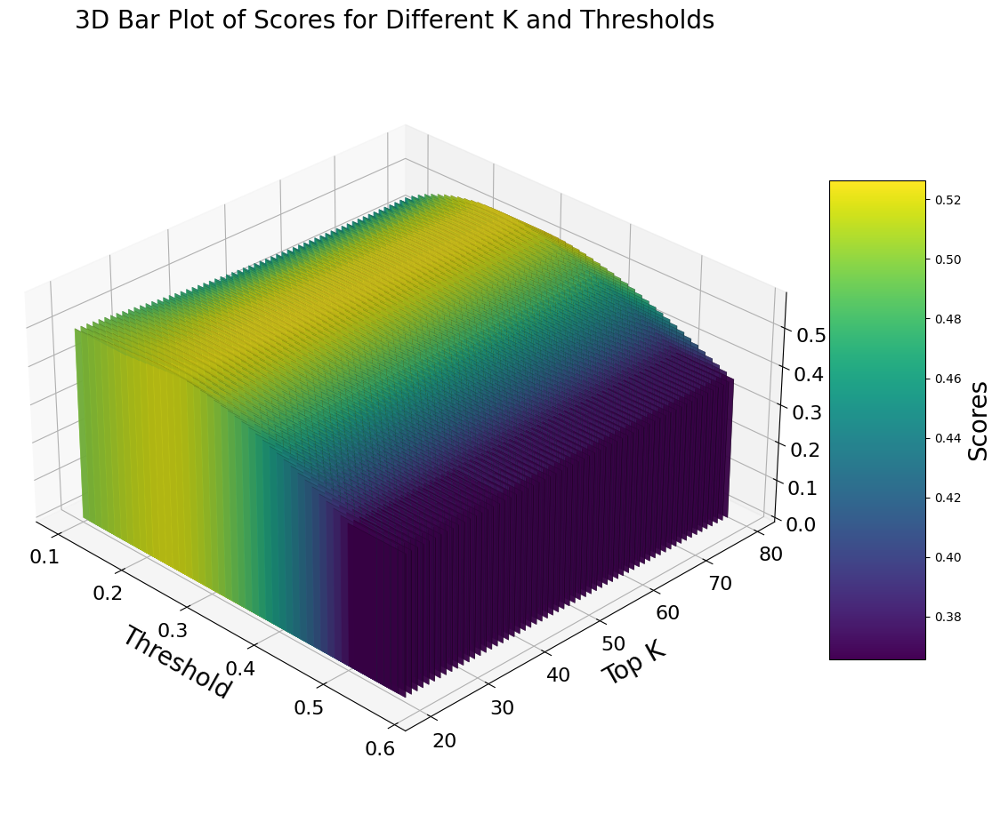

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
scores_=scores
# 创建 3D 图形
fig = plt.figure(figsize=(14, 14))
ax = fig.add_subplot(111, projection='3d')

# 设置 X, Y, Z 数据
X, Y = np.meshgrid(thresholds, k_values)
X = X.flatten()
Y = Y.flatten()
Z = np.zeros_like(X)
dx = dy = 0.08  # 每个柱子的宽度
dz = scores.flatten()

# 选择颜色
colors = plt.cm.viridis((dz - dz.min()) / (dz.max() - dz.min()))

# 绘制 3D 柱状图
ax.bar3d(X, Y, Z, dx, dy, dz, color=colors, alpha=0.8)

# 设置标签
ax.set_xlabel('Threshold', fontsize=20, labelpad=10)
ax.set_ylabel('Top K', fontsize=20, labelpad=10)
ax.set_zlabel('Scores', fontsize=20, labelpad=10)
ax.set_title('3D Bar Plot of Scores for Different K and Thresholds', fontsize=20, pad=0)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=16)

# 调整 Z 轴范围
ax.set_zlim(0, np.max(dz) * 1.1)  # 设置 Z 轴范围为最大值的 110%

# 调整视角和比例
ax.view_init(elev=30, azim=-45)  # 调整视角以获得更好的效果
ax.set_box_aspect([2, 2, 1])  # 调整比例，使得柱子更宽

# 添加颜色条
mappable = plt.cm.ScalarMappable(cmap='viridis')
mappable.set_array(scores)
cbar = plt.colorbar(mappable, shrink=0.5, aspect=5)
cbar.set_label('Scores',fontsize=20)

plt.show()

### Inference

In [ ]:
surveys = test_data['surveyId'].values
# best_top_k=45
# best_threshold=0.25
top_k = np.argsort(-predictions, axis=1)[:, :best_top_k]
top = np.sort(-predictions, axis=1)[:, :best_top_k]
top_k_indices = None
if top_k_indices is None:
     top_k_indices = top_k
else:
     top_k_indices = np.concatenate((top_k_indices, top_k), axis=0)

print(top)

result = []
print(top.shape)
# 遍历每一行
for i in range(top.shape[0]):
    # 对于每一行，检查top的值是否大于-0.09
    filtered = [top_k[i, j] for j in range(top.shape[1]) if top[i, j] < -best_threshold]
    result.append(filtered)

# 将结果转换为Pandas DataFrame
df = pd.DataFrame({'Filtered_top_k': result})
print(df)
df.to_csv('check.csv', index=False)
data_concatenated = [' '.join(map(str, row)) for row in result]
pd.DataFrame(
    {'surveyId': surveys,
     'predictions': data_concatenated,
    }).to_csv("submission_1.csv", index = False)

[[-0.935547   -0.63758814 -0.5082289  ... -0.05107105 -0.04703105
  -0.0432572 ]
 [-0.6115073  -0.5465479  -0.5264765  ... -0.10427    -0.10221781
  -0.10029013]
 [-0.30890974 -0.25805587 -0.25240076 ... -0.04587217 -0.04511524
  -0.04378671]
 ...
 [-0.89059335 -0.8635645  -0.86044514 ... -0.24618879 -0.24490753
  -0.23645186]
 [-0.6053119  -0.51934385 -0.4794673  ... -0.14342648 -0.14082597
  -0.13898134]
 [-0.81439054 -0.79996973 -0.75093925 ... -0.20673938 -0.20377538
  -0.19896251]]
(4716, 45)
                                         Filtered_top_k
0     [963, 7999, 6962, 7942, 8807, 5114, 1964, 9669...
1     [262, 838, 5483, 3451, 6603, 3744, 3419, 5557,...
2                          [96, 6905, 4207, 2630, 4842]
3     [10404, 9040, 6497, 6407, 11012, 3211, 4590, 7...
4     [10255, 10600, 6999, 7978, 651, 10940, 5189, 6...
...                                                 ...
4711                    [6079, 10223, 10255, 5386, 254]
4712    [6643, 2922, 6491, 1252, 3738, 3135, 6746

### output adjustment

In [ ]:
import pandas as pd
import numpy as np
from scipy.spatial import cKDTree
import ast  # 导入 ast 模块
# 加载数据
p0_data = pd.read_csv('train_data_P0.csv')
test_data = pd.read_csv('/kaggle/input/geolifeclef-2024/GLC24_PA_metadata_test.csv')

if isinstance(p0_data['speciesIds'].iloc[0], str):
    p0_data['speciesIds'] = p0_data['speciesIds'].apply(ast.literal_eval)

# 函数用于计算地球上两点之间的距离
def haversine(lon1, lat1, lon2, lat2):
    # 将经纬度转换成弧度
    lon1, lat1, lon2, lat2 = map(np.radians, [lon1, lat1, lon2, lat2])
    # haversine公式
    dlon = lon2 - lon1
    dlat = lat2 - lat1
    a = np.sin(dlat/2)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2)**2
    c = 2 * np.arcsin(np.sqrt(a))
    r = 6371  # 地球平均半径，单位公里
    return c * r

# 预先为每个年份及其前后一年创建KD-Tree及其对应数据
trees = {}
data_store = {}
unique_years = p0_data['year'].unique()
for year in unique_years:
    year_range_data = p0_data[p0_data['year'].between(year - 1, year + 1)]
    if not year_range_data.empty:
        trees[year] = cKDTree(year_range_data[['lon', 'lat']].values)
        data_store[year] = year_range_data  # 存储相关数据在一个单独的字典中

# 为每个测试点找到年份相近且距离最近的10个点
results = []
for index, row in test_data.iterrows():
    year = row['year']
    if year in trees:
        tree = trees[year]
        year_data = data_store[year]  # 从存储字典中引用数据

        # 计算距离并找到最近的5个点
        distances, indices = tree.query([row['lon'], row['lat']], k=min(6, len(year_data)))

        # 确保indices是数组形式，以防只有一个点
        # if not isinstance(indices, np.ndarray):
        #     print(f"Indices for year {year} is not an array: {indices}")
        #     indices = [indices]

        nearest_points = year_data.iloc[indices]
        # print(nearest_points)

        # 统计speciesIds出现2次及以上的物种编号
        species_counts = nearest_points['speciesIds'].explode().value_counts()
        # print(species_counts)
        frequent_species = species_counts[species_counts >= 3].index.tolist()

        # 转换为以空格分隔的字符串
        result = ' '.join(map(str, frequent_species))
        results.append(result)
    else:
        results.append('')  # 没有相应的树时返回空字符串

# 输出结果
print(results)
print(len(results))
test_data['predictions'] = results
test_data[['surveyId', 'predictions']].to_csv('test_common_species_output.csv', index=False)
print(test_data)
new_df = test_data[['surveyId', 'predictions']]
new_df.to_csv('support.csv', index=False)

['', '', '', '', '4609 6331', '661', '', '6999 9714', '', '', '', '', '1251', '1251', '', '', '', '', '', '', '', '1924 4493 5363 5416 9826', '', '', '', '', '', '', '', '', '', '9714 4890 6999', '9714', '', '', '', '', '', '4734 4404 7739', '', '215', '', '', '', '', '', '', '', '', '9600 9714', '', '', '', '', '', '5114 8512 1264', '', '', '', '', '', '', '', '', '', '9890 5404 6914', '', '1251', '', '', '', '', '9890', '215', '', '', '1707 11005', '', '', '9207', '', '5018 2556', '', '', '', '', '7122 649 5189', '', '', '', '', '', '', '', '', '', '', '9448', '', '', '', '1288 540', '', '5018 8661 3581', '', '', '', '', '', '', '', '', '', '', '', '9826', '', '', '3979 10896 4871', '', '', '10896 3177 4871 791', '', '87', '', '', '', '', '2684', '', '', '', '', '', '', '', '10097', '', '', '', '6119 10474 10621', '', '', '2684', '9826', '', '10112 7450', '7868', '', '', '10937 5189 4483', '215', '', '', '', '7212', '', '', '', '', '6914 9826', '', '', '', '10969 96 643 1466 10317 64

In [ ]:
submission_df = pd.read_csv('submission_1.csv')
support_df=pd.read_csv('support.csv')
# Merge the dataframes on 'surveyId'
merged_df = pd.merge(support_df, submission_df, on='surveyId', suffixes=('_support', '_submission'))

# Function to merge and deduplicate predictions
def merge_predictions(row):
    pred_support = row['predictions_support']
    pred_submission = row['predictions_submission']

    if pd.isna(pred_support):
        pred_support = ""
    if pd.isna(pred_submission):
        pred_submission = ""

    merged_predictions = set(pred_support.split() + pred_submission.split())
    return " ".join(sorted(merged_predictions))

# Apply the function to each row
merged_df['predictions'] = merged_df.apply(merge_predictions, axis=1)

# Select the columns for the final submission
final_submission_df = merged_df[['surveyId', 'predictions']]

# Save the final submission to a new CSV file
output_file_path = 'final_submission.csv'
final_submission_df.to_csv(output_file_path, index=False)

print("Final submission file saved to:", output_file_path)


Final submission file saved to: final_submission.csv


# Comparative Experiments

## baseline

In [ ]:
class MultimodalEnsemble(nn.Module):
    def __init__(self, num_classes):
        super(MultimodalEnsemble, self).__init__()
        self.tab_norm = nn.LayerNorm([len(features)])
        self.tab_model = nn.Sequential(
            nn.Linear(len(features), 128),
            nn.ReLU(),
            nn.Linear(128, 128),
            nn.ReLU(),
            nn.Linear(128, 64),
        )

        self.landsat_norm = nn.LayerNorm([6, 4, 21])
        self.landsat_model = timm.create_model('resnet18', pretrained=False, in_chans=6)
        # print(self.landsat_model)
        self.landsat_model.global_pool = nn.Identity()
        self.landsat_model.fc = nn.Identity()

        self.bioclim_norm = nn.LayerNorm([4, 19, 12])
        self.bioclim_model = timm.create_model('resnet18', pretrained=False,  in_chans=4)
        self.bioclim_model.global_pool = nn.Identity()
        self.bioclim_model.fc = nn.Identity()

        self.sentinel_model = timm.create_model('swin_tiny_patch4_window7_224', pretrained=True, in_chans=4)
        # print(self.sentinel_model)
        self.sentinel_model.head.fc = nn.Identity()

        self.ln0 = nn.LayerNorm(64)
        self.ln1 = nn.LayerNorm(512)
        self.ln2 = nn.LayerNorm(512)
        self.ln3 = nn.LayerNorm(768)

        self.fc1 = nn.Linear(64 + 512 + 512 + 768, 1824)  # 总输入维度需要根据特征提取器输出维度进行调整
        self.fc2 = nn.Linear(1824, num_classes)

        self.dropout = nn.Dropout(p=0.15)

    def forward(self, t, x, y, z):
        t = self.tab_norm(t)
        t = self.tab_model(t)

        t = self.ln0(t)
        t = self.dropout(t)

        x = self.landsat_norm(x)
        x = self.landsat_model(x)
        x = torch.flatten(x, start_dim=1)  # 将张量压缩为二维
        x = self.ln1(x)
        x = self.dropout(x)

        y = self.bioclim_norm(y)
        y = self.bioclim_model(y)
        y = torch.flatten(y, start_dim=1)  # 将张量压缩为二维
        y = self.ln2(y)
        y = self.dropout(y)

        z = self.sentinel_model(z)
        # z = torch.flatten(z, start_dim=1)  # 将张量压缩为二维
        z = self.ln3(z)
        z = self.dropout(z)

        txyz = torch.cat((t, x, y, z), dim=1)

        txyz = self.fc1(txyz).relu()
        txyz = self.dropout(txyz)

        out = self.fc2(txyz)

        return out

In [ ]:
model = MultimodalEnsemble(num_classes)
best_model = train_model(model, train_loader, val_loader, num_classes, num_epochs=25, learning_rate=2e-4, debug=False)
predictions=evaluate_and_predict(best_model, train_loader, val_loader, test_loader, train_metadata_path, device)

DEVICE = CUDA
Training for 25 epochs started.


  0%|          | 0/626 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,
100%|██████████| 626/626 [04:37<00:00,  2.25it/s]


Epoch 0 : train_loss 0.01199 | val_loss 0.00481


100%|██████████| 626/626 [04:36<00:00,  2.27it/s]


Epoch 1 : train_loss 0.00490 | val_loss 0.00441


100%|██████████| 626/626 [04:36<00:00,  2.26it/s]


Epoch 2 : train_loss 0.00462 | val_loss 0.00427


100%|██████████| 626/626 [04:36<00:00,  2.26it/s]


Epoch 3 : train_loss 0.00448 | val_loss 0.00419


100%|██████████| 626/626 [04:36<00:00,  2.26it/s]


Epoch 4 : train_loss 0.00435 | val_loss 0.00408


100%|██████████| 626/626 [04:36<00:00,  2.27it/s]


Epoch 5 : train_loss 0.00425 | val_loss 0.00402


100%|██████████| 626/626 [04:36<00:00,  2.27it/s]


Epoch 6 : train_loss 0.00417 | val_loss 0.00397


100%|██████████| 626/626 [04:36<00:00,  2.26it/s]


Epoch 7 : train_loss 0.00410 | val_loss 0.00393


100%|██████████| 626/626 [04:36<00:00,  2.26it/s]


Epoch 8 : train_loss 0.00399 | val_loss 0.00393


100%|██████████| 626/626 [04:36<00:00,  2.26it/s]


Epoch 9 : train_loss 0.00393 | val_loss 0.00388


100%|██████████| 626/626 [04:36<00:00,  2.27it/s]


Epoch 10 : train_loss 0.00391 | val_loss 0.00385


100%|██████████| 626/626 [04:35<00:00,  2.27it/s]


Epoch 11 : train_loss 0.00383 | val_loss 0.00383


100%|██████████| 626/626 [04:35<00:00,  2.27it/s]


Epoch 12 : train_loss 0.00378 | val_loss 0.00381


100%|██████████| 626/626 [04:36<00:00,  2.27it/s]


Epoch 13 : train_loss 0.00368 | val_loss 0.00380


100%|██████████| 626/626 [04:36<00:00,  2.27it/s]


Epoch 14 : train_loss 0.00362 | val_loss 0.00379


100%|██████████| 626/626 [04:36<00:00,  2.27it/s]


Epoch 15 : train_loss 0.00356 | val_loss 0.00380


100%|██████████| 626/626 [04:36<00:00,  2.27it/s]


Epoch 16 : train_loss 0.00346 | val_loss 0.00383


100%|██████████| 626/626 [04:36<00:00,  2.27it/s]


Epoch 17 : train_loss 0.00337 | val_loss 0.00382


100%|██████████| 626/626 [04:36<00:00,  2.27it/s]


Epoch 18 : train_loss 0.00335 | val_loss 0.00385


100%|██████████| 626/626 [04:36<00:00,  2.27it/s]


Epoch 19 : train_loss 0.00330 | val_loss 0.00385


100%|██████████| 626/626 [04:36<00:00,  2.26it/s]


Epoch 20 : train_loss 0.00321 | val_loss 0.00385


100%|██████████| 626/626 [04:36<00:00,  2.26it/s]


Epoch 21 : train_loss 0.00312 | val_loss 0.00393


100%|██████████| 626/626 [04:36<00:00,  2.27it/s]


Epoch 22 : train_loss 0.00309 | val_loss 0.00392


100%|██████████| 626/626 [04:36<00:00,  2.26it/s]


Epoch 23 : train_loss 0.00302 | val_loss 0.00391


100%|██████████| 626/626 [04:36<00:00,  2.26it/s]


Epoch 24 : train_loss 0.00298 | val_loss 0.00400


100%|██████████| 99/99 [00:14<00:00,  6.86it/s]


Best score 0.43204 @ top 17


100%|██████████| 37/37 [00:11<00:00,  3.16it/s]


## Time cubes model

### TC_swin_T

In [ ]:
class MultimodalEnsemble(nn.Module):
    def __init__(self, num_classes):
        super(MultimodalEnsemble, self).__init__()
        self.tab_norm = nn.LayerNorm([len(features)])
        self.tab_model = nn.Sequential(
            nn.Linear(len(features), 128),
            nn.ReLU(),
            nn.Linear(128, 128),
            nn.ReLU(),
            nn.Linear(128, 64),
        )

        self.landsat_norm = nn.LayerNorm([6, 4, 20])
        self.landsat_model = timm.models.swin_transformer.SwinTransformer(
                        img_size=(4,20),
                        patch_size=(2,5),
                        in_chans=6,
                        num_classes=1000,
                        embed_dim=96,
                        depths=(2,6,),
                        num_heads=(12, 24),
                        window_size=(2,3)
                    )
        # print(self.landsat_model)
        self.landsat_model.global_pool = nn.Identity()
        self.landsat_model.head.fc = nn.Identity()

        self.bioclim_norm = nn.LayerNorm([4, 18, 12])
        self.bioclim_model = timm.models.swin_transformer.SwinTransformer(
                        img_size=(18,12),
                        patch_size=(3,3),
                        in_chans=4,
                        num_classes=1000,
                        embed_dim=96,
                        depths=(2,6),
                        num_heads=( 12, 24),
                        window_size=(3,2)
                    )
        self.bioclim_model.global_pool = nn.Identity()
        self.bioclim_model.head.fc = nn.Identity()

        self.sentinel_model = timm.create_model('swin_tiny_patch4_window7_224', pretrained=True, in_chans=4)
        # print(self.sentinel_model)
        self.sentinel_model.head.fc = nn.Identity()

        self.ln0 = nn.LayerNorm(64)
        self.ln1 = nn.LayerNorm(192)
        self.ln2 = nn.LayerNorm(192)
        self.ln3 = nn.LayerNorm(768)

        self.fc1 = nn.Linear(64 + 192 + 192 + 768, 1536)  # 总输入维度需要根据特征提取器输出维度进行调整
        self.fc2 = nn.Linear(1536, num_classes)

        self.dropout = nn.Dropout(p=0.15)

    def forward(self, t, x, y, z):
        t = self.tab_norm(t)
        t = self.tab_model(t)

        t = self.ln0(t)
        t = self.dropout(t)

        x = x[..., :20]
        x = self.landsat_norm(x)
        x = self.landsat_model(x)
        x = torch.flatten(x, start_dim=1)  # 将张量压缩为二维
        x = self.ln1(x)
        x = self.dropout(x)

        y = y[:, :, :18, :]
        y = self.bioclim_norm(y)
        y = self.bioclim_model(y)
        y = torch.flatten(y, start_dim=1)  # 将张量压缩为二维
        y = self.ln2(y)
        y = self.dropout(y)

        z = self.sentinel_model(z)
        # z = torch.flatten(z, start_dim=1)  # 将张量压缩为二维
        z = self.ln3(z)
        z = self.dropout(z)

        txyz = torch.cat((t, x, y, z), dim=1)

        txyz = self.fc1(txyz).relu()
        txyz = self.dropout(txyz)

        out = self.fc2(txyz)

        return out

In [ ]:
model = MultimodalEnsemble(num_classes)
best_model = train_model(model, train_loader, val_loader, num_classes, num_epochs=25, learning_rate=2e-4, debug=False)
predictions=evaluate_and_predict(best_model, train_loader, val_loader, test_loader, train_metadata_path, device)

DEVICE = CUDA
Training for 25 epochs started.


100%|██████████| 626/626 [04:46<00:00,  2.18it/s]


Epoch 0 : train_loss 0.01260 | val_loss 0.00540


100%|██████████| 626/626 [04:47<00:00,  2.18it/s]


Epoch 1 : train_loss 0.00530 | val_loss 0.00470


100%|██████████| 626/626 [04:46<00:00,  2.19it/s]


Epoch 2 : train_loss 0.00482 | val_loss 0.00438


100%|██████████| 626/626 [04:47<00:00,  2.18it/s]


Epoch 3 : train_loss 0.00458 | val_loss 0.00424


100%|██████████| 626/626 [04:46<00:00,  2.18it/s]


Epoch 4 : train_loss 0.00445 | val_loss 0.00414


100%|██████████| 626/626 [04:46<00:00,  2.18it/s]


Epoch 5 : train_loss 0.00430 | val_loss 0.00404


100%|██████████| 626/626 [04:47<00:00,  2.18it/s]


Epoch 6 : train_loss 0.00422 | val_loss 0.00396


100%|██████████| 626/626 [04:46<00:00,  2.19it/s]


Epoch 7 : train_loss 0.00410 | val_loss 0.00394


100%|██████████| 626/626 [04:46<00:00,  2.18it/s]


Epoch 8 : train_loss 0.00398 | val_loss 0.00389


100%|██████████| 626/626 [04:46<00:00,  2.18it/s]


Epoch 9 : train_loss 0.00389 | val_loss 0.00389


100%|██████████| 626/626 [04:46<00:00,  2.18it/s]


Epoch 10 : train_loss 0.00383 | val_loss 0.00388


100%|██████████| 626/626 [04:46<00:00,  2.19it/s]


Epoch 11 : train_loss 0.00371 | val_loss 0.00388


100%|██████████| 626/626 [04:46<00:00,  2.19it/s]


Epoch 12 : train_loss 0.00365 | val_loss 0.00385


100%|██████████| 626/626 [04:46<00:00,  2.19it/s]


Epoch 13 : train_loss 0.00353 | val_loss 0.00388


100%|██████████| 626/626 [04:50<00:00,  2.15it/s]


Epoch 14 : train_loss 0.00346 | val_loss 0.00393


100%|██████████| 626/626 [04:47<00:00,  2.18it/s]


Epoch 15 : train_loss 0.00339 | val_loss 0.00393


100%|██████████| 626/626 [04:47<00:00,  2.18it/s]


Epoch 16 : train_loss 0.00330 | val_loss 0.00390


100%|██████████| 626/626 [04:47<00:00,  2.18it/s]


Epoch 17 : train_loss 0.00326 | val_loss 0.00395


100%|██████████| 626/626 [04:46<00:00,  2.18it/s]


Epoch 18 : train_loss 0.00314 | val_loss 0.00395


100%|██████████| 626/626 [04:47<00:00,  2.18it/s]


Epoch 19 : train_loss 0.00314 | val_loss 0.00393


100%|██████████| 626/626 [04:47<00:00,  2.18it/s]


Epoch 20 : train_loss 0.00312 | val_loss 0.00396


100%|██████████| 626/626 [04:47<00:00,  2.18it/s]


Epoch 21 : train_loss 0.00304 | val_loss 0.00400


100%|██████████| 626/626 [04:47<00:00,  2.18it/s]


Epoch 22 : train_loss 0.00292 | val_loss 0.00409


100%|██████████| 626/626 [04:46<00:00,  2.19it/s]


Epoch 23 : train_loss 0.00298 | val_loss 0.00410


100%|██████████| 626/626 [04:47<00:00,  2.18it/s]


Epoch 24 : train_loss 0.00288 | val_loss 0.00404


100%|██████████| 99/99 [00:14<00:00,  6.89it/s]


Best score 0.42690 @ top 17


100%|██████████| 37/37 [00:12<00:00,  3.08it/s]


### ViT

In [ ]:
class MultimodalEnsemble(nn.Module):
    def __init__(self, num_classes):
        super(MultimodalEnsemble, self).__init__()
        self.tab_norm = nn.LayerNorm([len(features)])
        self.tab_model = nn.Sequential(
            nn.Linear(len(features), 128),
            nn.ReLU(),
            nn.Linear(128, 128),
            nn.ReLU(),
            nn.Linear(128, 64),
        )

        self.landsat_norm = nn.LayerNorm([6, 4, 21])
        self.landsat_model = timm.models.vision_transformer.VisionTransformer(
                    img_size=(4, 21),
                    patch_size=(2, 3),
                    in_chans=6,
                    num_classes=1000,
                    embed_dim=96,
                    depth=12,
                    num_heads=12,
                    mlp_ratio=4,
                    qkv_bias=True,
                    drop_rate=0,
                    attn_drop_rate=0
                )
        # print(self.landsat_model)
        # self.landsat_model.global_pool = nn.Identity()
        self.landsat_model.head = nn.Identity()

        self.bioclim_norm = nn.LayerNorm([4, 19, 12])
        self.bioclim_model =  timm.models.vision_transformer.VisionTransformer(
                    img_size=(19, 12),
                    patch_size=(4, 4),
                    in_chans=4,
                    num_classes=1000,
                    embed_dim=96,
                    depth=12,
                    num_heads=12,
                    mlp_ratio=4,
                    qkv_bias=True,
                    drop_rate=0,
                    attn_drop_rate=0
                )
        self.bioclim_model.head = nn.Identity()
        # print(self.bioclim_model)

        self.sentinel_model = timm.create_model('swin_tiny_patch4_window7_224', pretrained=True, in_chans=4)
        # print(self.sentinel_model)
        self.sentinel_model.head.fc = nn.Identity()

        self.ln0 = nn.LayerNorm(64)
        self.ln1 = nn.LayerNorm(96)
        self.ln2 = nn.LayerNorm(96)
        self.ln3 = nn.LayerNorm(768)

        self.fc1 = nn.Linear(64 + 96 + 96 + 768, 1824)  # 总输入维度需要根据特征提取器输出维度进行调整
        self.fc2 = nn.Linear(1824, num_classes)

        self.dropout = nn.Dropout(p=0.15)

    def forward(self, t, x, y, z):
        t = self.tab_norm(t)
        t = self.tab_model(t)

        t = self.ln0(t)
        t = self.dropout(t)

        x = self.landsat_norm(x)
        x = self.landsat_model(x)
        x = torch.flatten(x, start_dim=1)  # 将张量压缩为二维
        x = self.ln1(x)
        x = self.dropout(x)

        y = self.bioclim_norm(y)
        y = self.bioclim_model(y)
        y = torch.flatten(y, start_dim=1)  # 将张量压缩为二维
        y = self.ln2(y)
        y = self.dropout(y)

        z = self.sentinel_model(z)
        # z = torch.flatten(z, start_dim=1)  # 将张量压缩为二维
        z = self.ln3(z)
        z = self.dropout(z)

        txyz = torch.cat((t, x, y, z), dim=1)

        txyz = self.fc1(txyz).relu()
        txyz = self.dropout(txyz)

        out = self.fc2(txyz)

        return out

In [ ]:
model = MultimodalEnsemble(num_classes)
best_model = train_model(model, train_loader, val_loader, num_classes, num_epochs=25, learning_rate=2e-4, debug=False)
predictions=evaluate_and_predict(best_model, train_loader, val_loader, test_loader, train_metadata_path, device)

DEVICE = CUDA
Training for 25 epochs started.


  0%|          | 0/626 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
100%|██████████| 626/626 [04:44<00:00,  2.20it/s]


Epoch 0 : train_loss 0.01232 | val_loss 0.00540


100%|██████████| 626/626 [04:44<00:00,  2.20it/s]


Epoch 1 : train_loss 0.00541 | val_loss 0.00485


100%|██████████| 626/626 [04:43<00:00,  2.21it/s]


Epoch 2 : train_loss 0.00499 | val_loss 0.00458


100%|██████████| 626/626 [04:43<00:00,  2.21it/s]


Epoch 3 : train_loss 0.00477 | val_loss 0.00442


100%|██████████| 626/626 [04:44<00:00,  2.20it/s]


Epoch 4 : train_loss 0.00466 | val_loss 0.00436


100%|██████████| 626/626 [04:43<00:00,  2.20it/s]


Epoch 5 : train_loss 0.00452 | val_loss 0.00424


100%|██████████| 626/626 [04:43<00:00,  2.21it/s]


Epoch 6 : train_loss 0.00446 | val_loss 0.00418


100%|██████████| 626/626 [04:43<00:00,  2.20it/s]


Epoch 7 : train_loss 0.00438 | val_loss 0.00416


100%|██████████| 626/626 [04:43<00:00,  2.21it/s]


Epoch 8 : train_loss 0.00433 | val_loss 0.00409


100%|██████████| 626/626 [04:43<00:00,  2.20it/s]


Epoch 9 : train_loss 0.00428 | val_loss 0.00404


100%|██████████| 626/626 [04:45<00:00,  2.20it/s]


Epoch 10 : train_loss 0.00424 | val_loss 0.00403


100%|██████████| 626/626 [04:44<00:00,  2.20it/s]


Epoch 11 : train_loss 0.00418 | val_loss 0.00399


100%|██████████| 626/626 [04:44<00:00,  2.20it/s]


Epoch 12 : train_loss 0.00417 | val_loss 0.00396


100%|██████████| 626/626 [04:43<00:00,  2.21it/s]


Epoch 13 : train_loss 0.00413 | val_loss 0.00394


100%|██████████| 626/626 [04:43<00:00,  2.21it/s]


Epoch 14 : train_loss 0.00411 | val_loss 0.00393


100%|██████████| 626/626 [04:49<00:00,  2.16it/s]


Epoch 15 : train_loss 0.00405 | val_loss 0.00390


100%|██████████| 626/626 [04:45<00:00,  2.20it/s]


Epoch 16 : train_loss 0.00403 | val_loss 0.00389


100%|██████████| 626/626 [04:45<00:00,  2.20it/s]


Epoch 17 : train_loss 0.00398 | val_loss 0.00387


100%|██████████| 626/626 [04:44<00:00,  2.20it/s]


Epoch 18 : train_loss 0.00398 | val_loss 0.00388


100%|██████████| 626/626 [04:44<00:00,  2.20it/s]


Epoch 19 : train_loss 0.00390 | val_loss 0.00384


100%|██████████| 626/626 [04:45<00:00,  2.20it/s]


Epoch 20 : train_loss 0.00391 | val_loss 0.00384


100%|██████████| 626/626 [04:44<00:00,  2.20it/s]


Epoch 21 : train_loss 0.00385 | val_loss 0.00383


100%|██████████| 626/626 [04:44<00:00,  2.20it/s]


Epoch 22 : train_loss 0.00387 | val_loss 0.00382


100%|██████████| 626/626 [04:45<00:00,  2.20it/s]


Epoch 23 : train_loss 0.00383 | val_loss 0.00382


100%|██████████| 626/626 [04:44<00:00,  2.20it/s]


Epoch 24 : train_loss 0.00380 | val_loss 0.00381


100%|██████████| 99/99 [00:14<00:00,  6.86it/s]


Best score 0.42669 @ top 18


100%|██████████| 37/37 [00:11<00:00,  3.09it/s]


### Xception

In [ ]:
class MultimodalEnsemble(nn.Module):
    def __init__(self, num_classes):
        super(MultimodalEnsemble, self).__init__()
        self.tab_norm = nn.LayerNorm([len(features)])
        self.tab_model = nn.Sequential(
            nn.Linear(len(features), 128),
            nn.ReLU(),
            nn.Linear(128, 128),
            nn.ReLU(),
            nn.Linear(128, 64),
        )

        self.landsat_norm = nn.LayerNorm([6, 4, 21])
        self.landsat_model = timm.create_model('xception41', pretrained=False, in_chans=6)
        # print(self.landsat_model)
        self.landsat_model.global_pool = nn.Identity()
        self.landsat_model.head.fc = nn.Identity()

        self.bioclim_norm = nn.LayerNorm([4, 19, 12])
        self.bioclim_model = timm.create_model('xception41', pretrained=False,  in_chans=4)
        self.bioclim_model.global_pool = nn.Identity()
        self.bioclim_model.head.fc = nn.Identity()

        self.sentinel_model = timm.create_model('swin_tiny_patch4_window7_224', pretrained=True, in_chans=4)
        # print(self.sentinel_model)
        self.sentinel_model.head.fc = nn.Identity()

        self.ln0 = nn.LayerNorm(64)
        self.ln1 = nn.LayerNorm(2048)
        self.ln2 = nn.LayerNorm(2048)
        self.ln3 = nn.LayerNorm(768)

        self.fc1 = nn.Linear(64 + 2048 + 2048 + 768, 1824)  # 总输入维度需要根据特征提取器输出维度进行调整
        self.fc2 = nn.Linear(1824, num_classes)

        self.dropout = nn.Dropout(p=0.15)

    def forward(self, t, x, y, z):
        t = self.tab_norm(t)
        t = self.tab_model(t)

        t = self.ln0(t)
        t = self.dropout(t)

        x = self.landsat_norm(x)
        x = self.landsat_model(x)
        x = torch.flatten(x, start_dim=1)  # 将张量压缩为二维
        x = self.ln1(x)
        x = self.dropout(x)

        y = self.bioclim_norm(y)
        y = self.bioclim_model(y)
        y = torch.flatten(y, start_dim=1)  # 将张量压缩为二维
        y = self.ln2(y)
        y = self.dropout(y)

        z = self.sentinel_model(z)
        # z = torch.flatten(z, start_dim=1)  # 将张量压缩为二维
        z = self.ln3(z)
        z = self.dropout(z)

        txyz = torch.cat((t, x, y, z), dim=1)

        txyz = self.fc1(txyz).relu()
        txyz = self.dropout(txyz)

        out = self.fc2(txyz)

        return out

In [ ]:
model = MultimodalEnsemble(num_classes)
best_model = train_model(model, train_loader, val_loader, num_classes, num_epochs=25, learning_rate=2e-4, debug=False)
predictions=evaluate_and_predict(best_model, train_loader, val_loader, test_loader, train_metadata_path, device)

DEVICE = CUDA
Training for 25 epochs started.


  0%|          | 0/626 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
100%|██████████| 626/626 [05:13<00:00,  2.00it/s]


Epoch 0 : train_loss 0.01186 | val_loss 0.00473


100%|██████████| 626/626 [05:12<00:00,  2.00it/s]


Epoch 1 : train_loss 0.00495 | val_loss 0.00448


100%|██████████| 626/626 [05:12<00:00,  2.00it/s]


Epoch 2 : train_loss 0.00466 | val_loss 0.00428


100%|██████████| 626/626 [05:11<00:00,  2.01it/s]


Epoch 3 : train_loss 0.00453 | val_loss 0.00420


100%|██████████| 626/626 [05:12<00:00,  2.00it/s]


Epoch 4 : train_loss 0.00435 | val_loss 0.00414


100%|██████████| 626/626 [05:12<00:00,  2.00it/s]


Epoch 5 : train_loss 0.00426 | val_loss 0.00406


100%|██████████| 626/626 [05:12<00:00,  2.00it/s]


Epoch 6 : train_loss 0.00424 | val_loss 0.00404


100%|██████████| 626/626 [05:12<00:00,  2.00it/s]


Epoch 7 : train_loss 0.00414 | val_loss 0.00401


100%|██████████| 626/626 [05:11<00:00,  2.01it/s]


Epoch 8 : train_loss 0.00407 | val_loss 0.00397


100%|██████████| 626/626 [05:12<00:00,  2.00it/s]


Epoch 9 : train_loss 0.00401 | val_loss 0.00394


100%|██████████| 626/626 [05:12<00:00,  2.00it/s]


Epoch 10 : train_loss 0.00400 | val_loss 0.00393


100%|██████████| 626/626 [05:12<00:00,  2.00it/s]


Epoch 11 : train_loss 0.00388 | val_loss 0.00391


100%|██████████| 626/626 [05:14<00:00,  1.99it/s]


Epoch 12 : train_loss 0.00386 | val_loss 0.00391


100%|██████████| 626/626 [05:11<00:00,  2.01it/s]


Epoch 13 : train_loss 0.00382 | val_loss 0.00389


100%|██████████| 626/626 [05:12<00:00,  2.01it/s]


Epoch 14 : train_loss 0.00373 | val_loss 0.00388


100%|██████████| 626/626 [05:12<00:00,  2.00it/s]


Epoch 15 : train_loss 0.00373 | val_loss 0.00386


100%|██████████| 626/626 [05:13<00:00,  2.00it/s]


Epoch 16 : train_loss 0.00369 | val_loss 0.00385


100%|██████████| 626/626 [05:12<00:00,  2.01it/s]


Epoch 17 : train_loss 0.00367 | val_loss 0.00384


100%|██████████| 626/626 [05:12<00:00,  2.01it/s]


Epoch 18 : train_loss 0.00361 | val_loss 0.00385


100%|██████████| 626/626 [05:12<00:00,  2.00it/s]


Epoch 19 : train_loss 0.00359 | val_loss 0.00384


100%|██████████| 626/626 [05:14<00:00,  1.99it/s]


Epoch 20 : train_loss 0.00357 | val_loss 0.00388


100%|██████████| 626/626 [05:12<00:00,  2.00it/s]


Epoch 21 : train_loss 0.00355 | val_loss 0.00383


100%|██████████| 626/626 [05:12<00:00,  2.01it/s]


Epoch 22 : train_loss 0.00348 | val_loss 0.00384


100%|██████████| 626/626 [05:12<00:00,  2.00it/s]


Epoch 23 : train_loss 0.00334 | val_loss 0.00388


100%|██████████| 626/626 [05:12<00:00,  2.00it/s]


Epoch 24 : train_loss 0.00333 | val_loss 0.00389


100%|██████████| 99/99 [00:14<00:00,  6.90it/s]


Best score 0.42662 @ top 18


100%|██████████| 37/37 [00:12<00:00,  2.88it/s]


### Efficentnet

In [ ]:
class MultimodalEnsemble(nn.Module):
    def __init__(self, num_classes):
        super(MultimodalEnsemble, self).__init__()
        self.tab_norm = nn.LayerNorm([len(features)])
        self.tab_model = nn.Sequential(
            nn.Linear(len(features), 128),
            nn.ReLU(),
            nn.Linear(128, 128),
            nn.ReLU(),
            nn.Linear(128, 64),
        )

        self.landsat_norm = nn.LayerNorm([6, 4, 21])
        self.landsat_model = timm.create_model('efficientnet_b0', pretrained=False, in_chans=6)
        # print(self.landsat_model)
        self.landsat_model.global_pool = nn.Identity()
        self.landsat_model.classifier = nn.Identity()

        self.bioclim_norm = nn.LayerNorm([4, 19, 12])
        self.bioclim_model = timm.create_model('efficientnet_b0', pretrained=False,  in_chans=4)
        self.bioclim_model.global_pool = nn.Identity()
        self.bioclim_model.classifier = nn.Identity()

        self.sentinel_model = timm.create_model('swin_tiny_patch4_window7_224', pretrained=True, in_chans=4)
        # print(self.sentinel_model)
        self.sentinel_model.head.fc = nn.Identity()

        self.ln0 = nn.LayerNorm(64)
        self.ln1 = nn.LayerNorm(1280)
        self.ln2 = nn.LayerNorm(1280)
        self.ln3 = nn.LayerNorm(768)

        self.fc1 = nn.Linear(64 + 1280 + 1280 + 768, 1824)  # 总输入维度需要根据特征提取器输出维度进行调整
        self.fc2 = nn.Linear(1824, num_classes)

        self.dropout = nn.Dropout(p=0.15)

    def forward(self, t, x, y, z):
        t = self.tab_norm(t)
        t = self.tab_model(t)

        t = self.ln0(t)
        t = self.dropout(t)

        x = self.landsat_norm(x)
        x = self.landsat_model(x)
        x = torch.flatten(x, start_dim=1)  # 将张量压缩为二维
        x = self.ln1(x)
        x = self.dropout(x)

        y = self.bioclim_norm(y)
        y = self.bioclim_model(y)
        y = torch.flatten(y, start_dim=1)  # 将张量压缩为二维
        y = self.ln2(y)
        y = self.dropout(y)

        z = self.sentinel_model(z)
        # z = torch.flatten(z, start_dim=1)  # 将张量压缩为二维
        z = self.ln3(z)
        z = self.dropout(z)

        txyz = torch.cat((t, x, y, z), dim=1)

        txyz = self.fc1(txyz).relu()
        txyz = self.dropout(txyz)

        out = self.fc2(txyz)

        return out

In [ ]:
model = MultimodalEnsemble(num_classes)
best_model = train_model(model, train_loader, val_loader, num_classes, num_epochs=25, learning_rate=2e-4, debug=False)
predictions=evaluate_and_predict(best_model, train_loader, val_loader, test_loader, train_metadata_path, device)

DEVICE = CUDA
Training for 25 epochs started.


  0%|          | 0/626 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
100%|██████████| 626/626 [05:04<00:00,  2.05it/s]


Epoch 0 : train_loss 0.01175 | val_loss 0.00532


100%|██████████| 626/626 [05:03<00:00,  2.06it/s]


Epoch 1 : train_loss 0.00532 | val_loss 0.00484


100%|██████████| 626/626 [05:02<00:00,  2.07it/s]


Epoch 2 : train_loss 0.00499 | val_loss 0.00459


100%|██████████| 626/626 [05:03<00:00,  2.06it/s]


Epoch 3 : train_loss 0.00478 | val_loss 0.00444


100%|██████████| 626/626 [05:03<00:00,  2.06it/s]


Epoch 4 : train_loss 0.00462 | val_loss 0.00427


100%|██████████| 626/626 [05:03<00:00,  2.06it/s]


Epoch 5 : train_loss 0.00444 | val_loss 0.00415


100%|██████████| 626/626 [05:03<00:00,  2.07it/s]


Epoch 6 : train_loss 0.00433 | val_loss 0.00409


100%|██████████| 626/626 [05:02<00:00,  2.07it/s]


Epoch 7 : train_loss 0.00418 | val_loss 0.00404


100%|██████████| 626/626 [05:03<00:00,  2.06it/s]


Epoch 8 : train_loss 0.00408 | val_loss 0.00401


100%|██████████| 626/626 [05:03<00:00,  2.06it/s]


Epoch 9 : train_loss 0.00402 | val_loss 0.00398


100%|██████████| 626/626 [05:03<00:00,  2.06it/s]


Epoch 10 : train_loss 0.00387 | val_loss 0.00397


100%|██████████| 626/626 [05:03<00:00,  2.06it/s]


Epoch 11 : train_loss 0.00378 | val_loss 0.00395


100%|██████████| 626/626 [05:03<00:00,  2.06it/s]


Epoch 12 : train_loss 0.00371 | val_loss 0.00394


100%|██████████| 626/626 [05:03<00:00,  2.06it/s]


Epoch 13 : train_loss 0.00361 | val_loss 0.00397


100%|██████████| 626/626 [05:03<00:00,  2.06it/s]


Epoch 14 : train_loss 0.00354 | val_loss 0.00400


100%|██████████| 626/626 [05:03<00:00,  2.06it/s]


Epoch 15 : train_loss 0.00347 | val_loss 0.00397


100%|██████████| 626/626 [05:02<00:00,  2.07it/s]


Epoch 16 : train_loss 0.00335 | val_loss 0.00394


100%|██████████| 626/626 [05:03<00:00,  2.06it/s]


Epoch 17 : train_loss 0.00336 | val_loss 0.00402


100%|██████████| 626/626 [05:04<00:00,  2.05it/s]


Epoch 18 : train_loss 0.00327 | val_loss 0.00405


100%|██████████| 626/626 [05:04<00:00,  2.06it/s]


Epoch 19 : train_loss 0.00321 | val_loss 0.00406


100%|██████████| 626/626 [05:04<00:00,  2.06it/s]


Epoch 20 : train_loss 0.00312 | val_loss 0.00404


100%|██████████| 626/626 [05:02<00:00,  2.07it/s]


Epoch 21 : train_loss 0.00309 | val_loss 0.00407


100%|██████████| 626/626 [05:04<00:00,  2.06it/s]


Epoch 22 : train_loss 0.00307 | val_loss 0.00407


100%|██████████| 626/626 [05:03<00:00,  2.06it/s]


Epoch 23 : train_loss 0.00304 | val_loss 0.00415


100%|██████████| 626/626 [05:03<00:00,  2.06it/s]


Epoch 24 : train_loss 0.00301 | val_loss 0.00407


100%|██████████| 99/99 [00:14<00:00,  6.84it/s]


Best score 0.41695 @ top 18


100%|██████████| 37/37 [00:12<00:00,  2.91it/s]


### mobilenetv3

In [ ]:
class MultimodalEnsemble(nn.Module):
    def __init__(self, num_classes):
        super(MultimodalEnsemble, self).__init__()
        self.tab_norm = nn.LayerNorm([len(features)])
        self.tab_model = nn.Sequential(
            nn.Linear(len(features), 128),
            nn.ReLU(),
            nn.Linear(128, 128),
            nn.ReLU(),
            nn.Linear(128, 64),
        )

        self.landsat_norm = nn.LayerNorm([6, 4, 21])
        self.landsat_model = timm.create_model('mobilenetv3_large_100', pretrained=False, in_chans=6)
        # print(self.landsat_model)
        self.landsat_model.global_pool = nn.Identity()
        self.landsat_model.classifier = nn.Identity()

        self.bioclim_norm = nn.LayerNorm([4, 19, 12])
        self.bioclim_model = timm.create_model('mobilenetv3_large_100', pretrained=False,  in_chans=4)
        self.bioclim_model.global_pool = nn.Identity()
        self.bioclim_model.classifier = nn.Identity()

        self.sentinel_model = timm.create_model('swin_tiny_patch4_window7_224', pretrained=True, in_chans=4)
        # print(self.sentinel_model)
        self.sentinel_model.head.fc = nn.Identity()

        self.ln0 = nn.LayerNorm(64)
        self.ln1 = nn.LayerNorm(1280)
        self.ln2 = nn.LayerNorm(1280)
        self.ln3 = nn.LayerNorm(768)

        self.fc1 = nn.Linear(64 + 1280 + 1280 + 768, 1824)  # 总输入维度需要根据特征提取器输出维度进行调整
        self.fc2 = nn.Linear(1824, num_classes)

        self.dropout = nn.Dropout(p=0.15)

    def forward(self, t, x, y, z):
        t = self.tab_norm(t)
        t = self.tab_model(t)

        t = self.ln0(t)
        t = self.dropout(t)

        x = self.landsat_norm(x)
        x = self.landsat_model(x)
        x = torch.flatten(x, start_dim=1)  # 将张量压缩为二维
        x = self.ln1(x)
        x = self.dropout(x)

        y = self.bioclim_norm(y)
        y = self.bioclim_model(y)
        y = torch.flatten(y, start_dim=1)  # 将张量压缩为二维
        y = self.ln2(y)
        y = self.dropout(y)

        z = self.sentinel_model(z)
        # z = torch.flatten(z, start_dim=1)  # 将张量压缩为二维
        z = self.ln3(z)
        z = self.dropout(z)

        txyz = torch.cat((t, x, y, z), dim=1)

        txyz = self.fc1(txyz).relu()
        txyz = self.dropout(txyz)

        out = self.fc2(txyz)

        return out

In [ ]:
model = MultimodalEnsemble(num_classes)
best_model = train_model(model, train_loader, val_loader, num_classes, num_epochs=25, learning_rate=2e-4, debug=False)
predictions=evaluate_and_predict(best_model, train_loader, val_loader, test_loader, train_metadata_path, device)

DEVICE = CUDA
Training for 25 epochs started.


  0%|          | 0/661 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,
/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
100%|██████████| 661/661 [05:12<00:00,  2.12it/s]


Epoch 0 : train_loss 0.01106 | val_loss 0.00513


100%|██████████| 661/661 [05:13<00:00,  2.11it/s]


Epoch 1 : train_loss 0.00521 | val_loss 0.00474


100%|██████████| 661/661 [05:12<00:00,  2.11it/s]


Epoch 2 : train_loss 0.00485 | val_loss 0.00437


100%|██████████| 661/661 [05:12<00:00,  2.11it/s]


Epoch 3 : train_loss 0.00461 | val_loss 0.00425


100%|██████████| 661/661 [05:12<00:00,  2.11it/s]


Epoch 4 : train_loss 0.00440 | val_loss 0.00413


100%|██████████| 661/661 [05:12<00:00,  2.11it/s]


Epoch 5 : train_loss 0.00428 | val_loss 0.00404


100%|██████████| 661/661 [05:12<00:00,  2.11it/s]


Epoch 6 : train_loss 0.00414 | val_loss 0.00401


100%|██████████| 661/661 [05:12<00:00,  2.11it/s]


Epoch 7 : train_loss 0.00403 | val_loss 0.00400


100%|██████████| 661/661 [05:12<00:00,  2.12it/s]


Epoch 8 : train_loss 0.00392 | val_loss 0.00399


100%|██████████| 661/661 [05:12<00:00,  2.11it/s]


Epoch 9 : train_loss 0.00381 | val_loss 0.00392


100%|██████████| 661/661 [05:12<00:00,  2.11it/s]


Epoch 10 : train_loss 0.00375 | val_loss 0.00392


100%|██████████| 661/661 [05:12<00:00,  2.11it/s]


Epoch 11 : train_loss 0.00366 | val_loss 0.00391


100%|██████████| 661/661 [05:12<00:00,  2.11it/s]


Epoch 12 : train_loss 0.00359 | val_loss 0.00391


100%|██████████| 661/661 [05:12<00:00,  2.11it/s]


Epoch 13 : train_loss 0.00355 | val_loss 0.00390


100%|██████████| 661/661 [05:15<00:00,  2.09it/s]


Epoch 14 : train_loss 0.00344 | val_loss 0.00398


100%|██████████| 661/661 [05:12<00:00,  2.12it/s]


Epoch 15 : train_loss 0.00338 | val_loss 0.00396


100%|██████████| 661/661 [05:12<00:00,  2.11it/s]


Epoch 16 : train_loss 0.00332 | val_loss 0.00397


100%|██████████| 661/661 [05:12<00:00,  2.11it/s]


Epoch 17 : train_loss 0.00327 | val_loss 0.00401


100%|██████████| 661/661 [05:12<00:00,  2.11it/s]


Epoch 18 : train_loss 0.00320 | val_loss 0.00402


100%|██████████| 661/661 [05:12<00:00,  2.12it/s]


Epoch 19 : train_loss 0.00311 | val_loss 0.00400


100%|██████████| 661/661 [05:12<00:00,  2.11it/s]


Epoch 20 : train_loss 0.00313 | val_loss 0.00404


100%|██████████| 661/661 [05:12<00:00,  2.11it/s]


Epoch 21 : train_loss 0.00304 | val_loss 0.00402


100%|██████████| 661/661 [05:12<00:00,  2.12it/s]


Epoch 22 : train_loss 0.00299 | val_loss 0.00405


100%|██████████| 661/661 [05:12<00:00,  2.12it/s]


Epoch 23 : train_loss 0.00292 | val_loss 0.00408


100%|██████████| 661/661 [05:12<00:00,  2.11it/s]


Epoch 24 : train_loss 0.00287 | val_loss 0.00407


100%|██████████| 99/99 [00:05<00:00, 16.69it/s]


Best score 0.41946 @ top 19


 97%|█████████▋| 36/37 [00:11<00:00,  4.11it/s]/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,
100%|██████████| 37/37 [00:12<00:00,  2.88it/s]


## Computer Vision Model

### ConvNeXt

In [ ]:
class MultimodalEnsemble(nn.Module):
    def __init__(self, num_classes):
        super(MultimodalEnsemble, self).__init__()
        self.tab_norm = nn.LayerNorm([len(features)])
        self.tab_model = nn.Sequential(
            nn.Linear(len(features), 128),
            nn.ReLU(),
            nn.Linear(128, 128),
            nn.ReLU(),
            nn.Linear(128, 64),
        )

        self.landsat_norm = nn.LayerNorm([6, 4, 21])
        self.landsat_model = timm.create_model('resnet18', pretrained=False, in_chans=6)
        # print(self.landsat_model)
        self.landsat_model.global_pool = nn.Identity()
        self.landsat_model.fc = nn.Identity()

        self.bioclim_norm = nn.LayerNorm([4, 19, 12])
        self.bioclim_model = timm.create_model('resnet18', pretrained=False,  in_chans=4)
        self.bioclim_model.global_pool = nn.Identity()
        self.bioclim_model.fc = nn.Identity()

        self.sentinel_model = timm.create_model("convnext_base", pretrained=True, in_chans=4)
        # print(self.sentinel_model)
        self.sentinel_model.head.fc = nn.Identity()

        self.ln0 = nn.LayerNorm(64)
        self.ln1 = nn.LayerNorm(512)
        self.ln2 = nn.LayerNorm(512)
        self.ln3 = nn.LayerNorm(1024)

        self.fc1 = nn.Linear(64 + 512 + 512 + 1024, 1824)  # 总输入维度需要根据特征提取器输出维度进行调整
        self.fc2 = nn.Linear(1824, num_classes)

        self.dropout = nn.Dropout(p=0.15)

    def forward(self, t, x, y, z):
        t = self.tab_norm(t)
        t = self.tab_model(t)

        t = self.ln0(t)
        t = self.dropout(t)

        x = self.landsat_norm(x)
        x = self.landsat_model(x)
        x = torch.flatten(x, start_dim=1)  # 将张量压缩为二维
        x = self.ln1(x)
        x = self.dropout(x)

        y = self.bioclim_norm(y)
        y = self.bioclim_model(y)
        y = torch.flatten(y, start_dim=1)  # 将张量压缩为二维
        y = self.ln2(y)
        y = self.dropout(y)

        z = self.sentinel_model(z)
        # z = torch.flatten(z, start_dim=1)  # 将张量压缩为二维
        z = self.ln3(z)
        z = self.dropout(z)

        txyz = torch.cat((t, x, y, z), dim=1)

        txyz = self.fc1(txyz).relu()
        txyz = self.dropout(txyz)

        out = self.fc2(txyz)

        return out

In [ ]:
model = MultimodalEnsemble(num_classes)
best_model = train_model(model, train_loader, val_loader, num_classes, num_epochs=25, learning_rate=2e-4, debug=False)
predictions=evaluate_and_predict(best_model, train_loader, val_loader, test_loader, train_metadata_path, device)

model.safetensors:   0%|          | 0.00/354M [00:00<?, ?B/s]

ConvNeXt(
  (stem): Sequential(
    (0): Conv2d(4, 128, kernel_size=(4, 4), stride=(4, 4))
    (1): LayerNorm2d((128,), eps=1e-06, elementwise_affine=True)
  )
  (stages): Sequential(
    (0): ConvNeXtStage(
      (downsample): Identity()
      (blocks): Sequential(
        (0): ConvNeXtBlock(
          (conv_dw): Conv2d(128, 128, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3), groups=128)
          (norm): LayerNorm((128,), eps=1e-06, elementwise_affine=True)
          (mlp): Mlp(
            (fc1): Linear(in_features=128, out_features=512, bias=True)
            (act): GELU()
            (drop1): Dropout(p=0.0, inplace=False)
            (norm): Identity()
            (fc2): Linear(in_features=512, out_features=128, bias=True)
            (drop2): Dropout(p=0.0, inplace=False)
          )
          (shortcut): Identity()
          (drop_path): Identity()
        )
        (1): ConvNeXtBlock(
          (conv_dw): Conv2d(128, 128, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3), g

  0%|          | 0/661 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,
/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
100%|██████████| 661/661 [12:34<00:00,  1.14s/it]


Epoch 0 : train_loss 0.01121 | val_loss 0.00471


100%|██████████| 661/661 [12:33<00:00,  1.14s/it]


Epoch 1 : train_loss 0.00478 | val_loss 0.00436


100%|██████████| 661/661 [12:32<00:00,  1.14s/it]


Epoch 2 : train_loss 0.00453 | val_loss 0.00418


100%|██████████| 661/661 [12:32<00:00,  1.14s/it]


Epoch 3 : train_loss 0.00440 | val_loss 0.00410


100%|██████████| 661/661 [12:35<00:00,  1.14s/it]


Epoch 4 : train_loss 0.00424 | val_loss 0.00406


100%|██████████| 661/661 [12:31<00:00,  1.14s/it]


Epoch 5 : train_loss 0.00409 | val_loss 0.00392


100%|██████████| 661/661 [12:32<00:00,  1.14s/it]


Epoch 6 : train_loss 0.00398 | val_loss 0.00393


100%|██████████| 661/661 [12:31<00:00,  1.14s/it]


Epoch 7 : train_loss 0.00381 | val_loss 0.00386


100%|██████████| 661/661 [12:32<00:00,  1.14s/it]


Epoch 8 : train_loss 0.00363 | val_loss 0.00390


100%|██████████| 661/661 [12:31<00:00,  1.14s/it]


Epoch 9 : train_loss 0.00348 | val_loss 0.00389


100%|██████████| 661/661 [12:32<00:00,  1.14s/it]


Epoch 10 : train_loss 0.00330 | val_loss 0.00395


100%|██████████| 661/661 [12:32<00:00,  1.14s/it]


Epoch 11 : train_loss 0.00315 | val_loss 0.00393


100%|██████████| 661/661 [12:32<00:00,  1.14s/it]


Epoch 12 : train_loss 0.00305 | val_loss 0.00403


100%|██████████| 661/661 [12:32<00:00,  1.14s/it]


Epoch 13 : train_loss 0.00290 | val_loss 0.00408


100%|██████████| 661/661 [12:32<00:00,  1.14s/it]


Epoch 14 : train_loss 0.00276 | val_loss 0.00411


100%|██████████| 661/661 [12:32<00:00,  1.14s/it]


Epoch 15 : train_loss 0.00260 | val_loss 0.00424


100%|██████████| 661/661 [12:32<00:00,  1.14s/it]


Epoch 16 : train_loss 0.00247 | val_loss 0.00433


100%|██████████| 661/661 [12:32<00:00,  1.14s/it]


Epoch 17 : train_loss 0.00236 | val_loss 0.00446


100%|██████████| 661/661 [12:32<00:00,  1.14s/it]


Epoch 18 : train_loss 0.00219 | val_loss 0.00481


100%|██████████| 661/661 [12:33<00:00,  1.14s/it]


Epoch 19 : train_loss 0.00207 | val_loss 0.00474


100%|██████████| 661/661 [12:31<00:00,  1.14s/it]


Epoch 20 : train_loss 0.00202 | val_loss 0.00498


100%|██████████| 661/661 [12:33<00:00,  1.14s/it]


Epoch 21 : train_loss 0.00194 | val_loss 0.00536


100%|██████████| 661/661 [12:32<00:00,  1.14s/it]


Epoch 22 : train_loss 0.00179 | val_loss 0.00506


100%|██████████| 661/661 [12:32<00:00,  1.14s/it]


Epoch 23 : train_loss 0.00168 | val_loss 0.00554


100%|██████████| 661/661 [12:33<00:00,  1.14s/it]


Epoch 24 : train_loss 0.00166 | val_loss 0.00560


100%|██████████| 99/99 [00:08<00:00, 12.20it/s]


Best score 0.42364 @ top 18


 97%|█████████▋| 36/37 [00:18<00:00,  2.60it/s]/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,
100%|██████████| 37/37 [00:19<00:00,  1.86it/s]


### ViT

In [ ]:
class MultimodalEnsemble(nn.Module):
    def __init__(self, num_classes):
        super(MultimodalEnsemble, self).__init__()
        self.tab_norm = nn.LayerNorm([len(features)])
        self.tab_model = nn.Sequential(
            nn.Linear(len(features), 128),
            nn.ReLU(),
            nn.Linear(128, 128),
            nn.ReLU(),
            nn.Linear(128, 32),
        )

        self.landsat_norm = nn.LayerNorm([6, 4, 21])
        self.landsat_model = timm.create_model('resnet18', pretrained=False, in_chans=6)
        # print(self.landsat_model)
        self.landsat_model.global_pool = nn.Identity()
        self.landsat_model.fc = nn.Identity()

        self.bioclim_norm = nn.LayerNorm([4, 19, 12])
        self.bioclim_model = timm.create_model('resnet18', pretrained=False,  in_chans=4)
        self.bioclim_model.global_pool = nn.Identity()
        self.bioclim_model.fc = nn.Identity()

        self.sentinel_model = timm.create_model('vit_base_patch16_224', pretrained=True, in_chans=4)
        # print(self.sentinel_model)
        self.sentinel_model.head = nn.Identity()

        self.ln0 = nn.LayerNorm(32)
        self.ln1 = nn.LayerNorm(512)
        self.ln2 = nn.LayerNorm(512)
        self.ln3 = nn.LayerNorm(768)

        self.fc1 = nn.Linear(32 + 512 + 512 + 768, 1824)  # 总输入维度需要根据特征提取器输出维度进行调整
        self.fc2 = nn.Linear(1824, num_classes)

        self.dropout = nn.Dropout(p=0.15)

    def forward(self, t, x, y, z):
        t = self.tab_norm(t)
        t = self.tab_model(t)

        t = self.ln0(t)
        t = self.dropout(t)

        x = self.landsat_norm(x)
        x = self.landsat_model(x)
        x = torch.flatten(x, start_dim=1)  # 将张量压缩为二维
        x = self.ln1(x)
        x = self.dropout(x)

        y = self.bioclim_norm(y)
        y = self.bioclim_model(y)
        y = torch.flatten(y, start_dim=1)  # 将张量压缩为二维
        y = self.ln2(y)
        y = self.dropout(y)

        z = self.sentinel_model(z)
        # z = torch.flatten(z, start_dim=1)  # 将张量压缩为二维
        z = self.ln3(z)
        z = self.dropout(z)

        txyz = torch.cat((t, x, y, z), dim=1)

        txyz = self.fc1(txyz).relu()
        txyz = self.dropout(txyz)

        out = self.fc2(txyz)

        return out

In [ ]:
model = MultimodalEnsemble(num_classes)
best_model = train_model(model, train_loader, val_loader, num_classes, num_epochs=25, learning_rate=2e-4, debug=False)
predictions=evaluate_and_predict(best_model, train_loader, val_loader, test_loader, train_metadata_path, device)

model.safetensors:   0%|          | 0.00/346M [00:00<?, ?B/s]

VisionTransformer(
  (patch_embed): PatchEmbed(
    (proj): Conv2d(4, 768, kernel_size=(16, 16), stride=(16, 16))
    (norm): Identity()
  )
  (pos_drop): Dropout(p=0.0, inplace=False)
  (patch_drop): Identity()
  (norm_pre): Identity()
  (blocks): Sequential(
    (0): Block(
      (norm1): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
      (attn): Attention(
        (qkv): Linear(in_features=768, out_features=2304, bias=True)
        (q_norm): Identity()
        (k_norm): Identity()
        (attn_drop): Dropout(p=0.0, inplace=False)
        (proj): Linear(in_features=768, out_features=768, bias=True)
        (proj_drop): Dropout(p=0.0, inplace=False)
      )
      (ls1): Identity()
      (drop_path1): Identity()
      (norm2): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
      (mlp): Mlp(
        (fc1): Linear(in_features=768, out_features=3072, bias=True)
        (act): GELU(approximate='none')
        (drop1): Dropout(p=0.0, inplace=False)
        (norm): Identity(

100%|██████████| 661/661 [09:45<00:00,  1.13it/s]


Epoch 0 : train_loss 0.01151 | val_loss 0.00475


100%|██████████| 661/661 [09:45<00:00,  1.13it/s]


Epoch 1 : train_loss 0.00485 | val_loss 0.00441


100%|██████████| 661/661 [09:45<00:00,  1.13it/s]


Epoch 2 : train_loss 0.00458 | val_loss 0.00426


100%|██████████| 661/661 [09:45<00:00,  1.13it/s]


Epoch 3 : train_loss 0.00445 | val_loss 0.00413


100%|██████████| 661/661 [09:45<00:00,  1.13it/s]


Epoch 4 : train_loss 0.00433 | val_loss 0.00406


100%|██████████| 661/661 [09:44<00:00,  1.13it/s]


Epoch 5 : train_loss 0.00423 | val_loss 0.00402


100%|██████████| 661/661 [09:45<00:00,  1.13it/s]


Epoch 6 : train_loss 0.00414 | val_loss 0.00397


100%|██████████| 661/661 [09:45<00:00,  1.13it/s]


Epoch 7 : train_loss 0.00407 | val_loss 0.00391


100%|██████████| 661/661 [09:45<00:00,  1.13it/s]


Epoch 8 : train_loss 0.00402 | val_loss 0.00388


100%|██████████| 661/661 [09:45<00:00,  1.13it/s]


Epoch 9 : train_loss 0.00394 | val_loss 0.00387


100%|██████████| 661/661 [09:45<00:00,  1.13it/s]


Epoch 10 : train_loss 0.00386 | val_loss 0.00384


100%|██████████| 661/661 [09:45<00:00,  1.13it/s]


Epoch 11 : train_loss 0.00385 | val_loss 0.00381


100%|██████████| 661/661 [09:45<00:00,  1.13it/s]


Epoch 12 : train_loss 0.00380 | val_loss 0.00382


100%|██████████| 661/661 [09:45<00:00,  1.13it/s]


Epoch 13 : train_loss 0.00372 | val_loss 0.00382


100%|██████████| 661/661 [09:45<00:00,  1.13it/s]


Epoch 14 : train_loss 0.00366 | val_loss 0.00380


100%|██████████| 661/661 [09:45<00:00,  1.13it/s]


Epoch 15 : train_loss 0.00361 | val_loss 0.00380


100%|██████████| 661/661 [09:45<00:00,  1.13it/s]


Epoch 16 : train_loss 0.00358 | val_loss 0.00379


100%|██████████| 661/661 [09:45<00:00,  1.13it/s]


Epoch 17 : train_loss 0.00349 | val_loss 0.00379


100%|██████████| 661/661 [09:45<00:00,  1.13it/s]


Epoch 18 : train_loss 0.00351 | val_loss 0.00380


100%|██████████| 661/661 [09:45<00:00,  1.13it/s]


Epoch 19 : train_loss 0.00343 | val_loss 0.00380


100%|██████████| 661/661 [09:45<00:00,  1.13it/s]


Epoch 20 : train_loss 0.00337 | val_loss 0.00381


100%|██████████| 661/661 [09:45<00:00,  1.13it/s]


Epoch 21 : train_loss 0.00333 | val_loss 0.00382


100%|██████████| 661/661 [09:45<00:00,  1.13it/s]


Epoch 22 : train_loss 0.00328 | val_loss 0.00386


100%|██████████| 661/661 [09:45<00:00,  1.13it/s]


Epoch 23 : train_loss 0.00330 | val_loss 0.00385


100%|██████████| 661/661 [09:45<00:00,  1.13it/s]


Epoch 24 : train_loss 0.00323 | val_loss 0.00386


100%|██████████| 99/99 [00:05<00:00, 17.00it/s]


Best score 0.43272 @ top 17


100%|██████████| 37/37 [00:18<00:00,  2.03it/s]


### Efficientnet_b0

In [ ]:
class MultimodalEnsemble(nn.Module):
    def __init__(self, num_classes):
        super(MultimodalEnsemble, self).__init__()
        self.tab_norm = nn.LayerNorm([len(features)])
        self.tab_model = nn.Sequential(
            nn.Linear(len(features), 128),
            nn.ReLU(),
            nn.Linear(128, 128),
            nn.ReLU(),
            nn.Linear(128, 64),
        )

        self.landsat_norm = nn.LayerNorm([6, 4, 21])
        self.landsat_model = timm.create_model('resnet18', pretrained=False, in_chans=6)
        # print(self.landsat_model)
        self.landsat_model.global_pool = nn.Identity()
        self.landsat_model.fc = nn.Identity()

        self.bioclim_norm = nn.LayerNorm([4, 19, 12])
        self.bioclim_model = timm.create_model('resnet18', pretrained=False,  in_chans=4)
        self.bioclim_model.global_pool = nn.Identity()
        self.bioclim_model.fc = nn.Identity()

        self.sentinel_model = timm.create_model('efficientnet_b0', pretrained=True, in_chans=4)
        # print(self.sentinel_model)
        self.sentinel_model.classifier = nn.Identity()

        self.ln0 = nn.LayerNorm(64)
        self.ln1 = nn.LayerNorm(512)
        self.ln2 = nn.LayerNorm(512)
        self.ln3 = nn.LayerNorm(1280)

        self.fc1 = nn.Linear(64 + 512 + 512 + 1280, 1824)  # 总输入维度需要根据特征提取器输出维度进行调整
        self.fc2 = nn.Linear(1824, num_classes)

        self.dropout = nn.Dropout(p=0.15)

    def forward(self, t, x, y, z):
        t = self.tab_norm(t)
        t = self.tab_model(t)

        t = self.ln0(t)
        t = self.dropout(t)

        x = self.landsat_norm(x)
        x = self.landsat_model(x)
        x = torch.flatten(x, start_dim=1)  # 将张量压缩为二维
        x = self.ln1(x)
        x = self.dropout(x)

        y = self.bioclim_norm(y)
        y = self.bioclim_model(y)
        y = torch.flatten(y, start_dim=1)  # 将张量压缩为二维
        y = self.ln2(y)
        y = self.dropout(y)

        z = self.sentinel_model(z)
        # z = torch.flatten(z, start_dim=1)  # 将张量压缩为二维
        z = self.ln3(z)
        z = self.dropout(z)

        txyz = torch.cat((t, x, y, z), dim=1)

        txyz = self.fc1(txyz).relu()
        txyz = self.dropout(txyz)

        out = self.fc2(txyz)

        return out

In [ ]:
model = MultimodalEnsemble(num_classes)
best_model = train_model(model, train_loader, val_loader, num_classes, num_epochs=25, learning_rate=2e-4, debug=False)
predictions=evaluate_and_predict(best_model, train_loader, val_loader, test_loader, train_metadata_path, device)

model.safetensors:   0%|          | 0.00/21.4M [00:00<?, ?B/s]

DEVICE = CUDA
Training for 25 epochs started.


100%|██████████| 661/661 [02:22<00:00,  4.62it/s]


Epoch 0 : train_loss 0.01385 | val_loss 0.00488


100%|██████████| 661/661 [02:23<00:00,  4.62it/s]


Epoch 1 : train_loss 0.00492 | val_loss 0.00446


100%|██████████| 661/661 [02:23<00:00,  4.60it/s]


Epoch 2 : train_loss 0.00463 | val_loss 0.00429


100%|██████████| 661/661 [02:22<00:00,  4.63it/s]


Epoch 3 : train_loss 0.00445 | val_loss 0.00415


100%|██████████| 661/661 [02:23<00:00,  4.62it/s]


Epoch 4 : train_loss 0.00426 | val_loss 0.00406


100%|██████████| 661/661 [02:28<00:00,  4.46it/s]


Epoch 5 : train_loss 0.00413 | val_loss 0.00398


100%|██████████| 661/661 [02:23<00:00,  4.60it/s]


Epoch 6 : train_loss 0.00398 | val_loss 0.00398


100%|██████████| 661/661 [02:22<00:00,  4.63it/s]


Epoch 7 : train_loss 0.00385 | val_loss 0.00395


100%|██████████| 661/661 [02:23<00:00,  4.60it/s]


Epoch 8 : train_loss 0.00368 | val_loss 0.00395


100%|██████████| 661/661 [02:23<00:00,  4.61it/s]


Epoch 9 : train_loss 0.00355 | val_loss 0.00396


100%|██████████| 661/661 [02:22<00:00,  4.63it/s]


Epoch 10 : train_loss 0.00340 | val_loss 0.00397


100%|██████████| 661/661 [02:22<00:00,  4.63it/s]


Epoch 11 : train_loss 0.00339 | val_loss 0.00401


100%|██████████| 661/661 [02:23<00:00,  4.62it/s]


Epoch 12 : train_loss 0.00329 | val_loss 0.00401


100%|██████████| 661/661 [02:23<00:00,  4.61it/s]


Epoch 13 : train_loss 0.00312 | val_loss 0.00404


100%|██████████| 661/661 [02:23<00:00,  4.62it/s]


Epoch 14 : train_loss 0.00311 | val_loss 0.00406


100%|██████████| 661/661 [02:23<00:00,  4.61it/s]


Epoch 15 : train_loss 0.00297 | val_loss 0.00408


100%|██████████| 661/661 [02:23<00:00,  4.62it/s]


Epoch 16 : train_loss 0.00300 | val_loss 0.00411


100%|██████████| 661/661 [02:23<00:00,  4.61it/s]


Epoch 17 : train_loss 0.00291 | val_loss 0.00419


100%|██████████| 661/661 [02:22<00:00,  4.63it/s]


Epoch 18 : train_loss 0.00284 | val_loss 0.00413


100%|██████████| 661/661 [02:23<00:00,  4.62it/s]


Epoch 19 : train_loss 0.00275 | val_loss 0.00414


100%|██████████| 661/661 [02:23<00:00,  4.62it/s]


Epoch 20 : train_loss 0.00271 | val_loss 0.00426


100%|██████████| 661/661 [02:22<00:00,  4.62it/s]


Epoch 21 : train_loss 0.00260 | val_loss 0.00419


100%|██████████| 661/661 [02:23<00:00,  4.62it/s]


Epoch 22 : train_loss 0.00253 | val_loss 0.00412


100%|██████████| 661/661 [02:23<00:00,  4.61it/s]


Epoch 23 : train_loss 0.00248 | val_loss 0.00446


100%|██████████| 661/661 [02:23<00:00,  4.61it/s]


Epoch 24 : train_loss 0.00241 | val_loss 0.00435


100%|██████████| 99/99 [00:08<00:00, 11.99it/s]


Best score 0.41744 @ top 17


100%|██████████| 37/37 [00:10<00:00,  3.55it/s]


## Ablation studies

### Model without GFV and HCAM

In [ ]:
class MultimodalEnsemblewithoutHCAM(nn.Module):
    def __init__(self, num_classes):
        super(MultimodalEnsemblewithoutHCAM, self).__init__()
        self.tab_norm = nn.LayerNorm([len(features)])
        self.tab_model = nn.Sequential(
            nn.Linear(len(features), 128),
            nn.ReLU(),
            nn.Linear(128, 128),
            nn.ReLU(),
            nn.Linear(128, 64),
        )

        self.landsat_norm = nn.LayerNorm([6, 4, 20])
        self.landsat_model = timm.models.swin_transformer.SwinTransformer(
                        img_size=(4,20),
                        patch_size=(2,5),
                        in_chans=6,
                        num_classes=1000,
                        embed_dim=96,
                        depths=(2,6,),
                        num_heads=(12, 24),
                        window_size=(2,3)
                    )
        # print(self.landsat_model)
        self.landsat_model.global_pool = nn.Identity()
        self.landsat_model.head.fc = nn.Identity()

        self.bioclim_norm = nn.LayerNorm([4, 18, 12])
        self.bioclim_model = timm.models.swin_transformer.SwinTransformer(
                        img_size=(18,12),
                        patch_size=(3,3),
                        in_chans=4,
                        num_classes=1000,
                        embed_dim=96,
                        depths=(2,6),
                        num_heads=( 12, 24),
                        window_size=(3,2)
                    )
        self.bioclim_model.global_pool = nn.Identity()
        self.bioclim_model.head.fc = nn.Identity()

        self.sentinel_model = timm.create_model('swin_tiny_patch4_window7_224', pretrained=True, in_chans=4)
        # print(self.sentinel_model)
        self.sentinel_model.head.fc = nn.Identity()

        self.ln0 = nn.LayerNorm(64)
        self.ln1 = nn.LayerNorm(192)
        self.ln2 = nn.LayerNorm(192)
        self.ln3 = nn.LayerNorm(768)

        self.fc1 = nn.Linear(64 + 192 + 192 + 768, 1536)  # 总输入维度需要根据特征提取器输出维度进行调整
        self.fc2 = nn.Linear(1536, num_classes)

        self.dropout = nn.Dropout(p=0.15)

    def forward(self, t, x, y, z):
        t = self.tab_norm(t)
        t = self.tab_model(t)

        t = self.ln0(t)
        t = self.dropout(t)

        x = x[..., :20]
        x = self.landsat_norm(x)
        x = self.landsat_model(x)
        x = torch.flatten(x, start_dim=1)  # 将张量压缩为二维
        x = self.ln1(x)
        x = self.dropout(x)

        y = y[:, :, :18, :]
        y = self.bioclim_norm(y)
        y = self.bioclim_model(y)
        y = torch.flatten(y, start_dim=1)  # 将张量压缩为二维
        y = self.ln2(y)
        y = self.dropout(y)

        z = self.sentinel_model(z)
        # z = torch.flatten(z, start_dim=1)  # 将张量压缩为二维
        z = self.ln3(z)
        z = self.dropout(z)

        txyz = torch.cat((t, x, y, z), dim=1)

        txyz = self.fc1(txyz).relu()
        txyz = self.dropout(txyz)

        out = self.fc2(txyz)

        return out

In [ ]:
model = MultimodalEnsemblewithoutHCAM(num_classes)
best_model = train_model(model, train_loader, val_loader, num_classes, num_epochs=25, learning_rate=2.5e-4, debug=False)
predictions=evaluate_and_predict(best_model, train_loader, val_loader, test_loader, train_metadata_path, device)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


DEVICE = CUDA
Training for 25 epochs started.


  0%|          | 0/626 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
100%|██████████| 626/626 [05:00<00:00,  2.08it/s]


Epoch 0 : train_loss 0.01152 | val_loss 0.00530


100%|██████████| 626/626 [04:50<00:00,  2.16it/s]


Epoch 1 : train_loss 0.00521 | val_loss 0.00464


100%|██████████| 626/626 [04:48<00:00,  2.17it/s]


Epoch 2 : train_loss 0.00483 | val_loss 0.00439


100%|██████████| 626/626 [04:46<00:00,  2.18it/s]


Epoch 3 : train_loss 0.00458 | val_loss 0.00424


100%|██████████| 626/626 [04:49<00:00,  2.16it/s]


Epoch 4 : train_loss 0.00442 | val_loss 0.00415


100%|██████████| 626/626 [04:48<00:00,  2.17it/s]


Epoch 5 : train_loss 0.00429 | val_loss 0.00402


100%|██████████| 626/626 [04:48<00:00,  2.17it/s]


Epoch 6 : train_loss 0.00417 | val_loss 0.00396


100%|██████████| 626/626 [04:49<00:00,  2.16it/s]


Epoch 7 : train_loss 0.00410 | val_loss 0.00392


100%|██████████| 626/626 [04:47<00:00,  2.18it/s]


Epoch 8 : train_loss 0.00403 | val_loss 0.00388


100%|██████████| 626/626 [04:48<00:00,  2.17it/s]


Epoch 9 : train_loss 0.00393 | val_loss 0.00386


100%|██████████| 626/626 [04:49<00:00,  2.16it/s]


Epoch 10 : train_loss 0.00380 | val_loss 0.00385


100%|██████████| 626/626 [04:48<00:00,  2.17it/s]


Epoch 11 : train_loss 0.00373 | val_loss 0.00386


100%|██████████| 626/626 [04:47<00:00,  2.18it/s]


Epoch 12 : train_loss 0.00368 | val_loss 0.00384


100%|██████████| 626/626 [04:47<00:00,  2.18it/s]


Epoch 13 : train_loss 0.00356 | val_loss 0.00388


100%|██████████| 626/626 [04:47<00:00,  2.18it/s]


Epoch 14 : train_loss 0.00347 | val_loss 0.00386


100%|██████████| 626/626 [04:47<00:00,  2.17it/s]


Epoch 15 : train_loss 0.00343 | val_loss 0.00387


100%|██████████| 626/626 [04:49<00:00,  2.16it/s]


Epoch 16 : train_loss 0.00332 | val_loss 0.00388


100%|██████████| 626/626 [04:47<00:00,  2.17it/s]


Epoch 17 : train_loss 0.00328 | val_loss 0.00395


 40%|████      | 253/626 [01:57<02:49,  2.20it/s]

### Add GFV

In [ ]:
class MultimodalEnsemblewithGraph(nn.Module):
    def __init__(self, num_classes):
        super(MultimodalEnsemble, self).__init__()
        self.tab_norm = nn.LayerNorm([len(features)])
        self.tab_model = nn.Sequential(
            nn.Linear(len(features), 128),
            nn.ReLU(),
            nn.Linear(128, 128),
            nn.ReLU(),
            nn.Linear(128, 64),
        )
        self.graph_norm = nn.LayerNorm([11255])
        self.graph_model = nn.Sequential(
            nn.Linear(11255, 1024),
            nn.GELU(),
            nn.Linear(1024, 1024),
            nn.GELU(),
            nn.Linear(1024, 768),
        )
        self.landsat_norm = nn.LayerNorm([6, 4, 20])
        self.landsat_model = timm.models.swin_transformer.SwinTransformer(
                        img_size=(4,20),
                        patch_size=(2,5),
                        in_chans=6,
                        num_classes=1000,
                        embed_dim=96,
                        depths=(2,6,),
                        num_heads=(12, 24),
                        window_size=(2,3)
                    )
        # print(self.landsat_model)
        self.landsat_model.global_pool = nn.Identity()
        self.landsat_model.head.fc = nn.Identity()

        self.bioclim_norm = nn.LayerNorm([4, 18, 12])
        self.bioclim_model = timm.models.swin_transformer.SwinTransformer(
                        img_size=(18,12),
                        patch_size=(3,3),
                        in_chans=4,
                        num_classes=1000,
                        embed_dim=96,
                        depths=(2,6),
                        num_heads=( 12, 24),
                        window_size=(3,2)
                    )
        self.bioclim_model.global_pool = nn.Identity()
        self.bioclim_model.head.fc = nn.Identity()

        self.sentinel_model = timm.create_model('swin_tiny_patch4_window7_224', pretrained=True, in_chans=4)
        # print(self.sentinel_model)
        self.sentinel_model.head.fc = nn.Identity()

        self.ln0 = nn.LayerNorm(64)
        self.ln1 = nn.LayerNorm(192)
        self.ln2 = nn.LayerNorm(192)
        self.ln3 = nn.LayerNorm(768)
        self.ln4 = nn.LayerNorm(768)

        self.fc1 = nn.Linear(64 + 192 + 192 + 768 + 768, 1536)  # 总输入维度需要根据特征提取器输出维度进行调整
        self.fc2 = nn.Linear(1536, num_classes)

        self.dropout = nn.Dropout(p=0.2)

    def forward(self, t, x, y, z, g):
        t = self.tab_norm(t)
        t = self.tab_model(t)

        t = self.ln0(t)
        t = self.dropout(t)

        x = x[..., :20]
        x = self.landsat_norm(x)
        x = self.landsat_model(x)
        x = torch.flatten(x, start_dim=1)  # 将张量压缩为二维
        x = self.ln1(x)
        x = self.dropout(x)

        y = y[:, :, :18, :]
        y = self.bioclim_norm(y)
        y = self.bioclim_model(y)
        y = torch.flatten(y, start_dim=1)  # 将张量压缩为二维
        y = self.ln2(y)
        y = self.dropout(y)

        z = self.sentinel_model(z)
        # z = torch.flatten(z, start_dim=1)  # 将张量压缩为二维
        z = self.ln3(z)
        z = self.dropout(z)
        g = self.graph_norm(g)
        g = self.graph_model(g)
        g = self.ln4(g)
        g = self.dropout(g)

        txyz = torch.cat((t, x, y, z,g), dim=1)

        txyz = self.fc1(txyz).relu()
        txyz = self.dropout(txyz)

        out = self.fc2(txyz)

        return out

In [ ]:
model = MultimodalEnsemblewithGraph(num_classes)
best_model = train_model(model, train_loader, val_loader, num_classes, num_epochs=25, learning_rate=2e-4, debug=False,model_input=4)
predictions=evaluate_and_predict(best_model, train_loader, val_loader, test_loader, train_metadata_path, device,model_input=4)

DEVICE = CUDA
Training for 25 epochs started.


100%|██████████| 661/661 [05:10<00:00,  2.13it/s]


Epoch 0 : train_loss 0.01154 | val_loss 0.00509


100%|██████████| 661/661 [05:10<00:00,  2.13it/s]


Epoch 1 : train_loss 0.00503 | val_loss 0.00448


100%|██████████| 661/661 [05:09<00:00,  2.13it/s]


Epoch 2 : train_loss 0.00463 | val_loss 0.00424


100%|██████████| 661/661 [05:09<00:00,  2.13it/s]


Epoch 3 : train_loss 0.00439 | val_loss 0.00411


100%|██████████| 661/661 [05:09<00:00,  2.13it/s]


Epoch 4 : train_loss 0.00427 | val_loss 0.00406


100%|██████████| 661/661 [05:09<00:00,  2.14it/s]


Epoch 5 : train_loss 0.00414 | val_loss 0.00396


100%|██████████| 661/661 [05:13<00:00,  2.11it/s]


Epoch 6 : train_loss 0.00407 | val_loss 0.00391


100%|██████████| 661/661 [05:09<00:00,  2.13it/s]


Epoch 7 : train_loss 0.00401 | val_loss 0.00387


100%|██████████| 661/661 [05:10<00:00,  2.13it/s]


Epoch 8 : train_loss 0.00394 | val_loss 0.00385


100%|██████████| 661/661 [05:10<00:00,  2.13it/s]


Epoch 9 : train_loss 0.00387 | val_loss 0.00383


100%|██████████| 661/661 [05:09<00:00,  2.13it/s]


Epoch 10 : train_loss 0.00385 | val_loss 0.00381


100%|██████████| 661/661 [05:09<00:00,  2.14it/s]


Epoch 11 : train_loss 0.00374 | val_loss 0.00379


100%|██████████| 661/661 [05:09<00:00,  2.14it/s]


Epoch 12 : train_loss 0.00371 | val_loss 0.00377


100%|██████████| 661/661 [05:09<00:00,  2.13it/s]


Epoch 13 : train_loss 0.00365 | val_loss 0.00378


100%|██████████| 661/661 [05:09<00:00,  2.14it/s]


Epoch 14 : train_loss 0.00357 | val_loss 0.00375


100%|██████████| 661/661 [05:09<00:00,  2.14it/s]


Epoch 15 : train_loss 0.00350 | val_loss 0.00378


100%|██████████| 661/661 [05:08<00:00,  2.14it/s]


Epoch 16 : train_loss 0.00342 | val_loss 0.00379


100%|██████████| 661/661 [05:08<00:00,  2.14it/s]


Epoch 17 : train_loss 0.00340 | val_loss 0.00380


100%|██████████| 661/661 [05:09<00:00,  2.14it/s]


Epoch 18 : train_loss 0.00331 | val_loss 0.00380


100%|██████████| 661/661 [05:09<00:00,  2.14it/s]


Epoch 19 : train_loss 0.00326 | val_loss 0.00381


100%|██████████| 661/661 [05:09<00:00,  2.14it/s]


Epoch 20 : train_loss 0.00317 | val_loss 0.00384


100%|██████████| 661/661 [05:09<00:00,  2.14it/s]


Epoch 21 : train_loss 0.00313 | val_loss 0.00388


100%|██████████| 661/661 [05:09<00:00,  2.14it/s]


Epoch 22 : train_loss 0.00312 | val_loss 0.00388


100%|██████████| 661/661 [05:09<00:00,  2.14it/s]


Epoch 23 : train_loss 0.00304 | val_loss 0.00390


100%|██████████| 661/661 [05:08<00:00,  2.14it/s]


Epoch 24 : train_loss 0.00297 | val_loss 0.00395


100%|██████████| 99/99 [00:07<00:00, 12.42it/s]


Best score 0.43917 @ top 17


100%|██████████| 37/37 [00:12<00:00,  2.87it/s]


## Plot for CE

In [ ]:
###消融实验部分
### Baseline
baseline_train_loss = [
    0.01199, 0.00490, 0.00462, 0.00448, 0.00435, 0.00425, 0.00417, 0.00410,
    0.00399, 0.00393, 0.00391, 0.00383, 0.00378, 0.00368, 0.00362, 0.00356,
    0.00346, 0.00337, 0.00335, 0.00330, 0.00321, 0.00312, 0.00309, 0.00302, 0.00298
]

baseline_val_loss = [
    0.00481, 0.00441, 0.00427, 0.00419, 0.00408, 0.00402, 0.00397, 0.00393,
    0.00393, 0.00388, 0.00385, 0.00383, 0.00381, 0.00380, 0.00379, 0.00380,
    0.00383, 0.00382, 0.00385, 0.00385, 0.00385, 0.00393, 0.00392, 0.00391, 0.00400
]
### 替换Swin-T
swin_T_train_loss = [
    0.01260, 0.00530, 0.00482, 0.00458, 0.00445, 0.00430, 0.00422, 0.00410, 0.00398,
    0.00389, 0.00383, 0.00371, 0.00365, 0.00353, 0.00346, 0.00339, 0.00330, 0.00326,
    0.00314, 0.00314, 0.00312, 0.00304, 0.00292, 0.00298, 0.00288
]

swin_T_val_loss = [
    0.00540, 0.00470, 0.00438, 0.00424, 0.00414, 0.00404, 0.00396, 0.00394, 0.00389,
    0.00389, 0.00388, 0.00388, 0.00385, 0.00388, 0.00393, 0.00393, 0.00390, 0.00395,
    0.00395, 0.00393, 0.00396, 0.00400, 0.00409, 0.00410, 0.00404
]

### 图
Graph_train_loss = [
    0.01154, 0.00503, 0.00463, 0.00439, 0.00427, 0.00414, 0.00407, 0.00401,
    0.00394, 0.00387, 0.00385, 0.00374, 0.00371, 0.00365, 0.00357, 0.00350,
    0.00342, 0.00340, 0.00331, 0.00326, 0.00317, 0.00313, 0.00312, 0.00304, 0.00297
]

Graph_val_loss = [
    0.00509, 0.00448, 0.00424, 0.00411, 0.00406, 0.00396, 0.00391, 0.00387,
    0.00385, 0.00383, 0.00381, 0.00379, 0.00377, 0.00378, 0.00375, 0.00378,
    0.00379, 0.00380, 0.00380, 0.00381, 0.00384, 0.00388, 0.00388, 0.00390, 0.00395
]
### Final model
final_train_loss = [
    0.01025, 0.00555, 0.00505, 0.00478, 0.00468, 0.00455, 0.00446, 0.00439,
    0.00436, 0.00425, 0.00422, 0.00419, 0.00409, 0.00408, 0.00402, 0.00397,
    0.00394, 0.00393, 0.00388, 0.00387, 0.00386, 0.00377, 0.00378, 0.00376, 0.00370]
final_val_loss = [
    0.00592, 0.00511, 0.00466, 0.00445, 0.00439, 0.00426, 0.00417, 0.00412,
    0.00405, 0.00400, 0.00397, 0.00395, 0.00392, 0.00392, 0.00387, 0.00386,
    0.00384, 0.00383, 0.00381, 0.00382, 0.00383, 0.00382, 0.00381, 0.00381, 0.00381]
TC_swin_T_train_loss = [
    0.01260, 0.00530, 0.00482, 0.00458, 0.00445, 0.00430, 0.00422, 0.00410, 0.00398,
    0.00389, 0.00383, 0.00371, 0.00365, 0.00353, 0.00346, 0.00339, 0.00330, 0.00326,
    0.00314, 0.00314, 0.00312, 0.00304, 0.00292, 0.00298, 0.00288
]

TC_swin_T_val_loss = [
    0.00540, 0.00470, 0.00438, 0.00424, 0.00414, 0.00404, 0.00396, 0.00394, 0.00389,
    0.00389, 0.00388, 0.00388, 0.00385, 0.00388, 0.00393, 0.00393, 0.00390, 0.00395,
    0.00395, 0.00393, 0.00396, 0.00400, 0.00409, 0.00410, 0.00404
]

TC_ViT_train_loss = [
    0.01232, 0.00541, 0.00499, 0.00477, 0.00466, 0.00452, 0.00446, 0.00438, 0.00433,
    0.00428, 0.00424, 0.00418, 0.00417, 0.00413, 0.00411, 0.00405, 0.00403, 0.00398,
    0.00398, 0.00390, 0.00391, 0.00385, 0.00387, 0.00383, 0.00380
]

TC_ViT_val_loss = [
    0.00540, 0.00485, 0.00458, 0.00442, 0.00436, 0.00424, 0.00418, 0.00416, 0.00409,
    0.00404, 0.00403, 0.00399, 0.00396, 0.00394, 0.00393, 0.00390, 0.00389, 0.00387,
    0.00388, 0.00384, 0.00384, 0.00383, 0.00382, 0.00382, 0.00381
]

TC_Xception_train_loss = [
    0.01186, 0.00495, 0.00466, 0.00453, 0.00435, 0.00426, 0.00424, 0.00414, 0.00407,
    0.00401, 0.00400, 0.00388, 0.00386, 0.00382, 0.00373, 0.00373, 0.00369, 0.00367,
    0.00361, 0.00359, 0.00357, 0.00355, 0.00348, 0.00334, 0.00333
]

TC_Xception_val_loss = [
    0.00473, 0.00448, 0.00428, 0.00420, 0.00414, 0.00406, 0.00404, 0.00401, 0.00397,
    0.00394, 0.00393, 0.00391, 0.00391, 0.00389, 0.00388, 0.00386, 0.00385, 0.00384,
    0.00385, 0.00384, 0.00388, 0.00383, 0.00384, 0.00388, 0.00389
]

TC_Efficentnet_train_loss = [
    0.01175, 0.00532, 0.00499, 0.00478, 0.00462, 0.00444, 0.00433, 0.00418, 0.00408,
    0.00402, 0.00387, 0.00378, 0.00371, 0.00361, 0.00354, 0.00347, 0.00335, 0.00336,
    0.00327, 0.00321, 0.00312, 0.00309, 0.00307, 0.00304, 0.00301
]

TC_Efficentnet_val_loss = [
    0.00532, 0.00484, 0.00459, 0.00444, 0.00427, 0.00415, 0.00409, 0.00404, 0.00401,
    0.00398, 0.00397, 0.00395, 0.00394, 0.00397, 0.00400, 0.00397, 0.00394, 0.00402,
    0.00405, 0.00406, 0.00404, 0.00407, 0.00407, 0.00415, 0.00407
]

TC_mobilenetv3_train_loss = [
    0.01106, 0.00521, 0.00485, 0.00461, 0.00440, 0.00428, 0.00414, 0.00403, 0.00392,
    0.00381, 0.00375, 0.00366, 0.00359, 0.00355, 0.00344, 0.00338, 0.00332, 0.00327,
    0.00320, 0.00311, 0.00313, 0.00304, 0.00299, 0.00292, 0.00287
]

TC_mobilenetv3_val_loss = [
    0.00513, 0.00474, 0.00437, 0.00425, 0.00413, 0.00404, 0.00401, 0.00400, 0.00399,
    0.00392, 0.00392, 0.00391, 0.00391, 0.00390, 0.00398, 0.00396, 0.00397, 0.00401,
    0.00402, 0.00400, 0.00404, 0.00402, 0.00405, 0.00408, 0.00407
]





CV_ConvNeXt_train_loss = [
    0.01121, 0.00478, 0.00453, 0.00440, 0.00424, 0.00409, 0.00398, 0.00381, 0.00363,
    0.00348, 0.00330, 0.00315, 0.00305, 0.00290, 0.00276, 0.00260, 0.00247, 0.00236,
    0.00219, 0.00207, 0.00202, 0.00194, 0.00179, 0.00168, 0.00166
]

CV_ConvNeXt_val_loss = [
    0.00471, 0.00436, 0.00418, 0.00410, 0.00406, 0.00392, 0.00393, 0.00386, 0.00390,
    0.00389, 0.00395, 0.00393, 0.00403, 0.00408, 0.00411, 0.00424, 0.00433, 0.00446,
    0.00481, 0.00474, 0.00498, 0.00536, 0.00506, 0.00554, 0.00560
]

CV_ViT_train_loss = [
    0.01151, 0.00485, 0.00458, 0.00445, 0.00433, 0.00423, 0.00414, 0.00407, 0.00402,
    0.00394, 0.00386, 0.00385, 0.00380, 0.00372, 0.00366, 0.00361, 0.00358, 0.00349,
    0.00351, 0.00343, 0.00337, 0.00333, 0.00328, 0.00330, 0.00323
]

CV_ViT_val_loss = [
    0.00475, 0.00441, 0.00426, 0.00413, 0.00406, 0.00402, 0.00397, 0.00391, 0.00388,
    0.00387, 0.00384, 0.00381, 0.00382, 0.00382, 0.00380, 0.00380, 0.00379, 0.00379,
    0.00380, 0.00380, 0.00381, 0.00382, 0.00386, 0.00385, 0.00386
]

CV_Efficientnet_b0_train_loss = [
    0.01385, 0.00492, 0.00463, 0.00445, 0.00426, 0.00413, 0.00398, 0.00385, 0.00368,
    0.00355, 0.00340, 0.00339, 0.00329, 0.00312, 0.00311, 0.00297, 0.00300, 0.00291,
    0.00284, 0.00275, 0.00271, 0.00260, 0.00253, 0.00248, 0.00241
]

CV_Efficientnet_b0_val_loss = [
    0.00488, 0.00446, 0.00429, 0.00415, 0.00406, 0.00398, 0.00398, 0.00395, 0.00395,
    0.00396, 0.00397, 0.00401, 0.00401, 0.00404, 0.00406, 0.00408, 0.00411, 0.00419,
    0.00413, 0.00414, 0.00426, 0.00419, 0.00412, 0.00446, 0.00435
]
TC_train_loss=[
TC_swin_T_train_loss,
TC_ViT_train_loss,
TC_Xception_train_loss,
TC_Efficentnet_train_loss,
TC_mobilenetv3_train_loss,
baseline_train_loss
               ]
TC_val_loss=[
TC_swin_T_val_loss,
TC_ViT_val_loss,
TC_Xception_val_loss,
TC_Efficentnet_val_loss,
TC_mobilenetv3_val_loss,
baseline_val_loss
               ]
CV_train_loss=[CV_ViT_train_loss,
        CV_ConvNeXt_train_loss,
        CV_Efficientnet_b0_train_loss,
        baseline_train_loss
               ]
CV_val_loss=[CV_ViT_val_loss,
        CV_ConvNeXt_val_loss,
        CV_Efficientnet_b0_val_loss,
        baseline_val_loss
             ]
ablation_train_loss=[
    baseline_train_loss,
    swin_T_train_loss,
    Graph_train_loss,
    final_train_loss
]
ablation_val_loss=[
    baseline_val_loss,
    swin_T_val_loss,
    Graph_val_loss,
    final_val_loss
]
import matplotlib.pyplot as plt

# fig, axs = plt.subplots(2, 3, figsize=(18, 12))  # 2行3列

# # 扁平化axs以便于遍历
# axs = axs.flatten()

# # 所有数据集的列表
# # all_data = [TC_train_loss, TC_val_loss, CV_train_loss, CV_val_loss, ablation_train_loss, ablation_val_loss]
# all_data=[TC_val_loss, CV_val_loss, ablation_val_loss,TC_train_loss,CV_train_loss,ablation_train_loss]
# titles=["TC Val Loss", "CV Val Loss", "Ablation Val Loss","TC Train Loss","CV Train Loss", "Ablation Train Loss", ]
# # titles = ["TC Train Loss", "TC Val Loss", "CV Train Loss", "CV Val Loss", "Ablation Train Loss", "Ablation Val Loss"]

# # 定义线型，训练数据使用虚线，验证数据使用实线
# linestyles = ['-', '-', '-', '--', '--', '--']

# # 绘制每个数据集的子list
# for i, data in enumerate(all_data):
#     for sub_list in data:
#         axs[i].plot(sub_list, linestyle=linestyles[i], label=f"Sub-list {data.index(sub_list)+1}")
#     axs[i].set_title(titles[i], fontsize=16)
#     axs[i].legend(fontsize=12)
#     axs[i].tick_params(axis='both', which='major', labelsize=14)

# # 调整布局
# plt.tight_layout()
# plt.show()



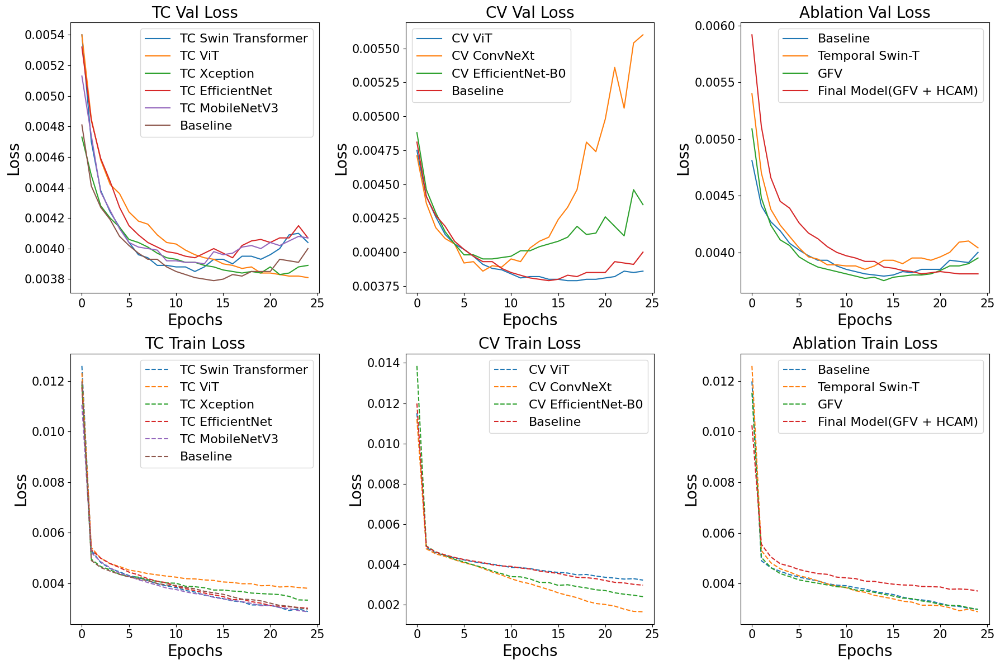

In [ ]:
import matplotlib.pyplot as plt

# 定义模型名称
model_names = [
    ['TC Swin Transformer', 'TC ViT', 'TC Xception', 'TC EfficientNet', 'TC MobileNetV3', 'Baseline'],
    ['CV ViT', 'CV ConvNeXt', 'CV EfficientNet-B0', 'Baseline'],
    ['Baseline', 'Temporal Swin-T', 'GFV', 'Final Model(GFV + HCAM)']
]

# 模型名称扩展以覆盖所有六个数据集
extended_model_names = [
    model_names[0],  # 对应 TC Val Loss
    model_names[1],  # 对应 CV Val Loss
    model_names[2],  # 对应 Ablation Val Loss
    model_names[0],  # 对应 TC Train Loss
    model_names[1],  # 对应 CV Train Loss
    model_names[2]   # 对应 Ablation Train Loss
]

fig, axs = plt.subplots(2, 3, figsize=(18, 12))  # 2行3列

# 扁平化axs以便于遍历
axs = axs.flatten()

# 所有数据集的列表
all_data = [TC_val_loss, CV_val_loss, ablation_val_loss, TC_train_loss, CV_train_loss, ablation_train_loss]
titles = ["TC Val Loss", "CV Val Loss", "Ablation Val Loss", "TC Train Loss", "CV Train Loss", "Ablation Train Loss"]

# 定义线型，训练数据使用虚线，验证数据使用实线
linestyles = ['-', '-', '-', '--', '--', '--']

# 绘制每个数据集的子list
for i, data in enumerate(all_data):
    for j, sub_list in enumerate(data):
        label = extended_model_names[i][j]
        axs[i].plot(sub_list, linestyle=linestyles[i], label=label)
    axs[i].set_title(titles[i], fontsize=20)
    axs[i].legend(fontsize=16)
    axs[i].set_xlabel('Epochs', fontsize=20)
    axs[i].set_ylabel('Loss', fontsize=20)
    axs[i].tick_params(axis='both', which='major', labelsize=15)

# 调整布局
plt.tight_layout()
plt.show()



# Data visualizations

## Graph Degree

In [ ]:
# 从pickle文件加载图
import pickle
with open("my_graph.pkl", "rb") as f:
    G = pickle.load(f)

# 打印图的信息
print("节点数:", G.number_of_nodes())
print("边数:", G.number_of_edges())
print("节点列表:", list(G.nodes))

节点数: 93703
边数: 6580439
节点列表: [212, 222, 243, 324, 333, 391, 410, 489, 590, 607, 662, 664, 729, 744, 769, 772, 779, 841, 863, 878, 970, 980, 1004, 1129, 1149, 1186, 1191, 1218, 1264, 1386, 1393, 1573, 1650, 1682, 1741, 1789, 1873, 1886, 1910, 1972, 1981, 2015, 2018, 2037, 2041, 2092, 2106, 2163, 2231, 2272, 2334, 2384, 2436, 2439, 2472, 2482, 2582, 2599, 2627, 2641, 2673, 2705, 2734, 2808, 2830, 2844, 2900, 2966, 3014, 3078, 3097, 3129, 3145, 3163, 3251, 3260, 3367, 3394, 3441, 3445, 3476, 3547, 3740, 3782, 3803, 3919, 3930, 3962, 4006, 4016, 4061, 4210, 4211, 4231, 4242, 4308, 4399, 4414, 4437, 4469, 4480, 4486, 4517, 4544, 4663, 4803, 4846, 4858, 4896, 4898, 4962, 4970, 4983, 5041, 5128, 5165, 5188, 5200, 5228, 5238, 5244, 5268, 5310, 5316, 5338, 5402, 5459, 5462, 5606, 5666, 5705, 5719, 5844, 5862, 5986, 5987, 6051, 6166, 6296, 6351, 6412, 6602, 6621, 6632, 6660, 6680, 6811, 6833, 6841, 6876, 6934, 6974, 7135, 7137, 7219, 7270, 7271, 7394, 7407, 7421, 7508, 7553, 7569, 7724, 7770, 79

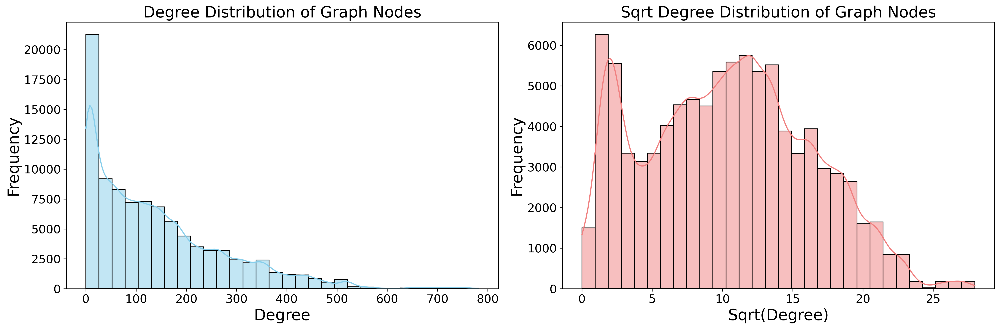

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import math
plt.rcParams['figure.dpi'] = 300
# 假设你的图数据已经加载为Graph对象
# G = nx.read_edgelist('path_to_your_graph_data')  # 示例代码，替换为实际加载方式

# 计算每个节点的度
degrees = [degree for node, degree in G.degree()]

# 创建一个子图布局
fig, axs = plt.subplots(1, 2, figsize=(18, 6))

# 绘制原始度分布直方图
sns.histplot(degrees, bins=30, kde=True, ax=axs[0], color='skyblue', edgecolor='k')
axs[0].set_xlabel('Degree',fontsize=20)
axs[0].set_ylabel('Frequency',fontsize=20)
axs[0].tick_params(axis='x', labelsize=15)  # Set x-axis tick label size
axs[0].tick_params(axis='y', labelsize=15)  # Set y-axis tick label size
axs[0].set_title('Degree Distribution of Graph Nodes',fontsize=20)

# 计算平方根后的度分布
sqrt_degrees = [math.sqrt(degree) for degree in degrees]

# 绘制平方根后的度分布直方图
sns.histplot(sqrt_degrees, bins=30, kde=True, ax=axs[1], color='lightcoral', edgecolor='k')
axs[1].set_xlabel('Sqrt(Degree)',fontsize=20)
axs[1].set_ylabel('Frequency',fontsize=20)
axs[1].tick_params(axis='x', labelsize=15)  # Set x-axis tick label size
axs[1].tick_params(axis='y', labelsize=15)  # Set y-axis tick label size
axs[1].set_title('Sqrt Degree Distribution of Graph Nodes',fontsize=20)

# 调整布局
plt.tight_layout()
plt.show()


## Map

In [ ]:
!pip install basemap
!pip install contextily


<ipython-input-54-36a16d848627>:61: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


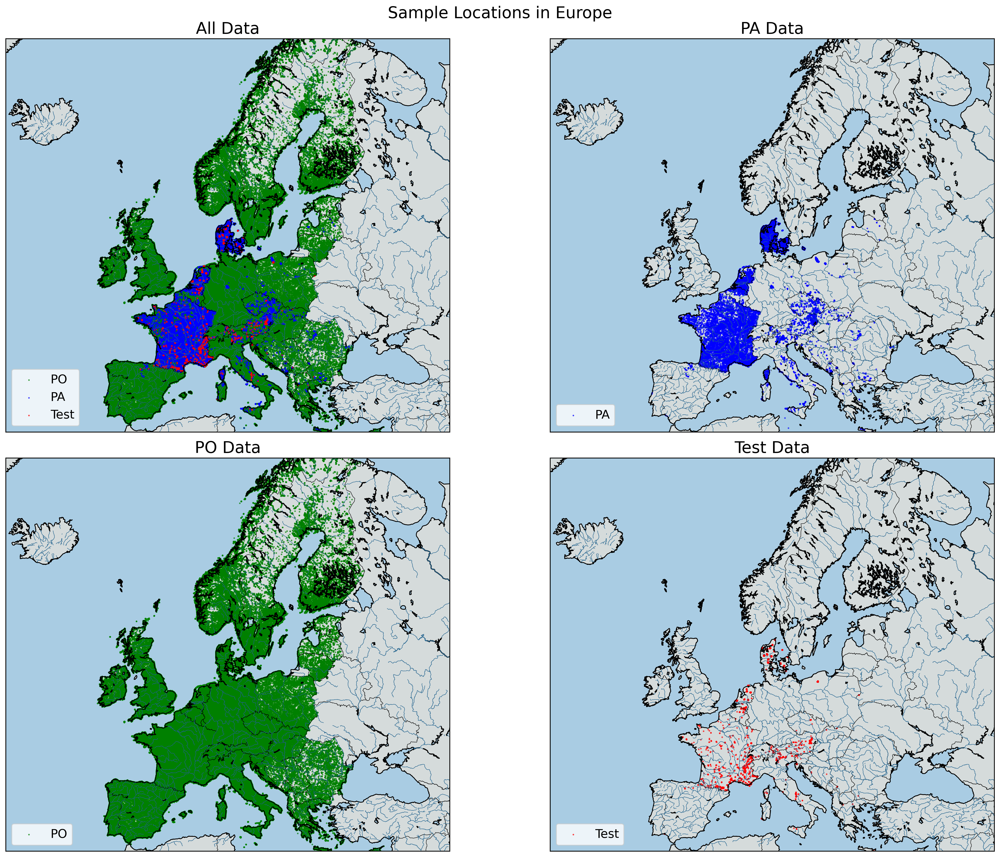

In [ ]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
from mpl_toolkits.basemap import Basemap
plt.rcParams['figure.dpi'] = 300
# 假设你的数据表已经加载为DataFrame对象
PA = pd.read_csv('train_data.csv')
PO = pd.read_csv('train_data_P0.csv')
test = pd.read_csv('test_tab.csv')

# 将数据表转换为GeoDataFrame
gdf_PA = gpd.GeoDataFrame(PA, geometry=gpd.points_from_xy(PA.lon, PA.lat))
gdf_PO = gpd.GeoDataFrame(PO, geometry=gpd.points_from_xy(PO.lon, PO.lat))
gdf_test = gpd.GeoDataFrame(test, geometry=gpd.points_from_xy(test.lon, test.lat))

# 创建绘图对象
fig, axs = plt.subplots(2, 2, figsize=(20, 15))

# 设置地图范围为欧洲，并设置背景颜色
def draw_map(ax):
    m = Basemap(projection='merc', llcrnrlat=35, urcrnrlat=70, llcrnrlon=-25, urcrnrlon=45, lat_ts=20, resolution='i', ax=ax)
    m.drawcoastlines(color='black')
    m.drawcountries(color='black')
    m.drawmapboundary(fill_color='#A9CCE3')
    m.fillcontinents(color='#D5DBDB', lake_color='#A9CCE3')
    m.drawrivers(color='#1F618D')
    return m

# 绘制所有数据的散点图
ax = axs[0, 0]
m = draw_map(ax)
m.scatter(gdf_PO.geometry.x, gdf_PO.geometry.y, latlon=True, s=1, color='green', label='PO', alpha=0.6)
m.scatter(gdf_PA.geometry.x, gdf_PA.geometry.y, latlon=True, s=1, color='blue', label='PA', alpha=0.6)
m.scatter(gdf_test.geometry.x, gdf_test.geometry.y, latlon=True, s=1, color='red', label='Test', alpha=0.6)
ax.set_title('All Data',fontsize=20)
ax.legend(fontsize=15)

# 绘制PA数据的散点图
ax = axs[0, 1]
m = draw_map(ax)
m.scatter(gdf_PA.geometry.x, gdf_PA.geometry.y, latlon=True, s=1, color='blue', label='PA', alpha=0.6)
ax.set_title('PA Data',fontsize=20)
ax.legend(fontsize=15)

# 绘制PO数据的散点图
ax = axs[1, 0]
m = draw_map(ax)
m.scatter(gdf_PO.geometry.x, gdf_PO.geometry.y, latlon=True, s=1, color='green', label='PO', alpha=0.6)
ax.set_title('PO Data',fontsize=20)
ax.legend(fontsize=15)

# 绘制test数据的散点图
ax = axs[1, 1]
m = draw_map(ax)
m.scatter(gdf_test.geometry.x, gdf_test.geometry.y, latlon=True, s=1, color='red', label='Test', alpha=0.6)
ax.set_title('Test Data',fontsize=20)
ax.legend(fontsize=15)

# 添加标题和标签
fig.suptitle('Sample Locations in Europe', fontsize=20)
plt.tight_layout()
plt.show()



## Distribution

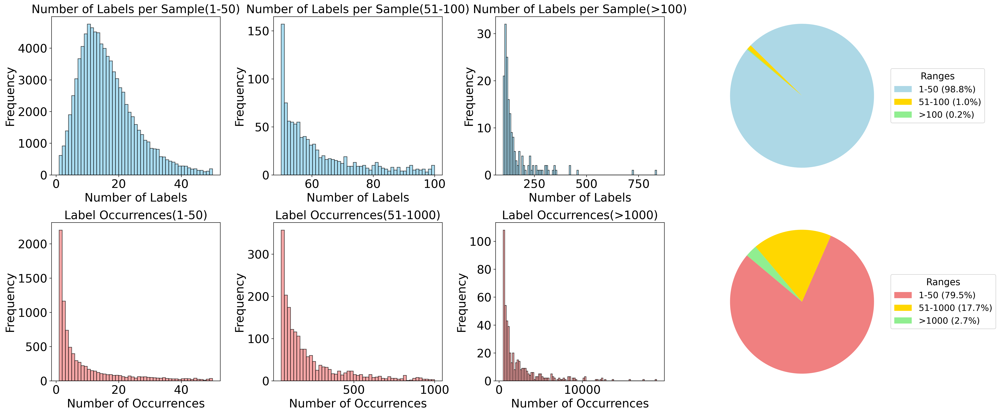

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from collections import Counter
import numpy as np
plt.rcParams['figure.dpi'] = 300
# 读取上传的文件
data = pd.read_csv('train_data.csv')

# 假设标签列为 'speciesIds'
# 计算每个样本的标签数量
data['num_labels'] = data['speciesIds'].apply(lambda x: len(x.split(',')))

# 统计每个标签的出现次数
label_counts = Counter(label for speciesIds in data['speciesIds'] for label in speciesIds.split(','))

# 分离标签数量数据和标签出现次数数据
num_labels_data = data['num_labels']
label_occurrences_data = list(label_counts.values())

# 过滤数据以获取大于100和大于500的值
num_labels_data_gt_100 = num_labels_data[num_labels_data > 100]
label_occurrences_data_gt_500 = [count for count in label_occurrences_data if count > 500]

# 定义一个绘图函数
def plot_distribution(data, title, xlabel, ylabel, bins, ax, color):
    ax.hist(data, bins=bins, edgecolor='k', alpha=0.7, color=color)
    ax.set_xlabel(xlabel, fontsize=20)
    ax.set_ylabel(ylabel, fontsize=20)
    ax.set_title(title, fontsize=20)
    ax.tick_params(axis='both', which='major', labelsize=20)

# 创建八个子图（六个柱状图和两个饼图）
fig, axs = plt.subplots(2, 4, figsize=(24, 10))

# 每个样本的标签数量分布图（拆分成三张图）
plot_distribution(num_labels_data, 'Number of Labels per Sample(1-50)',
                  'Number of Labels', 'Frequency', bins=np.linspace(1, 50, 50),
                  ax=axs[0, 0], color='skyblue')
plot_distribution(num_labels_data, 'Number of Labels per Sample(51-100)',
                  'Number of Labels', 'Frequency', bins=np.linspace(50, 100, 50),
                  ax=axs[0, 1], color='skyblue')
plot_distribution(num_labels_data_gt_100, 'Number of Labels per Sample(>100)',
                  'Number of Labels', 'Frequency', bins=100,
                  ax=axs[0, 2], color='skyblue')

# 每个标签的出现次数分布图（拆分成三张图）
plot_distribution(label_occurrences_data, 'Label Occurrences(1-50)',
                  'Number of Occurrences', 'Frequency', bins=np.linspace(1, 50, 50),
                  ax=axs[1, 0], color='lightcoral')
plot_distribution(label_occurrences_data, 'Label Occurrences(51-1000)',
                  'Number of Occurrences', 'Frequency', bins=np.linspace(50, 1000, 50),
                  ax=axs[1, 1], color='lightcoral')
plot_distribution(label_occurrences_data_gt_500, 'Label Occurrences(>1000)',
                  'Number of Occurrences', 'Frequency', bins=100,
                  ax=axs[1, 2], color='lightcoral')

# 饼图数据
def plot_pie_chart(ax, sizes, labels, colors):
    wedges, texts = ax.pie(sizes, colors=colors, startangle=140, pctdistance=0.85)
    ax.axis('equal')
    legend_labels = [f'{label} ({size:.1f}%)' for label, size in zip(labels, sizes)]
    ax.legend(wedges, legend_labels, title="Ranges", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1), fontsize=15, title_fontsize=16)

# 计算每个区间的比例（样本标签数量）
samples_range_1_50 = sum(1 for count in num_labels_data if 1 <= count <= 50)
samples_range_51_100 = sum(1 for count in num_labels_data if 51 <= count <= 100)
samples_range_gt_100 = sum(1 for count in num_labels_data if count > 100)
total_samples_count = samples_range_1_50 + samples_range_51_100 + samples_range_gt_100

sizes_samples = [samples_range_1_50 / total_samples_count * 100,
                 samples_range_51_100 / total_samples_count * 100,
                 samples_range_gt_100 / total_samples_count * 100]
labels_samples = ['1-50', '51-100', '>100']
colors_samples = ['lightblue','gold', 'lightgreen']

# 计算每个区间的比例（标签出现次数）
labels_range_1_50 = sum(1 for count in label_occurrences_data if 1 <= count <= 50)
labels_range_51_500 = sum(1 for count in label_occurrences_data if 51 <= count <= 1000)
labels_range_gt_500 = sum(1 for count in label_occurrences_data if count > 1000)
total_labels_count = labels_range_1_50 + labels_range_51_500 + labels_range_gt_500

sizes_labels = [labels_range_1_50 / total_labels_count * 100,
                labels_range_51_500 / total_labels_count * 100,
                labels_range_gt_500 / total_labels_count * 100]
labels_labels = ['1-50', '51-1000', '>1000']
colors_labels = ['lightcoral', 'gold', 'lightgreen']

# 绘制饼图
plot_pie_chart(axs[0, 3], sizes_samples, labels_samples, colors_samples)
plot_pie_chart(axs[1, 3], sizes_labels, labels_labels, colors_labels)

# 调整布局
plt.tight_layout()
plt.show()




## Tabular Data Analysis

In [ ]:
def replace_greater_than_255(x):
    return np.nan if x > 255 else x
def replace_less_than_0(x):
    return np.nan if x < 0 else x
train_landcover = pd.read_csv("/kaggle/input/geolifeclef-2024/EnvironmentalRasters/EnvironmentalRasters/LandCover/GLC24-PA-train-landcover.csv")
train_solidgrids = pd.read_csv("/kaggle/input/geolifeclef-2024/EnvironmentalRasters/EnvironmentalRasters/SoilGrids/GLC24-PA-train-soilgrids.csv")
df= pd.read_csv("/kaggle/input/geolifeclef-2024/EnvironmentalRasters/EnvironmentalRasters/Human Footprint/GLC24-PA-train-human_footprint.csv")
exclude_column = 'surveyId'
df.loc[:, df.columns != exclude_column] = df.loc[:, df.columns != exclude_column].applymap(replace_greater_than_255)
df.loc[:, df.columns != exclude_column] = df.loc[:, df.columns != exclude_column].applymap(replace_less_than_0)
train_humanfootprint=df
train_elevation = pd.read_csv("/kaggle/input/geolifeclef-2024/EnvironmentalRasters/EnvironmentalRasters/Elevation/GLC24-PA-train-elevation.csv")
train_climate = pd.read_csv("/kaggle/input/geolifeclef-2024/EnvironmentalRasters/EnvironmentalRasters/Climate/Average 1981-2010/GLC24-PA-train-bioclimatic.csv")
train_metadata_path = "/kaggle/input/geolifeclef-2024/GLC24_PA_metadata_train.csv"
train_metadata = pd.read_csv(train_metadata_path)
train_feature=train_metadata.drop_duplicates(subset="surveyId").reset_index(drop=True)
train_tab = train_climate.merge(train_elevation,on="surveyId").merge(train_humanfootprint,on="surveyId").merge(train_solidgrids,on="surveyId").merge(train_landcover,on="surveyId").merge(train_feature,on="surveyId")
print(train_tab.head())
train_tab = train_tab.applymap(lambda x: np.nan if x == np.inf or x == -np.inf or x == -1 else x)
train_tab.to_csv("train_table.csv",index=False)

###









   surveyId  Bio1  Bio2  Bio3  Bio4  Bio5  Bio6  Bio7  Bio8  Bio9  ...  \
0       212  2883    68     3  5545  3007  2780   227  2854  2958  ...   
1       222  2815    59     2  5690  2935  2720   215  2860  2768  ...   
2       243  2821    26     1  5150  2910  2741   169  2838  2832  ...   
3       324  2870    90     3  5315  2992  2756   236  2810  2938  ...   
4       333  2858    81     3  5285  2982  2758   224  2827  2927  ...   

   Soilgrid-soc  LandCover       lon        lat  year  geoUncertaintyInM  \
0         176.0        8.0  3.099038  43.134956  2021                5.0   
1         609.0       12.0  9.884560  56.912140  2017               10.0   
2         672.0        5.0  8.256020  55.637050  2019               10.0   
3         302.0       14.0 -0.402590  43.505630  2018                1.0   
4         257.0       14.0 -0.517360  45.806430  2017                1.0   

   areaInM2         region  country  speciesId  
0     100.0  MEDITERRANEAN   France     6874.0  


In [ ]:
import pandas as pd

# 读取 CSV 文件
train_table = pd.read_csv('train_table.csv')

# 检查每一列的空值
null_counts = train_table.isnull().sum()

# 输出所有列名以及数据类型
columns_info = train_table.dtypes

# 删除 surveyId 列
if 'surveyId' in train_table.columns:
    train_table = train_table.drop(columns=['surveyId'])

# 输出列名和数据类型以及空值计数
columns_summary = pd.DataFrame({
    'Column': columns_info.index,
    'Data Type': columns_info.values,
    'Null Count': null_counts.values
})

# 显示列名、数据类型和空值计数
print(columns_summary)

# 保存处理后的数据
train_table.to_csv('train_table_processed.csv', index=False)


                           Column Data Type  Null Count
0                        surveyId     int64           0
1                            Bio1     int64           0
2                            Bio2     int64           0
3                            Bio3     int64           0
4                            Bio4     int64           0
5                            Bio5     int64           0
6                            Bio6     int64           0
7                            Bio7     int64           0
8                            Bio8     int64           0
9                            Bio9     int64           0
10                          Bio10     int64           0
11                          Bio11     int64           0
12                          Bio12     int64           0
13                          Bio13     int64           0
14                          Bio14     int64           0
15                          Bio15     int64           0
16                          Bio16     int64     

In [ ]:
# 绘制空值计数柱状图
import matplotlib.pyplot as plt
plt.figure(figsize=(12, 8))
plt.bar(columns_summary['Column'], columns_summary['Null Count'], color='skyblue')
plt.xlabel('Columns')
plt.ylabel('Null Count')
plt.title('Null Count in Each Column')
plt.xticks(rotation=90)
plt.show()

In [ ]:
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer

# 加载CSV文件
file_path = 'train_table.csv'  # 请根据需要修改文件路径
data = pd.read_csv(file_path)

# 定义不需要填补和标准化的列
exclude_columns = ['region', 'country', 'surveyId']

# 分离需要填补和标准化的列和不需要处理的列
columns_to_process = [col for col in data.columns if col not in exclude_columns]
data_to_process = data[columns_to_process]
data_not_to_process = data[exclude_columns]

# 用均值填补空值
imputer = SimpleImputer(strategy='mean')
data_filled = imputer.fit_transform(data_to_process)

# 标准化
scaler = StandardScaler()
data_standardized = scaler.fit_transform(data_filled)

# 将填补和标准化后的数据转换为DataFrame
data_standardized = pd.DataFrame(data_standardized, columns=columns_to_process)

# 合并不需要处理的列和处理后的列
data_final = pd.concat([data_not_to_process.reset_index(drop=True), data_standardized], axis=1)

# 保存修改后的DataFrame到新的CSV文件
modified_file_path = 'train_table_processed.csv'  # 请根据需要修改文件路径
data_final.to_csv(modified_file_path, index=False)

# 输出处理后的DataFrame
print(data_final)

null_counts_after_imputation = data_final.isnull().sum()
print(null_counts_after_imputation)

              region  country  surveyId      Bio1      Bio2      Bio3  \
0      MEDITERRANEAN   France       212  2.619619  0.553603  1.254486   
1        CONTINENTAL  Denmark       222 -0.520035  0.059600 -0.253802   
2           ATLANTIC  Denmark       243 -0.243007 -1.751741 -1.762091   
3           ATLANTIC   France       324  2.019391  1.761164  1.254486   
4           ATLANTIC   France       333  1.465334  1.267161  1.254486   
...              ...      ...       ...       ...       ...       ...   
88982    CONTINENTAL  Denmark   3919553 -0.427693 -1.532184 -1.762091   
88983    CONTINENTAL  Denmark   3919592 -0.658550 -2.135965 -1.762091   
88984       ATLANTIC  Denmark   3919620 -0.520035  0.059600 -0.253802   
88985    CONTINENTAL   Poland   3919640 -0.843235  0.443824 -0.253802   
88986    CONTINENTAL  Denmark   3919655 -0.658550 -0.050178 -0.253802   

           Bio4      Bio5      Bio6      Bio7  ...  Soilgrid-sand  \
0     -0.172594  2.464918  1.978999  0.486982  ...    

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# 假设data_to_process是您的DataFrame
# data_to_process = pd.read_csv('your_data.csv')  # 如果数据来自CSV文件

# 计算相关性矩阵
correlation_matrix = data_to_process.corr()

# 绘制热力图
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, cmap='coolwarm', linewidths=0.5)
plt.title('Feature Correlation Heatmap')
plt.show()


region                           0
country                          0
surveyId                         0
Bio1                             0
Bio2                             0
Bio3                             0
Bio4                             0
Bio5                             0
Bio6                             0
Bio7                             0
Bio8                             0
Bio9                             0
Bio10                            0
Bio11                            0
Bio12                            0
Bio13                            0
Bio14                            0
Bio15                            0
Bio16                            0
Bio17                            0
Bio18                            0
Bio19                            0
Elevation                        0
HumanFootprint-Built1994         0
HumanFootprint-Built2009         0
HumanFootprint-croplands1992     0
HumanFootprint-croplands2005     0
HumanFootprint-Lights1994        0
HumanFootprint-Light

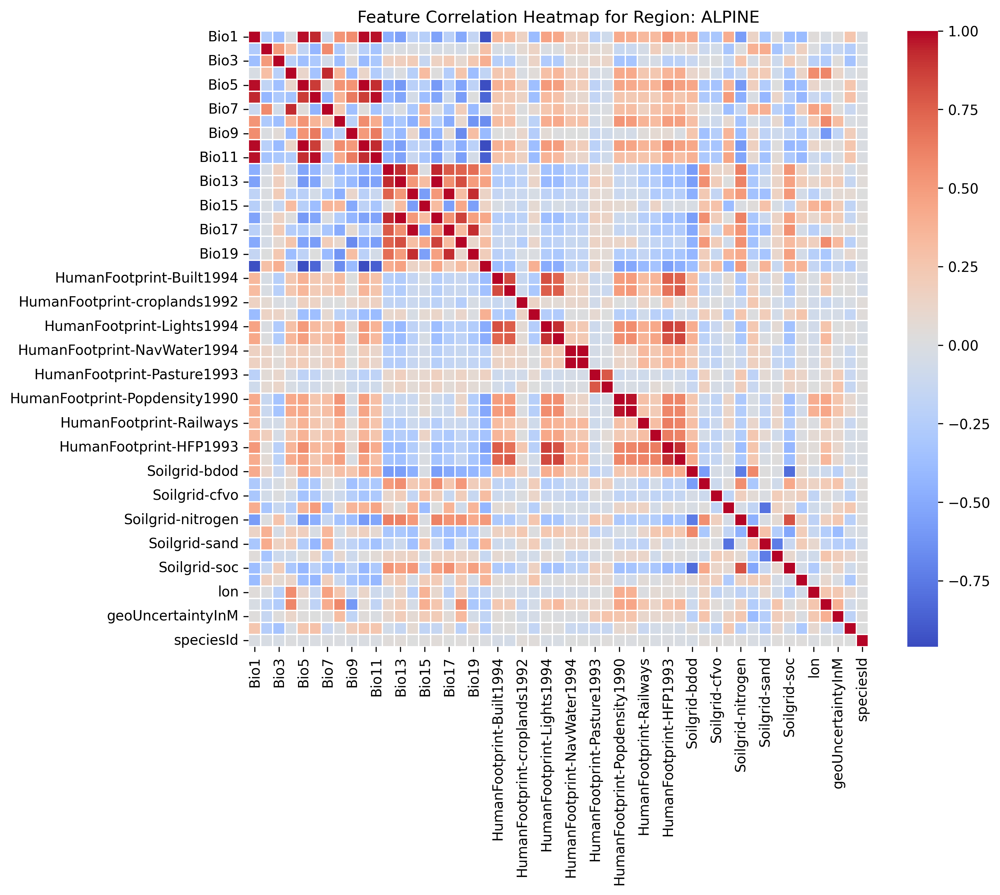

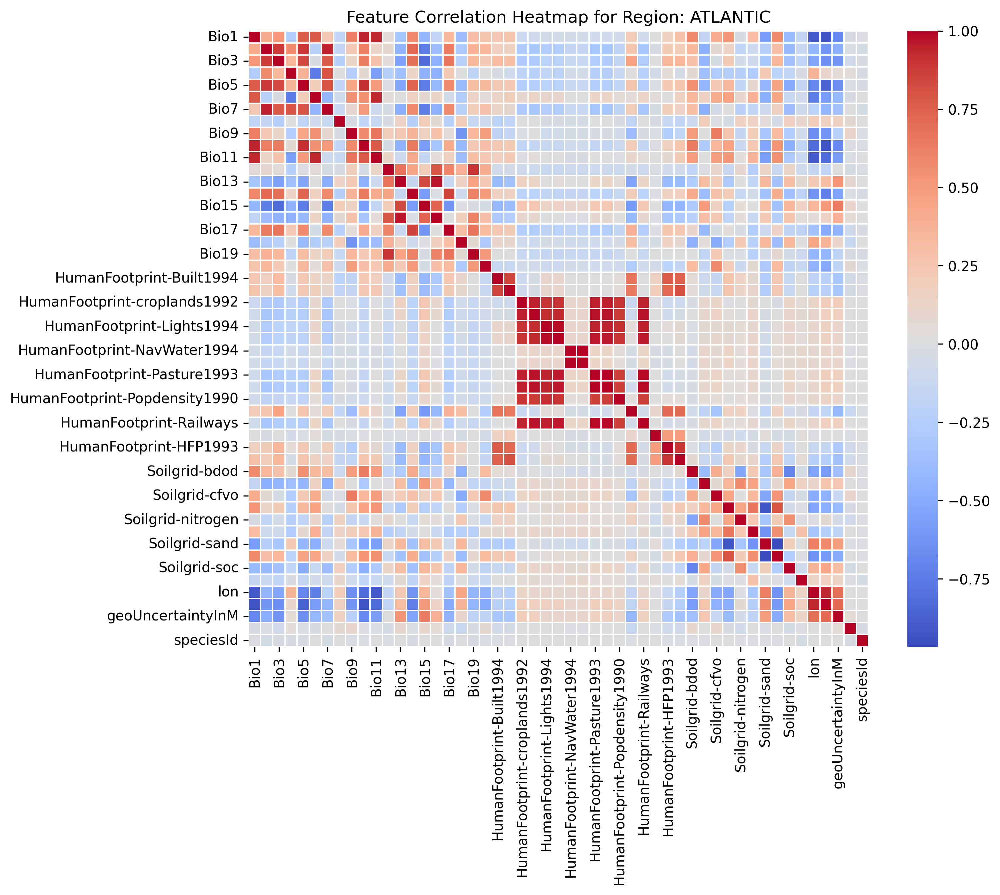

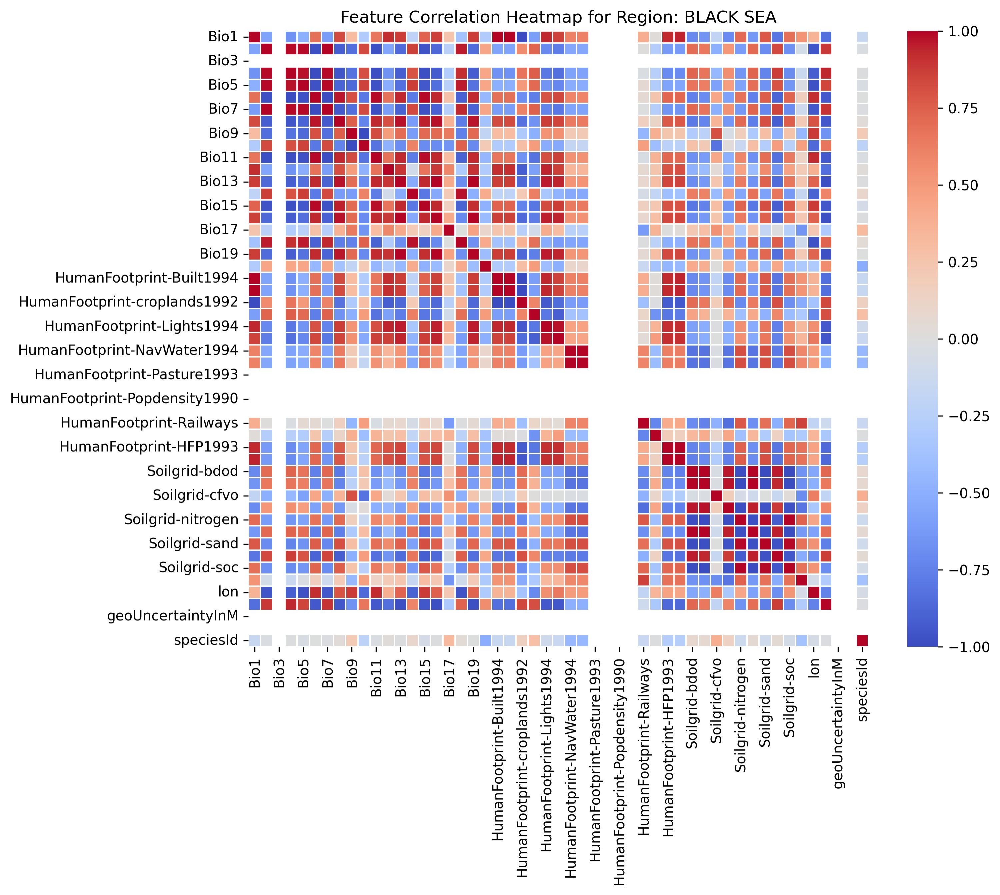

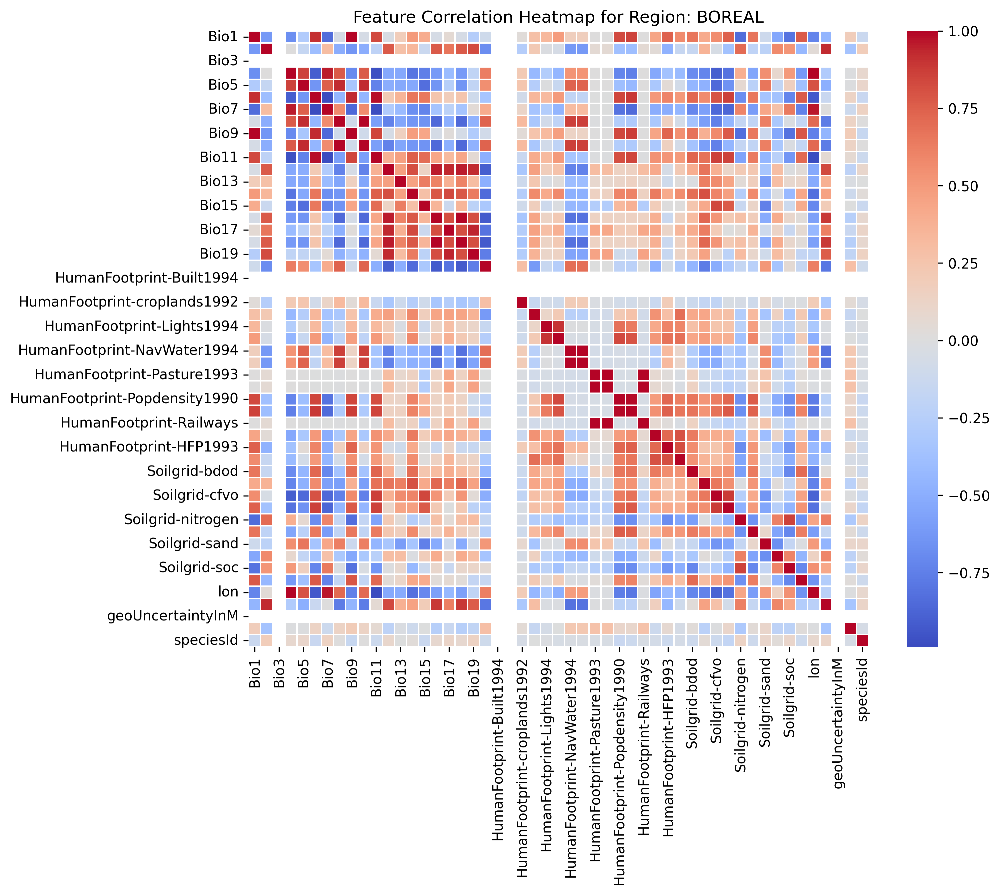

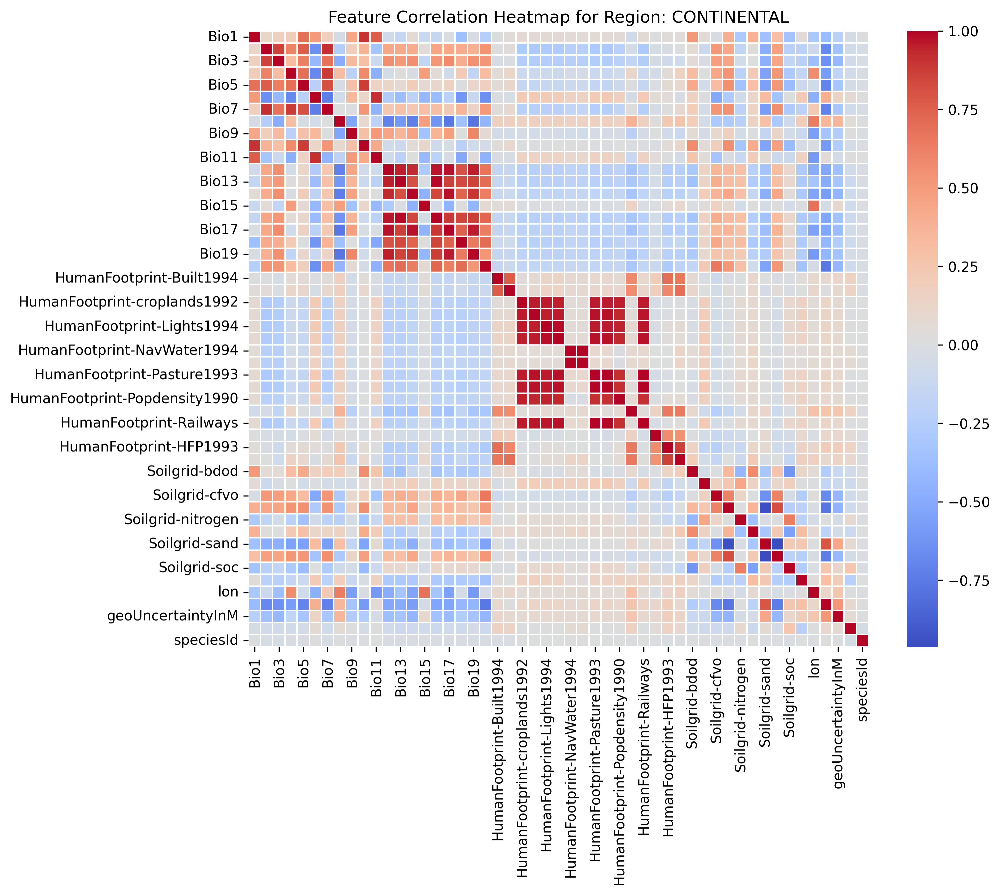

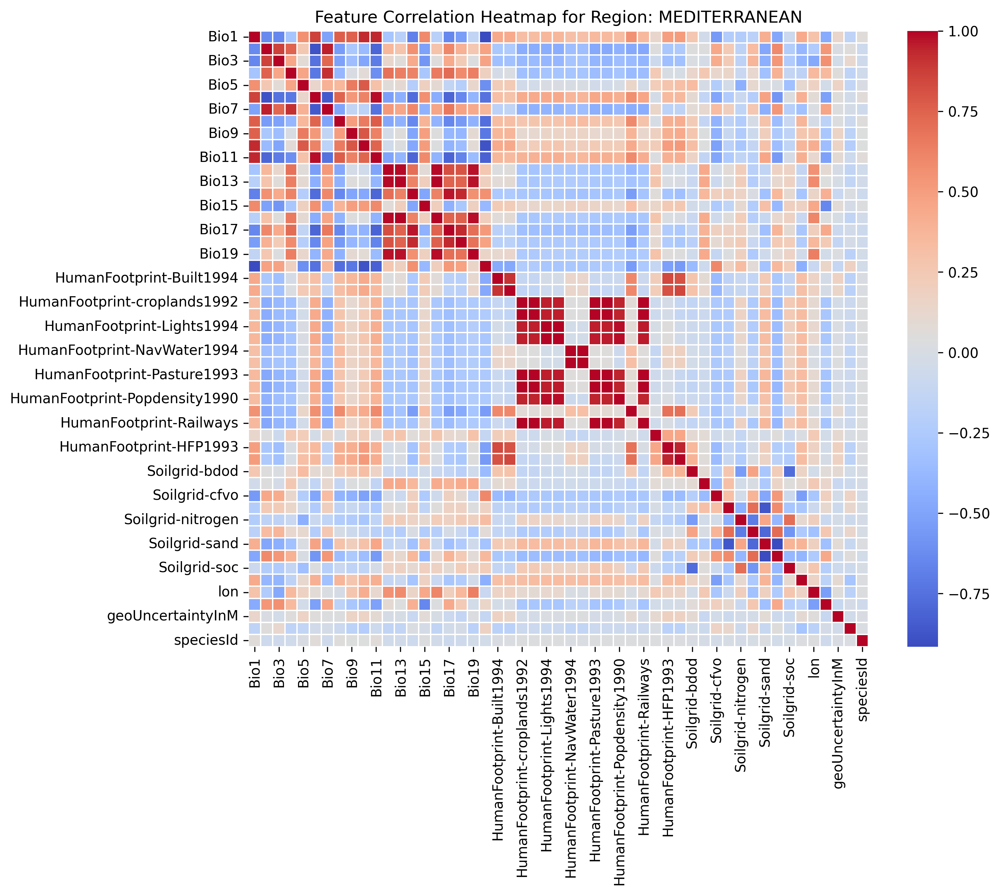

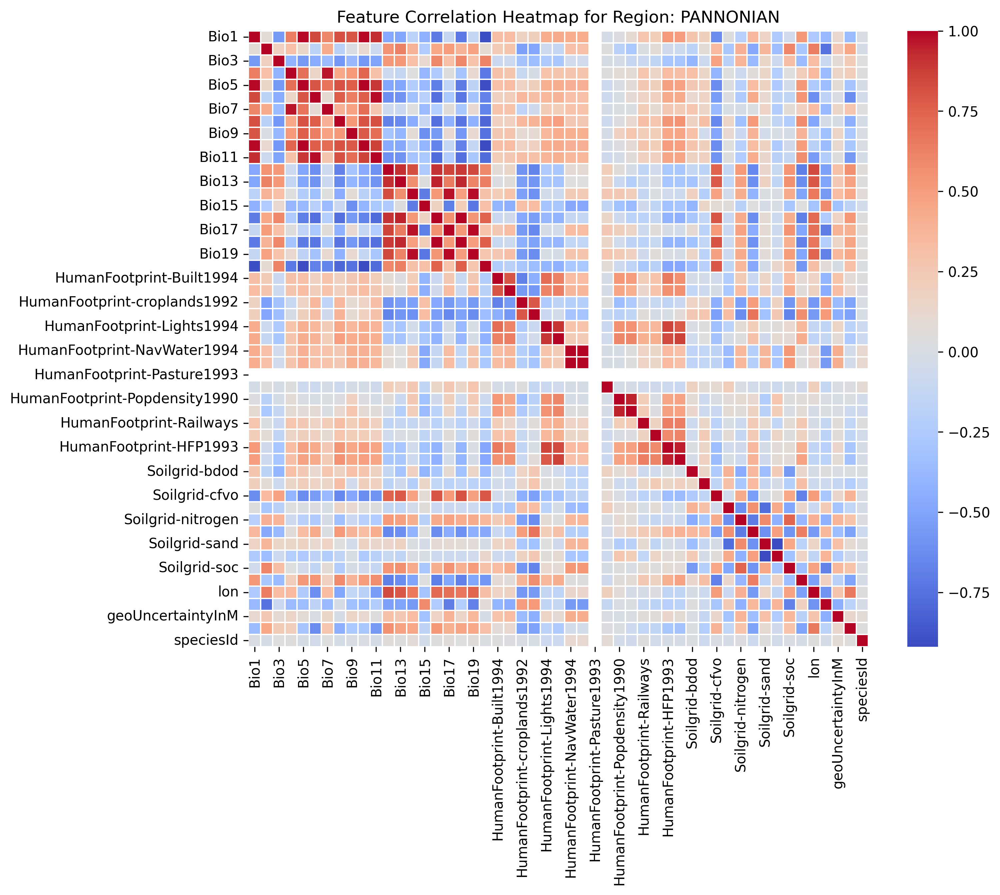

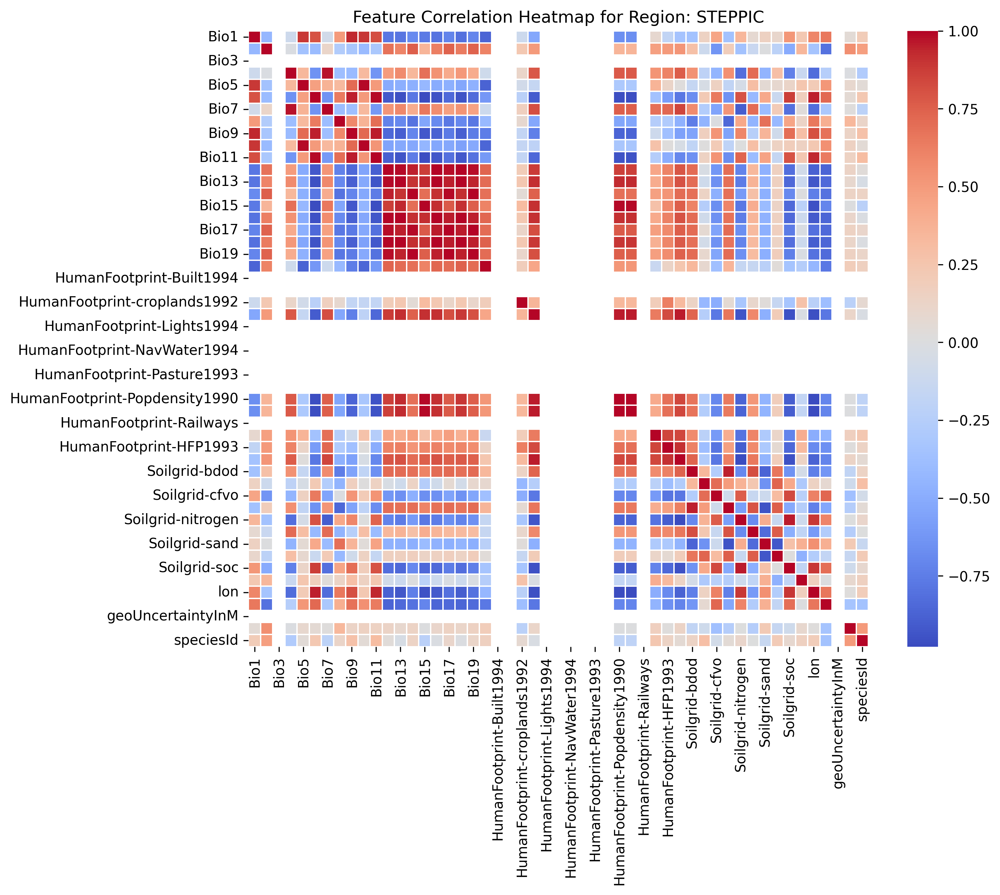

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
null_counts_after_imputation = data_final.isnull().sum()
print(null_counts_after_imputation)
# 假设data_to_process是您的DataFrame
# data_to_process = pd.read_csv('your_data.csv')  # 如果数据来自CSV文件
data_final=pd.read_csv("train_table_processed.csv")
# 去除year和surveyId列
data_filtered = data_final.drop(columns=['year', 'surveyId',"country"])

# 按region进行groupby
grouped = data_filtered.groupby('region')


# 绘制热力图
# 遍历每个分组并绘制热力图
for region, group in grouped:
    # 计算相关性矩阵
    group = group.drop(columns=['region'])
    correlation_matrix = group.corr()

    # 绘制热力图
    plt.figure(figsize=(10, 8))
    sns.heatmap(correlation_matrix, cmap='coolwarm', linewidths=0.5)
    plt.title(f'Feature Correlation Heatmap for Region: {region}')
    plt.show()


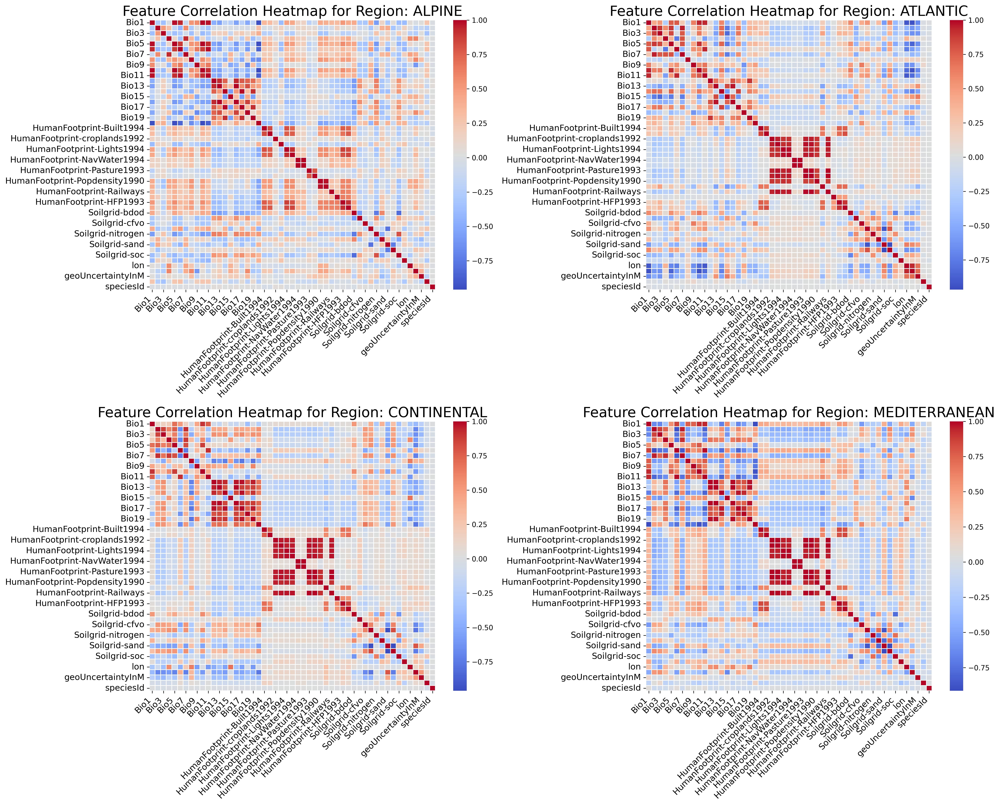

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
plt.rcParams['figure.dpi'] = 300
# 假设data_to_process是您的DataFrame
# data_to_process = pd.read_csv('your_data.csv')  # 如果数据来自CSV文件

# 去除year和surveyId列
data_filtered = data_final.drop(columns=['year', 'surveyId',"country"])

# 只保留需要的regions
filtered_regions = data_filtered[data_filtered['region'].isin(['MEDITERRANEAN', 'CONTINENTAL', 'ATLANTIC', 'ALPINE'])]

# 按region进行groupby
grouped = filtered_regions.groupby('region')

# 设置画布大小和子图布局
fig, axes = plt.subplots(2, 2, figsize=(20, 16))
axes = axes.flatten()  # 将axes数组展平，便于遍历

# 遍历每个分组并绘制热力图
for i, (region, group) in enumerate(grouped):
    # 计算相关性矩阵
    group = group.drop(columns=['region'])
    correlation_matrix = group.corr()

    # 绘制热力图
    sns.heatmap(correlation_matrix, cmap='coolwarm', linewidths=0.5, ax=axes[i])
    axes[i].set_title(f'Feature Correlation Heatmap for Region: {region}', fontsize=20)
    # 设置标签倾斜
    axes[i].set_xticklabels(axes[i].get_xticklabels(), rotation=45, horizontalalignment='right', fontsize=12)
    axes[i].set_yticklabels(axes[i].get_yticklabels(), fontsize=12, horizontalalignment='right')

# 隐藏多余的子图
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


<ipython-input-69-6a552d628ad2>:30: UserWarning: FixedFormatter should only be used together with FixedLocator
  axes[i].set_xticklabels(axes[i].get_xticklabels(), rotation=45, horizontalalignment='right',fontsize=12)
<ipython-input-69-6a552d628ad2>:31: UserWarning: FixedFormatter should only be used together with FixedLocator
  axes[i].set_yticklabels(axes[i].get_yticklabels(), fontsize=18, horizontalalignment='right')
<ipython-input-69-6a552d628ad2>:30: UserWarning: FixedFormatter should only be used together with FixedLocator
  axes[i].set_xticklabels(axes[i].get_xticklabels(), rotation=45, horizontalalignment='right',fontsize=12)
<ipython-input-69-6a552d628ad2>:31: UserWarning: FixedFormatter should only be used together with FixedLocator
  axes[i].set_yticklabels(axes[i].get_yticklabels(), fontsize=18, horizontalalignment='right')
<ipython-input-69-6a552d628ad2>:30: UserWarning: FixedFormatter should only be used together with FixedLocator
  axes[i].set_xticklabels(axes[i].get_xti

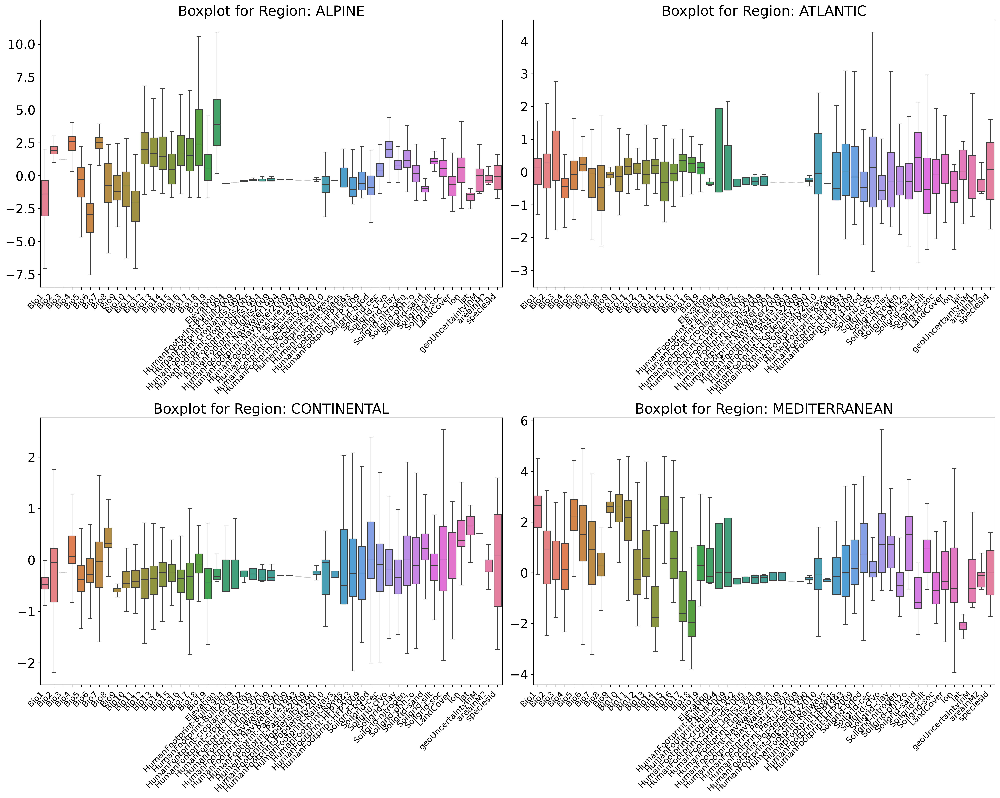

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
plt.rcParams['figure.dpi'] = 300
# 假设data_to_process是您的DataFrame
# data_to_process = pd.read_csv('your_data.csv')  # 如果数据来自CSV文件

# 去除year、surveyId和country列
data_filtered = data_final.drop(columns=['year', 'surveyId', 'country'])

# 只保留需要的regions
filtered_regions = data_filtered[data_filtered['region'].isin(['MEDITERRANEAN', 'CONTINENTAL', 'ATLANTIC', 'ALPINE'])]

# 按region进行groupby
grouped = filtered_regions.groupby('region')

# 设置画布大小和子图布局
fig, axes = plt.subplots(2, 2, figsize=(20, 16))
axes = axes.flatten()  # 将axes数组展平，便于遍历

# 遍历每个分组并绘制箱型图
for i, (region, group) in enumerate(grouped):
    # 移除region列以绘制其他特征的箱型图
    group = group.drop(columns=['region'])

    # 绘制箱型图
    sns.boxplot(data=group, ax=axes[i], showfliers=False)
    axes[i].set_title(f'Boxplot for Region: {region}',fontsize=20)
    # 设置标签倾斜
    axes[i].set_xticklabels(axes[i].get_xticklabels(), rotation=45, horizontalalignment='right',fontsize=12)
    axes[i].set_yticklabels(axes[i].get_yticklabels(), fontsize=18, horizontalalignment='right')
# 隐藏多余的子图
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


## Time series visualizations

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
plt.rcParams['figure.dpi'] = 300
# 假设data_to_process是您的DataFrame
# data_to_process = pd.read_csv('your_data.csv')  # 如果数据来自CSV文件
data=pd.read_csv("/kaggle/input/geolifeclef-2024/EnvironmentalRasters/EnvironmentalRasters/Climate/Monthly/GLC24-PA-test-bioclimatic_monthly.csv")

# 选择前四个样本的数据
samples = data.iloc[:4]

# 提取年份和特征列名
features = ['Bio-pr', 'Bio-tas', 'Bio-tasmax', 'Bio-tasmin']
years = range(2000, 2019)
months = range(1, 13)

# 准备数据
data_to_plot_samples = {feature: [[] for _ in range(4)] for feature in features}

for i in range(4):
    for year in years:
        for month in months:
            for feature in features:
                col_name = f"{feature}_{month:02d}_{year}"
                data_to_plot_samples[feature][i].append(samples.iloc[i][col_name])

# 定义颜色列表
colors = ['#FF6347', '#FFA500', '#FFD700', '#FF69B4']

# 设置x轴标签
x_labels = [f'{month:02d}-{year}' for year in years for month in months]

# 绘制四个特征在四张图上的变化趋势
fig, axes = plt.subplots(2, 2, figsize=(18, 12))

for i, feature in enumerate(features):
    ax = axes[i // 2, i % 2]
    for j in range(4):
        ax.plot(range(len(data_to_plot_samples[feature][j])), data_to_plot_samples[feature][j], label=f'Sample {j+1}', color=colors[j])
    ax.set_title(f'Trend of {feature} over 19 Years',fontsize=20)
    ax.set_xlabel('Time (Year)',fontsize=20)
    ax.set_ylabel('Values',fontsize=20)
    ax.set_xticks(range(0, len(x_labels), 12))
    ax.set_xticklabels([f'{year}' for year in years], rotation=45,fontsize=20)
    ax.set_yticklabels(ax.get_yticks(), fontsize=20)
    ax.legend(fontsize=15)
    ax.grid(True)

plt.tight_layout()
plt.show()




In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
plt.rcParams['figure.dpi'] = 300
# 读取所有上传的CSV文件
file_paths = [
    '/kaggle/input/geolifeclef-2024/PA-test-landsat_time_series/GLC24-PA-test-landsat_time_series-blue.csv',
    '/kaggle/input/geolifeclef-2024/PA-test-landsat_time_series/GLC24-PA-test-landsat_time_series-green.csv',
    '/kaggle/input/geolifeclef-2024/PA-test-landsat_time_series/GLC24-PA-test-landsat_time_series-nir.csv',
    '/kaggle/input/geolifeclef-2024/PA-test-landsat_time_series/GLC24-PA-test-landsat_time_series-red.csv',
    '/kaggle/input/geolifeclef-2024/PA-test-landsat_time_series/GLC24-PA-test-landsat_time_series-swir1.csv',
    '/kaggle/input/geolifeclef-2024/PA-test-landsat_time_series/GLC24-PA-test-landsat_time_series-swir2.csv'
]

# 读取每个CSV文件
data_frames = [pd.read_csv(file_path) for file_path in file_paths]

# 提取前四个节点的时间趋势数据
nodes_data = [df.iloc[:4] for df in data_frames]

# 定义颜色和标签
colors_updated = ['#0000FF', '#008000', '#FFD700', '#FF0000', '#FF69B4', '#FFB6C1']  # Blue, Green, Gold, Red, HotPink, LightPink
labels = ['Blue', 'Green', 'NIR', 'Red', 'SWIR1', 'SWIR2']

# 创建子图
fig, axes = plt.subplots(2, 2, figsize=(18, 12))
axes = axes.flatten()

# 提取节点标签
node_labels = [f'Node {i+1}' for i in range(4)]

# 绘制四个节点在四张图上的时间趋势
for i in range(4):
    for data, label, color in zip(nodes_data, labels, colors_updated):
        axes[i].plot(data.columns[1:], data.iloc[i, 1:], label=label, color=color)  # 跳过第一列（假设是ID列）
    axes[i].set_title(f'Time Series for {node_labels[i]} Across All Bands',fontsize=20)
    axes[i].set_xlabel('Time',fontsize=20)
    axes[i].set_ylabel('Values',fontsize=20)
    axes[i].legend(fontsize=15)
    axes[i].grid(True)
    axes[i].set_xticks(range(0, len(data.columns[1:]), 12))
    axes[i].set_xticklabels([data.columns[i] for i in range(1, len(data.columns), 12)], rotation=45,fontsize=15)
    axes[i].set_yticklabels(axes[i].get_yticks(), fontsize=15)

# 调整子图布局
plt.tight_layout()
plt.show()

